# Inferencia causal con datos observacionales y el enfoque Bayesiano paramétrico y no paramétrico.
## Una aplicación a los efectos de la política de salarios mínimos y beneficios fiscales en el empleo informal en los municipios de la frontera norte de México.

Author: Leobardo Enríquez Hernández

Agosto, 2025

In [1]:
import arviz as az
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import seaborn as sns
import pandas as pd
import geopandas as gpd
import pymc as pm
import pymc_bart as pmb
import pytensor.tensor as pt
import statsmodels.api as sm
import xarray as xr
import warnings
warnings.filterwarnings('ignore')
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from shapely.geometry import Point

In [2]:
%config InlineBackend.figure_format = 'retina'
az.style.use("arviz-whitegrid")
rng = np.random.default_rng(3101)

## Datos

Datos de 276 municipios de los Estados de la frontera con Estados Unidos, de los cuales 43 son considerados de la Zona Libre de la Frontera Norte (ZLFN).

In [3]:
dat = pd.read_excel('dataset.xlsx')
dat.head()

,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome
0,2001,Baja California Ensenada,2,1,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021,increment moderate,decrement strong,1,-6.487502
1,2002,Baja California Mexicali,2,1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771,increment low,decrement low,1,-1.715072
2,2003,Baja California Tecate,2,1,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477,increment moderate,decrement moderate,1,-5.408627
3,2004,Baja California Tijuana,2,1,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466,increment low,decrement low,1,-0.402502
4,2005,Baja California Playas de Rosarito,2,1,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860,increment moderate,decrement moderate,1,-14.181250


In [4]:
dummies = pd.get_dummies(dat["state"], drop_first=False, prefix="state")
selected_columns = dat[[
    "LLAVE",
    "manufactur", 
    "maquila", 
    "multi_poverty", 
    "urban",
    "informal", 
    "imssissste", 
    "health", 
    "lpopulation", 
    "imssissste_incr",
    "pea_incr",
    "trt",
    "outcome"
]]
data = pd.concat([dummies, selected_columns], axis=1)
data.head()

,state_2,state_5,state_8,state_19,state_26,state_28,LLAVE,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,trt,outcome
0,1,0,0,0,0,0,2001,1,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021,1,-6.487502
1,1,0,0,0,0,0,2002,1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771,1,-1.715072
2,1,0,0,0,0,0,2003,1,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477,1,-5.408627
3,1,0,0,0,0,0,2004,1,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466,1,-0.402502
4,1,0,0,0,0,0,2005,1,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860,1,-14.181250


In [5]:
treatment = 'trt' 
outcome = 'outcome'
covariates = [
    'state_2','state_5','state_8','state_19',"state_26","state_28",# State dummies
    "manufactur", 
    "maquila", 
    "multi_poverty", 
    "urban",
    "informal", 
    "imssissste", 
    "health", 
    "lpopulation", 
    "imssissste_incr",
    "pea_incr",
    "trt",
    "outcome"
]
X = data[covariates]
T = data[treatment]
Y = data[outcome]

## Distribuciones y diferencias brutas (no ajustados) entre tratados y no tratados

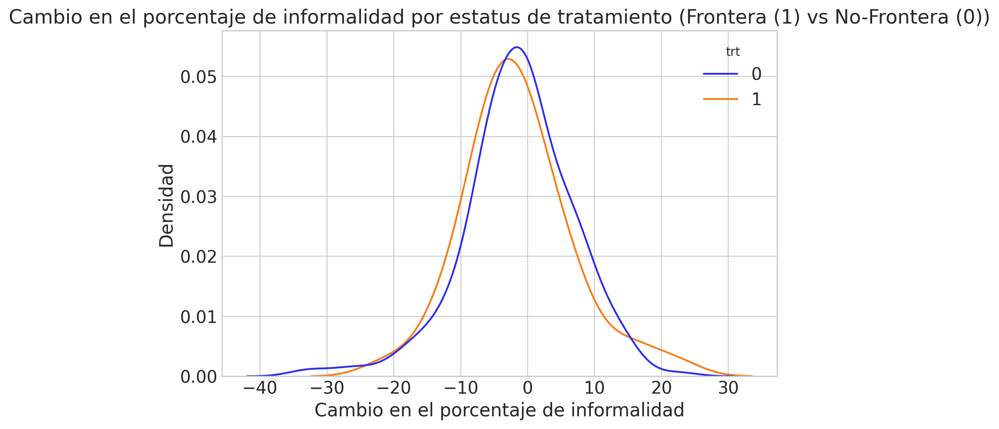

In [6]:
sns.kdeplot(data=data, x=outcome, hue=treatment, common_norm=False)
plt.title('Cambio en el porcentaje de informalidad por estatus de tratamiento (Frontera (1) vs No-Frontera (0))')
plt.xlabel('Cambio en el porcentaje de informalidad')
plt.ylabel('Densidad')
plt.show()

In [7]:
raw_diff = data.groupby("trt")[["outcome"]].mean()
print("Diferencia bruta en tratamiento:", raw_diff["outcome"].iloc[1] - raw_diff["outcome"].iloc[0])
raw_diff

Diferencia bruta en tratamiento: -0.19972658830226164


,outcome
trt,
0,-1.397416
1,-1.597142


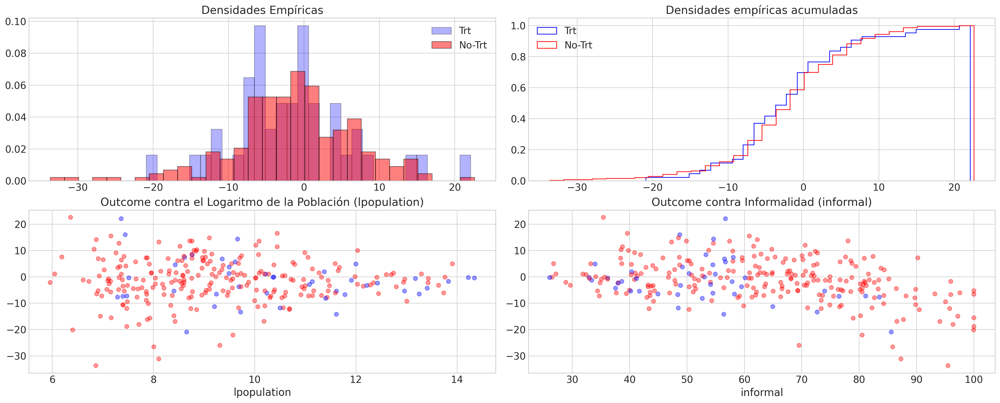

In [8]:
fig, axs = plt.subplots(2, 2, figsize=(20, 8))
axs = axs.flatten()
axs[0].hist(
    data[data["trt"] == 1]["outcome"],
    alpha=0.3,
    density=True,
    bins=30,
    label="Trt",
    ec="black",
    color="blue",
)
axs[0].hist(
    data[data["trt"] == 0]["outcome"],
    alpha=0.5,
    density=True,
    bins=30,
    label="No-Trt",
    ec="black",
    color="red",
)
axs[1].hist(
    data[data["trt"] == 1]["outcome"],
    density=True,
    bins=30,
    cumulative=True,
    histtype="step",
    label="Trt",
    color="blue",
)
axs[1].hist(
    data[data["trt"] == 0]["outcome"],
    density=True,
    bins=30,
    cumulative=True,
    histtype="step",
    label="No-Trt",
    color="red",
)
lkup = {1: "blue", 0: "red"}
axs[2].scatter(data["lpopulation"], data["outcome"], c=data["trt"].map(lkup), alpha=0.4)
axs[2].set_xlabel("lpopulation")
axs[3].scatter(data["informal"], data["outcome"], c=data["trt"].map(lkup), alpha=0.4)

axs[3].set_title("Outcome contra Informalidad (informal)")
axs[2].set_title("Outcome contra el Logaritmo de la Población (lpopulation)")
axs[3].set_xlabel("informal")
axs[0].set_title("Densidades Empíricas")
axs[0].legend()
axs[1].legend()
axs[1].set_title("Densidades empíricas acumuladas");

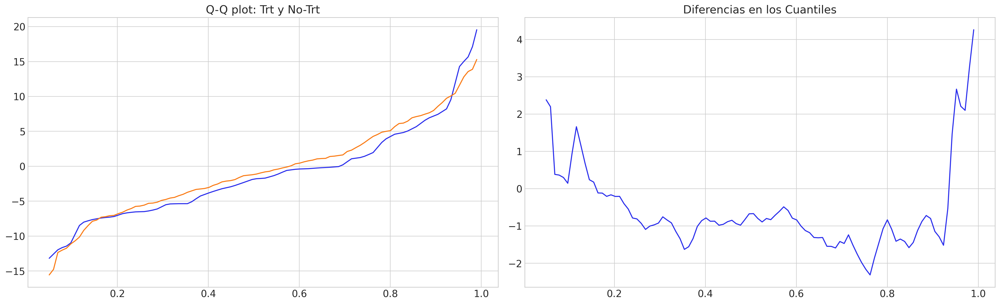

In [9]:
qs = np.linspace(0.05, 0.99, 100)
quantile_diff = (
    data.groupby("trt")[["outcome"]]
    .quantile(qs)
    .reset_index()
    .pivot(index="level_1", columns="trt", values="outcome")
    .rename({0: "Non-Trt", 1: "Trt"}, axis=1)
    .assign(diff=lambda x: x["Trt"] - x["Non-Trt"])
    .reset_index()
    .rename({"level_1": "quantile"}, axis=1)
)

fig, axs = plt.subplots(1, 2, figsize=(20, 6))
axs[0].plot(quantile_diff["quantile"], quantile_diff["Trt"])
axs[0].plot(quantile_diff["quantile"], quantile_diff["Non-Trt"])
axs[0].set_title("Q-Q plot: Trt y No-Trt")
axs[1].plot(quantile_diff["quantile"], quantile_diff["diff"])
axs[1].set_title("Diferencias en los Cuantiles");

## Diferencias en tratamiento ajustadas por caracteríticas y estatus de tratamiento (estratos)

### a) Primer criterio de estratos

In [10]:
strata_df = (
    data.groupby(
        [
            "trt",              # Tratamiento (0 = control, 1 = tratamiento)
            "urban",            # Urbano y rural (Urbano=1, rural=0)
            "maquila",          # Presencia importante de maquiladoras (si=1, no=0)
            "multi_poverty",   # Más del 50% de población en pobreza (si=1, no=0)
            "state_2",         # State: Baja California
            "state_5",         # State: Chihuahia
            "state_8",         # State: Coahuila
            "state_19",         # State: Nuevo Leon
            "state_26",         # State: Sonora
            "state_28",         # State: Tamaulipas
        ]
    )[["outcome"]]
    .agg(["count", "mean"])
)
global_avg = data["outcome"].mean()
strata_df["global_avg"] = global_avg
strata_df["diff"] = strata_df[("outcome", "mean")] - strata_df["global_avg"]
strata_df.reset_index(inplace=True)
strata_df.columns = [" ".join(col).strip() for col in strata_df.columns.values]
strata_df.style.background_gradient(axis=0)


,trt,urban,maquila,multi_poverty,state_2,state_5,state_8,state_19,state_26,state_28,outcome count,outcome mean,global_avg,diff
0,0,0,0,0,0,0,0,0,0,1,1,13.549729,-1.428533,14.978262
1,0,0,0,0,0,0,0,0,1,0,34,0.838396,-1.428533,2.266928
2,0,0,0,0,0,0,0,1,0,0,12,-8.162389,-1.428533,-6.733856
3,0,0,0,0,0,0,1,0,0,0,14,-2.927986,-1.428533,-1.499453
4,0,0,0,0,0,1,0,0,0,0,7,-2.077968,-1.428533,-0.649435
5,0,0,0,1,0,0,0,0,0,1,21,-4.335275,-1.428533,-2.906742
6,0,0,0,1,0,0,0,0,1,0,3,1.046965,-1.428533,2.475497
7,0,0,0,1,0,0,0,1,0,0,7,-10.102113,-1.428533,-8.673580
8,0,0,0,1,0,0,1,0,0,0,22,-1.496790,-1.428533,-0.068257
9,0,0,0,1,0,1,0,0,0,0,2,-2.328495,-1.428533,-0.899963


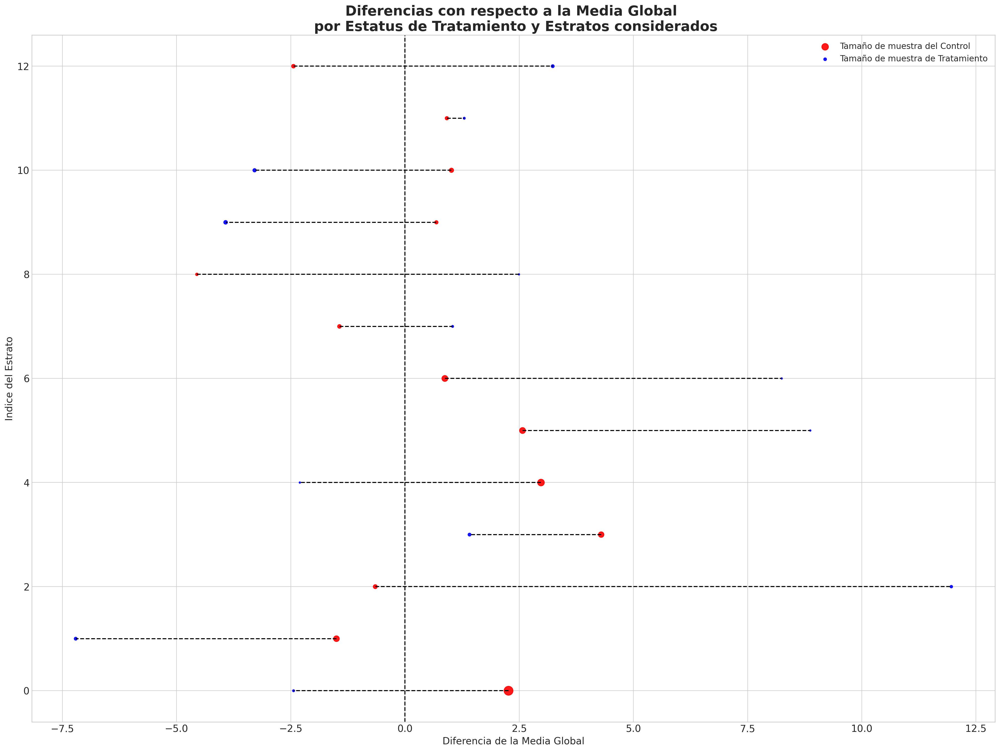

In [11]:
def make_strata_plot(strata_df):
    joined_df = strata_df[strata_df["trt"] == 0].merge(
        strata_df[strata_df["trt"] == 1],
        on=[
             "urban","maquila","multi_poverty",  "state_2",
            "state_5", "state_8",  "state_19", "state_26",  "state_28",
        ]
    )
    joined_df.sort_values("diff_y", inplace=True)

    def newline(p1, p2, color="black"):
        ax = plt.gca()
        line = mlines.Line2D([p1[0], p2[0]], [p1[1], p2[1]], color=color, linestyle="--")
        ax.add_line(line)
        return line

    fig, ax = plt.subplots(figsize=(20, 15))

    ax.scatter(
        joined_df["diff_x"],    
        joined_df.index,         
        color="red",
        alpha=0.9,
        label="Tamaño de muestra del Control",
        s=joined_df["outcome count_x"] * 5,
    )

    ax.scatter(
        joined_df["diff_y"],      
        joined_df.index,
        color="blue",
        alpha=0.9,
        label="Tamaño de muestra de Tratamiento",
        s=joined_df["outcome count_y"] * 5, 
    )

    for i, p1, p2 in zip(joined_df.index, joined_df["diff_x"], joined_df["diff_y"]):
        newline([p1, i], [p2, i])

    ax.set_xlabel("Diferencia de la Media Global", fontsize=14)
    ax.set_ylabel("Indice del Estrato", fontsize=14)
    ax.set_title(
        "Diferencias con respecto a la Media Global \n por Estatus de Tratamiento y Estratos considerados",
        fontsize=20,
        fontweight="bold",
    )

    ax.axvline(0, color="k", linestyle="--")
    ax.legend(fontsize=12)

make_strata_plot(strata_df)

In [12]:
strata_expected_df = strata_df.groupby("trt")[
    ["outcome count", "outcome mean", "diff"]
].agg({
    "outcome count": ["sum"],  
    "outcome mean": "mean",   
    "diff": "mean"   
})
print(
    "Diferencia de Tratamiento Ajustado 1:",
    strata_expected_df[("outcome mean", "mean")].iloc[1]  
    - strata_expected_df[("outcome mean", "mean")].iloc[0]  
)
strata_expected_df

Diferencia de Tratamiento Ajustado 1: 1.2693273011168251


,outcome count,outcome mean,diff
,sum,mean,mean
trt,,,
0,233,-1.316800,0.111733
1,43,-0.047472,1.381060


### a) Segundo criterio de estratos

Solamente cambiamos la variable "maquila" por "manufactur".

In [13]:
strata_df = (
    data.groupby(
        [
            "trt",             
            "urban",           
            "manufactur",         
            "multi_poverty",   
            "state_2",         
            "state_5",         
            "state_8",        
            "state_19",         
            "state_26",       
            "state_28",      
        ]
    )[["outcome"]]          
    .agg(["count", "mean"])   
)

global_avg = data["outcome"].mean()
strata_df["global_avg"] = global_avg
strata_df["diff"] = strata_df[("outcome", "mean")] - strata_df["global_avg"]
strata_df.reset_index(inplace=True)
strata_df.columns = [" ".join(col).strip() for col in strata_df.columns.values]
strata_df.style.background_gradient(axis=0)

,trt,urban,manufactur,multi_poverty,state_2,state_5,state_8,state_19,state_26,state_28,outcome count,outcome mean,global_avg,diff
0,0,0,0,0,0,0,0,0,1,0,33,0.716453,-1.428533,2.144986
1,0,0,0,0,0,0,0,1,0,0,11,-9.619216,-1.428533,-8.190683
2,0,0,0,0,0,0,1,0,0,0,10,-1.397389,-1.428533,0.031144
3,0,0,0,0,0,1,0,0,0,0,5,-2.912550,-1.428533,-1.484018
4,0,0,0,1,0,0,0,0,0,1,20,-4.601646,-1.428533,-3.173113
5,0,0,0,1,0,0,0,0,1,0,2,0.852461,-1.428533,2.280994
6,0,0,0,1,0,0,0,1,0,0,7,-10.102113,-1.428533,-8.673580
7,0,0,0,1,0,0,1,0,0,0,22,-1.496790,-1.428533,-0.068257
8,0,0,0,1,0,1,0,0,0,0,2,-2.328495,-1.428533,-0.899963
9,0,0,1,0,0,0,0,0,0,1,1,13.549729,-1.428533,14.978262


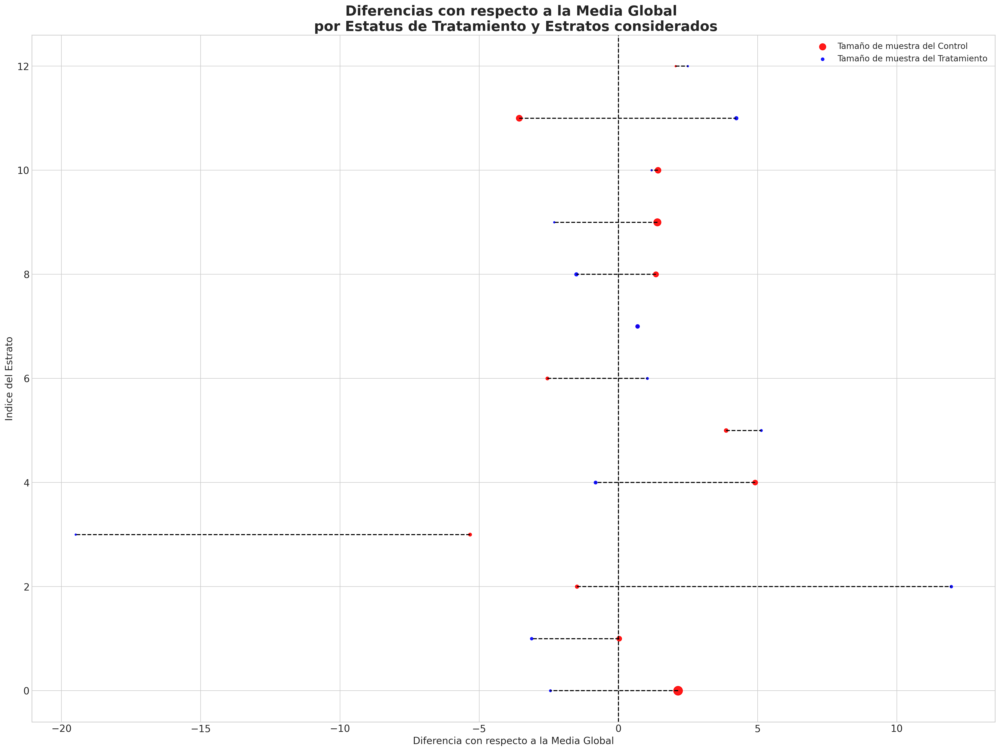

In [14]:
def make_strata_plot(strata_df):
    joined_df = strata_df[strata_df["trt"] == 0].merge(
        strata_df[strata_df["trt"] == 1],
        on=[
             "urban","manufactur","multi_poverty",  "state_2",
            "state_5", "state_8",  "state_19", "state_26",  "state_28",
        ]
    )
    joined_df.sort_values("diff_y", inplace=True)

    def newline(p1, p2, color="black"):
        ax = plt.gca()
        line = mlines.Line2D([p1[0], p2[0]], [p1[1], p2[1]], color=color, linestyle="--")
        ax.add_line(line)
        return line

    fig, ax = plt.subplots(figsize=(20, 15))

    ax.scatter(
        joined_df["diff_x"],       
        joined_df.index,           
        color="red",
        alpha=0.9,
        label="Tamaño de muestra del Control",
        s=joined_df["outcome count_x"] * 5,  
    )

    ax.scatter(
        joined_df["diff_y"],       
        joined_df.index,
        color="blue",
        alpha=0.9,
        label="Tamaño de muestra del Tratamiento",
        s=joined_df["outcome count_y"] * 5,  
    )

    for i, p1, p2 in zip(joined_df.index, joined_df["diff_x"], joined_df["diff_y"]):
        newline([p1, i], [p2, i])

    ax.set_xlabel("Diferencia con respecto a la Media Global", fontsize=14)
    ax.set_ylabel("Indice del Estrato", fontsize=14)
    ax.set_title(
        "Diferencias con respecto a la Media Global \n por Estatus de Tratamiento y Estratos considerados",
        fontsize=20,
        fontweight="bold",
    )
    ax.axvline(0, color="k", linestyle="--")
    ax.legend(fontsize=12)
make_strata_plot(strata_df)

In [15]:
strata_expected_df = strata_df.groupby("trt")[
    ["outcome count", "outcome mean", "diff"]
].agg({
    "outcome count": ["sum"],      
    "outcome mean": "mean",        
    "diff": "mean"                 
})

print(
    "Diferencia de Tratamiento Ajustado 2:",
    strata_expected_df[("outcome mean", "mean")].iloc[1]  
    - strata_expected_df[("outcome mean", "mean")].iloc[0] 
)

strata_expected_df

Diferencia de Tratamiento Ajustado 2: -1.6589187115491968


,outcome count,outcome mean,diff
,sum,mean,mean
trt,,,
0,233,-0.799118,0.629414
1,43,-2.458037,-1.029504


### Preparando los datos para la modelación

In [16]:
X = data.copy()
y = data["outcome"]
t = data["trt"]
X = X.drop(["LLAVE","trt", "outcome","manufactur", "state_2", "state_5", "state_8","state_19", "state_26", "state_28"], axis=1)
X.head()

,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr
0,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021
1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771
2,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477
3,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466
4,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860


### Modelación del Propensity Score

In [17]:
def make_propensity_model(X, t, bart=True, probit=True, samples=1000, m=50, random_seed=rng):
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model_ps:
        X_data = pm.MutableData("X", X)
        t_data = pm.MutableData("t", t)

        if bart:
            mu = pmb.BART("mu", X, t, m=m)
            if probit:
                p = pm.Deterministic("p", pm.math.invprobit(mu))
            else:
                p = pm.Deterministic("p", pm.math.invlogit(mu))
        else:
            b = pm.Normal("b", mu=0, sigma=1, dims="coeffs") 
            mu = pm.math.dot(X_data, b) 
            p = pm.Deterministic("p", pm.math.invlogit(mu))  
            
        t_pred = pm.Bernoulli("t_pred", p=p, observed=t_data, dims="obs")
        idata = pm.sample_prior_predictive(random_seed=rng)
        idata.extend(
            pm.sample(
                draws=samples, 
                init="adapt_diag", 
                random_seed=rng, 
                idata_kwargs={"log_likelihood": True}
            )
        )
        idata.extend(pm.sample_posterior_predictive(idata, random_seed=rng))
    return model_ps, idata

#### Propensity Score Logit

In [18]:
m_ps_logit, idata_logit = make_propensity_model(X, t, bart=False, samples=4000, random_seed=rng)

Sampling: [b, t_pred]
Auto-assigning NUTS sampler...
Initializing NUTS using adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [b]


Sampling 4 chains for 1_000 tune and 4_000 draw iterations (4_000 + 16_000 draws total) took 37 seconds.
Sampling: [t_pred]


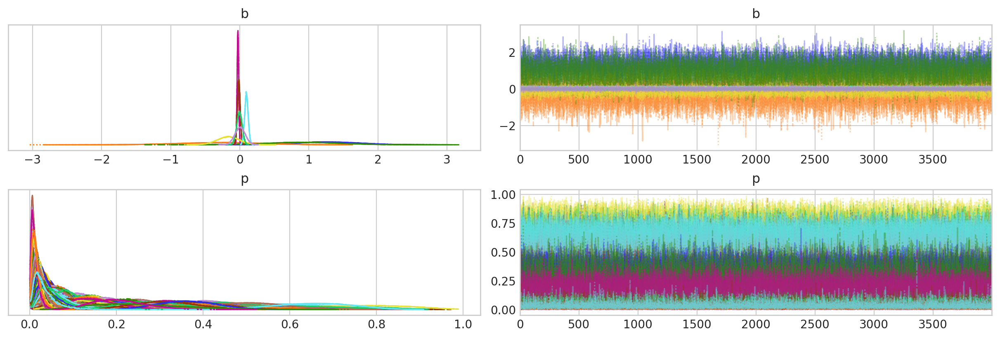

In [19]:
az.plot_trace(idata_logit, var_names=["b", "p"]);

#### Propensity Score BART

In [20]:
m_ps_probit, idata_probit = make_propensity_model(X, t, bart=True, probit=True, samples=4000, random_seed=rng)

Sampling: [mu, t_pred]
Multiprocess sampling (4 chains in 4 jobs)
PGBART: [mu]


Sampling 4 chains for 1_000 tune and 4_000 draw iterations (4_000 + 16_000 draws total) took 117 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Sampling: [t_pred]


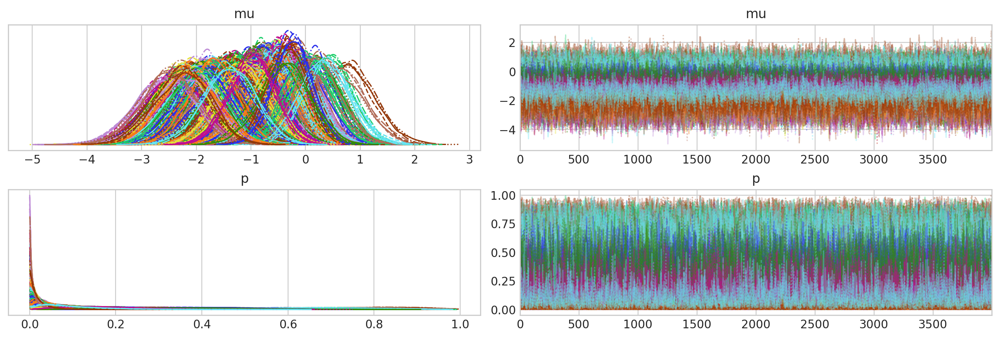

In [21]:
az.plot_trace(idata_probit, var_names=["mu", "p"]);

## Visualizaciones de las probabilidades de tratamiento a los municipios.

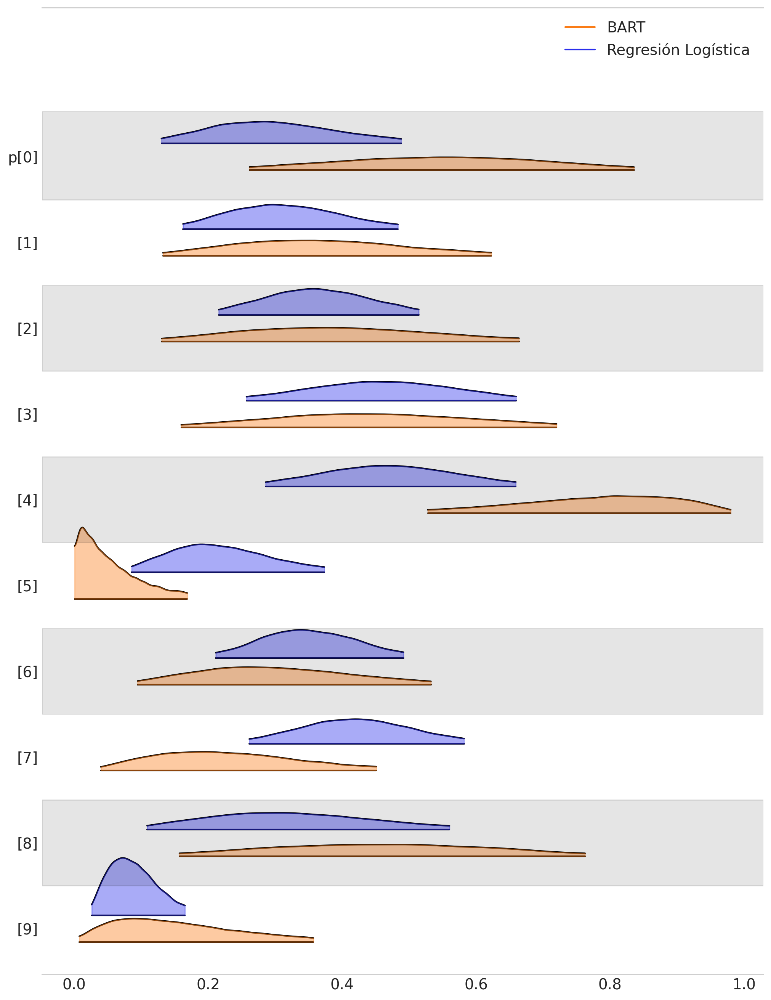

In [23]:
import arviz as az
import warnings
import os
warnings.filterwarnings("ignore")   

os.environ["NUMBA_DISABLE_JIT"] = "1"
az.rcParams["data.load"] = "eager" 
az.plot_forest(
    [idata_logit, idata_probit], 
    var_names=["p"],                     
    coords={"p_dim_0": range(10)},       
    figsize=(10, 13),                    
    combined=True,                   
    kind="ridgeplot",                     
    model_names=["Regresión Logística", "BART"],  
    r_hat=False,     
    ridgeplot_alpha=0.4,               
);

In [24]:
ps_logit = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).round(2)
ps_logit

<xarray.DataArray 'p' (p_dim_0: 276)>
array([0.3 , 0.32, 0.37, 0.46, 0.47, 0.22, 0.35, 0.42, 0.33, 0.09, 0.2 ,
       0.14, 0.13, 0.17, 0.11, 0.06, 0.14, 0.61, 0.08, 0.12, 0.05, 0.22,
       0.34, 0.12, 0.3 , 0.11, 0.38, 0.1 , 0.13, 0.4 , 0.1 , 0.33, 0.11,
       0.12, 0.35, 0.19, 0.08, 0.21, 0.1 , 0.46, 0.13, 0.23, 0.41, 0.09,
       0.07, 0.14, 0.11, 0.28, 0.03, 0.05, 0.03, 0.04, 0.21, 0.23, 0.07,
       0.22, 0.03, 0.04, 0.04, 0.25, 0.05, 0.26, 0.04, 0.33, 0.02, 0.17,
       0.03, 0.04, 0.02, 0.03, 0.09, 0.03, 0.03, 0.07, 0.09, 0.02, 0.04,
       0.1 , 0.08, 0.39, 0.03, 0.02, 0.07, 0.03, 0.03, 0.04, 0.07, 0.39,
       0.15, 0.09, 0.05, 0.02, 0.15, 0.11, 0.38, 0.02, 0.04, 0.06, 0.05,
       0.02, 0.02, 0.06, 0.08, 0.02, 0.15, 0.34, 0.03, 0.05, 0.03, 0.02,
       0.05, 0.03, 0.07, 0.1 , 0.1 , 0.36, 0.02, 0.08, 0.41, 0.2 , 0.07,
       0.17, 0.24, 0.02, 0.04, 0.03, 0.02, 0.34, 0.17, 0.17, 0.4 , 0.15,
       0.03, 0.02, 0.19, 0.4 , 0.03, 0.08, 0.08, 0.02, 0.22, 0.09, 0.23,
       0.12, 0.02, 0.02, 0.09, 0.08, 0.37, 0.03, 0.31, 0.11, 0.02, 0.08,
       0.4 , 0.36, 0.12, 0.17, 0.12, 0.04, 0.06, 0.07, 0.58, 0.03, 0.21,
       0.07, 0.12, 0.06, 0.08, 0.08, 0.13, 0.05, 0.15, 0.05, 0.05, 0.43,
       0.08, 0.44, 0.25, 0.21, 0.25, 0.11, 0.1 , 0.05, 0.03, 0.38, 0.08,
       0.17, 0.06, 0.37, 0.31, 0.06, 0.08, 0.07, 0.04, 0.57, 0.16, 0.29,
       0.04, 0.41, 0.1 , 0.24, 0.23, 0.33, 0.4 , 0.13, 0.23, 0.13, 0.19,
       0.04, 0.04, 0.13, 0.19, 0.06, 0.22, 0.59, 0.69, 0.14, 0.27, 0.08,
       0.22, 0.41, 0.16, 0.06, 0.15, 0.07, 0.03, 0.09, 0.2 , 0.15, 0.49,
       0.15, 0.14, 0.03, 0.02, 0.37, 0.02, 0.03, 0.01, 0.51, 0.03, 0.36,
       0.02, 0.02, 0.12, 0.03, 0.15, 0.54, 0.04, 0.01, 0.04, 0.02, 0.03,
       0.15, 0.38, 0.07, 0.05, 0.29, 0.01, 0.5 , 0.05, 0.03, 0.04, 0.01,
       0.31, 0.65, 0.02, 0.06, 0.02, 0.03, 0.36, 0.02, 0.25, 0.21, 0.03,
       0.04])
Coordinates:
  * p_dim_0  (p_dim_0) int32 0 1 2 3 4 5 6 7 ... 268 269 270 271 272 273 274 275

In [25]:
ps_probit = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).round(2)
ps_probit

<xarray.DataArray 'p' (p_dim_0: 276)>
array([0.55, 0.37, 0.4 , 0.45, 0.77, 0.06, 0.31, 0.24, 0.46, 0.17, 0.17,
       0.2 , 0.1 , 0.18, 0.05, 0.13, 0.18, 0.35, 0.16, 0.12, 0.03, 0.21,
       0.22, 0.14, 0.24, 0.2 , 0.25, 0.26, 0.11, 0.43, 0.08, 0.19, 0.05,
       0.19, 0.25, 0.08, 0.04, 0.27, 0.04, 0.37, 0.2 , 0.15, 0.39, 0.05,
       0.1 , 0.25, 0.09, 0.54, 0.07, 0.05, 0.06, 0.07, 0.28, 0.2 , 0.04,
       0.43, 0.05, 0.15, 0.04, 0.18, 0.13, 0.18, 0.08, 0.17, 0.02, 0.15,
       0.08, 0.02, 0.03, 0.03, 0.18, 0.03, 0.05, 0.05, 0.07, 0.02, 0.05,
       0.38, 0.1 , 0.45, 0.03, 0.02, 0.11, 0.02, 0.1 , 0.03, 0.04, 0.27,
       0.12, 0.13, 0.04, 0.03, 0.12, 0.19, 0.56, 0.1 , 0.06, 0.08, 0.09,
       0.02, 0.04, 0.05, 0.08, 0.04, 0.07, 0.09, 0.04, 0.09, 0.03, 0.02,
       0.07, 0.03, 0.06, 0.1 , 0.19, 0.28, 0.02, 0.04, 0.33, 0.08, 0.14,
       0.22, 0.18, 0.02, 0.05, 0.05, 0.02, 0.27, 0.09, 0.14, 0.3 , 0.18,
       0.05, 0.02, 0.1 , 0.26, 0.03, 0.15, 0.13, 0.02, 0.15, 0.12, 0.11,
       0.14, 0.05, 0.03, 0.08, 0.06, 0.44, 0.03, 0.29, 0.09, 0.04, 0.12,
       0.35, 0.29, 0.12, 0.2 , 0.05, 0.08, 0.02, 0.09, 0.58, 0.04, 0.26,
       0.06, 0.09, 0.04, 0.05, 0.07, 0.12, 0.05, 0.19, 0.08, 0.03, 0.17,
       0.05, 0.66, 0.25, 0.24, 0.1 , 0.17, 0.04, 0.05, 0.06, 0.24, 0.11,
       0.11, 0.07, 0.26, 0.24, 0.06, 0.04, 0.04, 0.02, 0.38, 0.1 , 0.17,
       0.02, 0.7 , 0.1 , 0.17, 0.18, 0.34, 0.17, 0.08, 0.09, 0.15, 0.4 ,
       0.04, 0.07, 0.1 , 0.21, 0.04, 0.11, 0.63, 0.3 , 0.11, 0.21, 0.19,
       0.2 , 0.27, 0.08, 0.06, 0.11, 0.03, 0.05, 0.06, 0.15, 0.08, 0.49,
       0.15, 0.1 , 0.04, 0.02, 0.31, 0.02, 0.05, 0.01, 0.5 , 0.05, 0.32,
       0.04, 0.01, 0.07, 0.04, 0.18, 0.57, 0.03, 0.02, 0.09, 0.02, 0.03,
       0.2 , 0.41, 0.03, 0.15, 0.52, 0.01, 0.59, 0.04, 0.06, 0.02, 0.03,
       0.37, 0.64, 0.02, 0.04, 0.03, 0.01, 0.4 , 0.03, 0.35, 0.18, 0.02,
       0.1 ])
Coordinates:
  * p_dim_0  (p_dim_0) int32 0 1 2 3 4 5 6 7 ... 268 269 270 271 272 273 274 275

###  Municipios con Propensity Score extremos

In [26]:
ps_logit_series = pd.Series(ps_logit.values, index=dat.index)
ps_probit_series = pd.Series(ps_probit.values, index=dat.index)

extremely_low_logit = dat.loc[ps_logit_series < 0.1]
extremely_high_logit = dat.loc[ps_logit_series > 0.9]

extremely_low_bart = dat.loc[ps_probit_series < 0.1]
extremely_high_bart = dat.loc[ps_probit_series > 0.9]
dat_trim = dat.loc[(ps_probit_series > 0.1) & (ps_probit_series < 0.9)]

print("Modelo Logístico:")
print(f"p < 0.1: {len(extremely_low_logit)} municipios")
print(f"p > 0.9: {len(extremely_high_logit)} municipios\n")

print("Modelo BART:")
print(f"p < 0.1: {len(extremely_low_bart)} municipios")
print(f"p > 0.9: {len(extremely_high_bart)} municipios")

Modelo Logístico:
p < 0.1: 134 municipios
p > 0.9: 0 municipios

Modelo BART:
p < 0.1: 133 municipios
p > 0.9: 0 municipios


In [27]:
print("Municipios con p < 0.1 (Logit):")
display(extremely_low_logit)

print("\nMunicipios con p > 0.9 (Logit):")
display(extremely_high_logit)

print("\nMunicipios con p < 0.1 (BART):")
display(extremely_low_bart)

print("\nMunicipios con p > 0.9 (BART):")
display(extremely_high_bart)

Municipios con p < 0.1 (Logit):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome
9,5005,Coahuila de Zaragoza Candela,5,1,0,0,0,61.929806,71.417700,16.983690,7.454720,4.423556,0.803615,increment moderate,increment low,0,4.137837
15,5011,Coahuila de Zaragoza General Cepeda,5,0,0,0,0,69.529713,62.259350,16.490831,9.311181,12.079574,2.934521,increment strong,increment moderate,0,-25.979171
18,5014,Coahuila de Zaragoza Jiménez,5,0,0,0,0,58.275048,57.229494,15.819621,9.243872,3.861486,0.412375,increment moderate,increment low,1,-6.538226
20,5016,Coahuila de Zaragoza Lamadrid,5,0,0,0,0,70.840794,58.982051,11.064278,7.486053,1.369484,3.771593,increment low,increment moderate,0,-3.233607
36,5032,Coahuila de Zaragoza San Juan de Sabinas,5,1,0,0,1,43.397014,80.756021,7.821071,10.687937,-2.233439,2.882406,decrement moderate,increment moderate,0,-12.060272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,28036,Tamaulipas San Nicolás,28,0,0,1,0,88.176814,47.761995,6.938398,6.978214,1.884812,0.240078,increment low,stable,0,-7.226656
269,28037,Tamaulipas Soto la Marina,28,0,0,1,0,69.322906,66.298958,10.841001,10.201813,1.158038,-2.561423,increment low,decrement moderate,0,-5.291180
271,28039,Tamaulipas Tula,28,0,0,1,0,86.588621,62.518163,9.667958,10.185126,2.466021,3.765178,increment low,increment moderate,0,-16.877119
274,28042,Tamaulipas Villagrán,28,0,0,1,0,71.468508,66.237723,11.314454,8.759669,-8.311871,-1.673659,decrement strong,decrement moderate,0,8.601933



Municipios con p > 0.9 (Logit):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome



Municipios con p < 0.1 (BART):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome
5,5001,Coahuila de Zaragoza Abasolo,5,0,0,0,0,72.182045,54.588239,27.102605,6.928538,1.470918,4.637382,increment low,increment moderate,0,0.357929
14,5010,Coahuila de Zaragoza Frontera,5,1,0,0,1,35.651284,87.433332,11.903218,11.321256,-1.466004,-2.451241,decrement low,decrement moderate,0,-0.089157
20,5016,Coahuila de Zaragoza Lamadrid,5,0,0,0,0,70.840794,58.982051,11.064278,7.486053,1.369484,3.771593,increment low,increment moderate,0,-3.233607
30,5026,Coahuila de Zaragoza Progreso,5,0,0,0,0,47.308625,89.371825,13.946750,8.107720,-18.668741,-0.964865,decrement strong,decrement low,0,13.242151
32,5028,Coahuila de Zaragoza Sabinas,5,1,0,0,1,34.724966,89.068049,11.499808,11.066545,-0.122903,-1.525382,stable,decrement moderate,0,-7.218971
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,28035,Tamaulipas San Fernando,28,1,0,1,1,73.049938,65.648329,12.269242,10.914888,2.122491,-0.819713,increment low,decrement low,0,-6.765276
268,28036,Tamaulipas San Nicolás,28,0,0,1,0,88.176814,47.761995,6.938398,6.978214,1.884812,0.240078,increment low,stable,0,-7.226656
269,28037,Tamaulipas Soto la Marina,28,0,0,1,0,69.322906,66.298958,10.841001,10.201813,1.158038,-2.561423,increment low,decrement moderate,0,-5.291180
271,28039,Tamaulipas Tula,28,0,0,1,0,86.588621,62.518163,9.667958,10.185126,2.466021,3.765178,increment low,increment moderate,0,-16.877119



Municipios con p > 0.9 (BART):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome


###  Mapas

In [28]:
geo = pd.read_excel("georef-mexico-municipality-millesime@public.xlsx")
print(geo.columns)

Index(['Geo Point', 'Geo Shape', 'Year', 'State code', 'State name',
       'Municipality code', 'Municipality name', 'ISO 3166-3 Area code',
       'Type'],
      dtype='object')


In [29]:
print(geo["Municipality code"].head())

0    7016
1    7036
2    7050
3    7067
4    7114
Name: Municipality code, dtype: int64


In [30]:
geo["LLAVE"] = geo["Municipality code"].astype(str).str.zfill(5)

In [31]:
geo[['lat', 'lon']] = geo["Geo Point"].str.extract(r"\(?\s*([-\d.]+),\s*([-\d.]+)\s*\)?").astype(float)

In [32]:
geo["geometry"] = geo.apply(lambda row: Point(row["lon"], row["lat"]), axis=1)

In [33]:
gdf = gpd.GeoDataFrame(geo, geometry="geometry", crs="EPSG:4326")

In [34]:
data["LLAVE"] = data["LLAVE"].astype(str).str.zfill(5)
data["ps_logit"] = ps_logit_series

In [35]:
gdf = gdf.merge(data[["LLAVE", "ps_logit"]], on="LLAVE", how="left")

In [36]:
def classify_propensity(p):
    if pd.isnull(p):
        return "No data"
    elif p < 0.1:
        return "Low (<0.1)"
    elif p > 0.9:
        return "High (>0.9)"
    else:
        return "Mid (0.1–0.9)"
gdf["ps_group"] = gdf["ps_logit"].apply(classify_propensity)

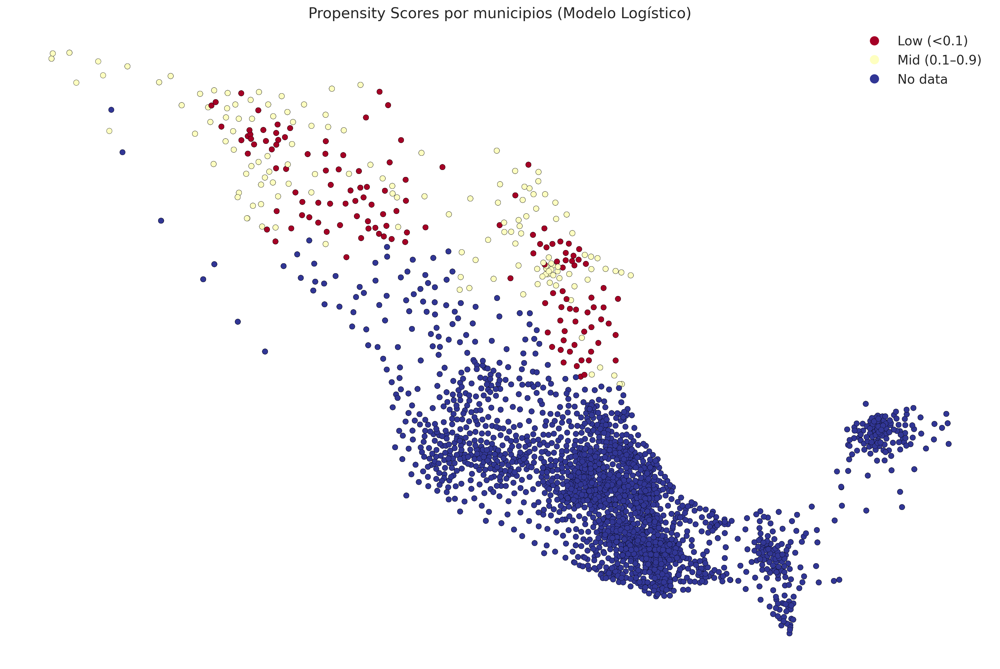

In [37]:
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf.plot(column="ps_group", cmap="RdYlBu", linewidth=0.2, edgecolor="black", legend=True, ax=ax)
ax.set_title("Propensity Scores por municipios (Modelo Logístico)", fontsize=16)
ax.axis("off")
plt.show()

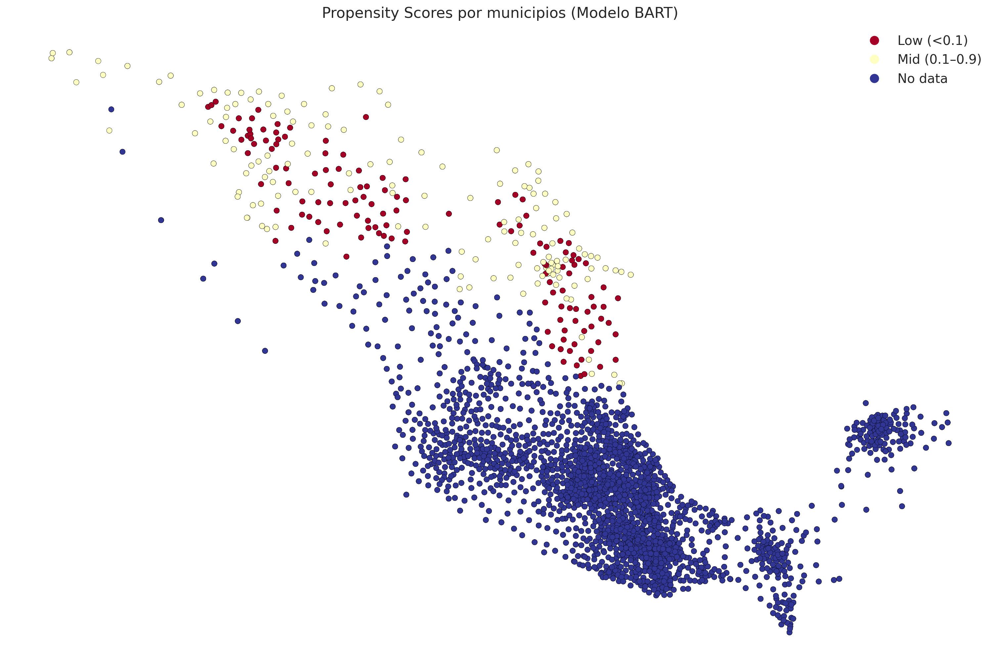

In [38]:
data["LLAVE"] = data["LLAVE"].astype(str).str.zfill(5)
data["ps_bart"] = ps_probit_series
gdf_bart = gdf.merge(data[["LLAVE", "ps_bart"]], on="LLAVE", how="left")

def classify_propensity_bart(p):
    if pd.isnull(p):
        return "No data"
    elif p < 0.1:
        return "Low (<0.1)"
    elif p > 0.9:
        return "High (>0.9)"
    else:
        return "Mid (0.1–0.9)"

gdf_bart["ps_group_bart"] = gdf_bart["ps_bart"].apply(classify_propensity_bart)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_bart.plot(column="ps_group_bart", cmap="RdYlBu", linewidth=0.2, edgecolor="black", legend=True, ax=ax)
ax.set_title("Propensity Scores por municipios (Modelo BART)", fontsize=16)
ax.axis("off")
plt.show()

### Distribución de propensity scores bajo cada modelo

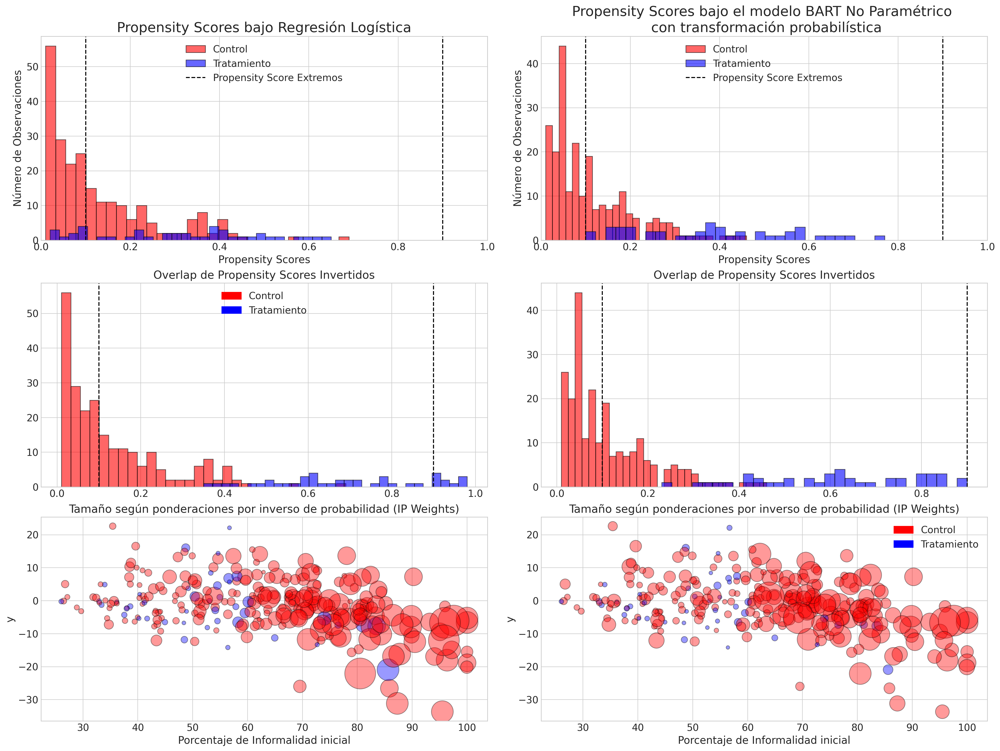

In [39]:
fig, axs = plt.subplots(3, 2, figsize=(20, 15))
axs = axs.flatten()

colors = {1: "blue", 0: "red"}

axs[0].hist(ps_logit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)

axs[0].hist(ps_logit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)

axs[0].set_xlabel("Propensity Scores")
axs[0].set_ylabel("Número de Observaciones")
axs[0].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[0].axvline(0.1, color="black", linestyle="--")
axs[0].set_xlim(0, 1)
axs[0].set_title("Propensity Scores bajo Regresión Logística", fontsize=20)

axs[1].hist(ps_probit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[1].hist(ps_probit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[1].set_xlabel("Propensity Scores")
axs[1].set_ylabel("Número de Observaciones")
axs[1].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[1].axvline(0.1, color="black", linestyle="--")
axs[1].set_xlim(0, 1)
axs[1].set_title("Propensity Scores bajo el modelo BART No Paramétrico \n con transformación probabilística", fontsize=20)

axs[2].hist(ps_logit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[2].hist(1 - ps_logit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[2].set_title("Overlap de Propensity Scores Invertidos")
axs[2].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[2].axvline(0.1, color="black", linestyle="--")

axs[3].hist(ps_probit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[3].hist(1 - ps_probit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[3].set_title("Overlap de Propensity Scores Invertidos")
axs[3].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[3].axvline(0.1, color="black", linestyle="--")

axs[4].scatter(
    X["informal"], y,
    color=t.map(colors),
    s=(1 / ps_logit.values) * 20,
    ec="black",
    alpha=0.4
)
axs[4].set_xlabel("Porcentaje de Informalidad inicial")
axs[4].set_ylabel("y")
axs[4].set_title("Tamaño según ponderaciones por inverso de probabilidad (IP Weights)")

# Scatter plot: Same as above but using BART-based propensity scores
axs[5].scatter(
    X["informal"], y,
    color=t.map(colors),
    s=(1 / ps_probit.values) * 20,
    ec="black",
    alpha=0.4
)
axs[5].set_xlabel("Porcentaje de Informalidad inicial")
axs[5].set_ylabel("y")
axs[5].set_title("Tamaño según ponderaciones por inverso de probabilidad (IP Weights)")

red_patch = mpatches.Patch(color="red", label="Control")
blue_patch = mpatches.Patch(color="blue", label="Tratamiento")
axs[0].legend()
axs[1].legend()
axs[2].legend(handles=[red_patch, blue_patch])
axs[5].legend(handles=[red_patch, blue_patch])

### Balance de las covariables a través de las particiones del Propensity Score.

In [40]:
temp = X.copy()  
temp["ps"] = ps_logit.values 
temp["ps_cut"] = pd.qcut(temp["ps"], 5)  

def plot_balance(temp, col, t):
    fig, axs = plt.subplots(1, 5, figsize=(20, 9))
    axs = axs.flatten() 

    for c, ax in zip(np.sort(temp["ps_cut"].unique()), axs):
        std0 = temp[(t == 0) & (temp["ps_cut"] == c)][col].std()
        std1 = temp[(t == 1) & (temp["ps_cut"] == c)][col].std()

        pooled_std = (std0 + std1) / 2

        mean_diff = (
            temp[(t == 0) & (temp["ps_cut"] == c)][col].mean()
            - temp[(t == 1) & (temp["ps_cut"] == c)][col].mean()
        ) / pooled_std

        ax.hist(
            temp[(t == 0) & (temp["ps_cut"] == c)][col],
            alpha=0.6,
            color="red",
            density=True,
            ec="black",
            bins=10,
            cumulative=False,
        )

        ax.hist(
            temp[(t == 1) & (temp["ps_cut"] == c)][col],
            alpha=0.4,
            color="blue",
            density=True,
            ec="black",
            bins=10,
            cumulative=False,
        )

        ax.set_title(f"Prop. Score: {c} \n Dif. Media Estandarizada {np.round(mean_diff, 4)} ")

        ax.set_xlabel(col)

        red_patch = mpatches.Patch(color="red", label="Control")
        blue_patch = mpatches.Patch(color="blue", label="Tratamiento")
        axs[0].legend(handles=[red_patch, blue_patch])

    plt.suptitle(
        f"Función de Densidad de {col} \n por Particiones del Propensity Score",
        fontsize=20,
        fontweight="bold",
    )

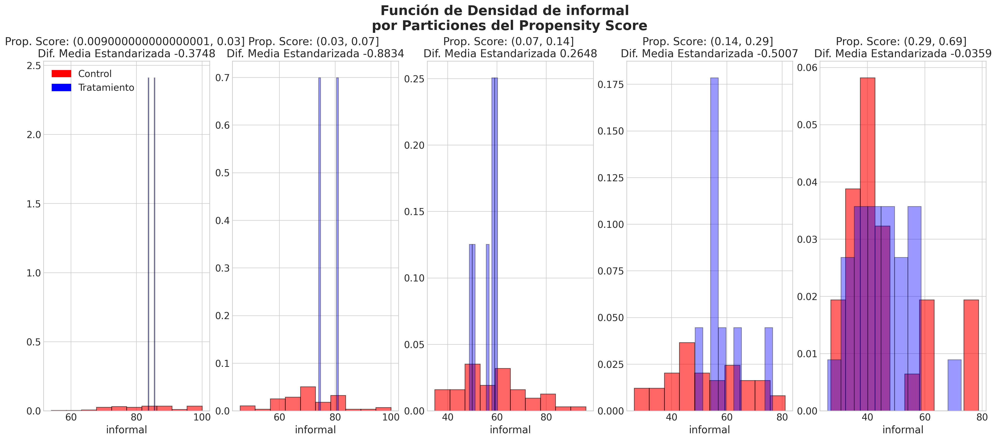

In [41]:
plot_balance(temp, "informal", t)

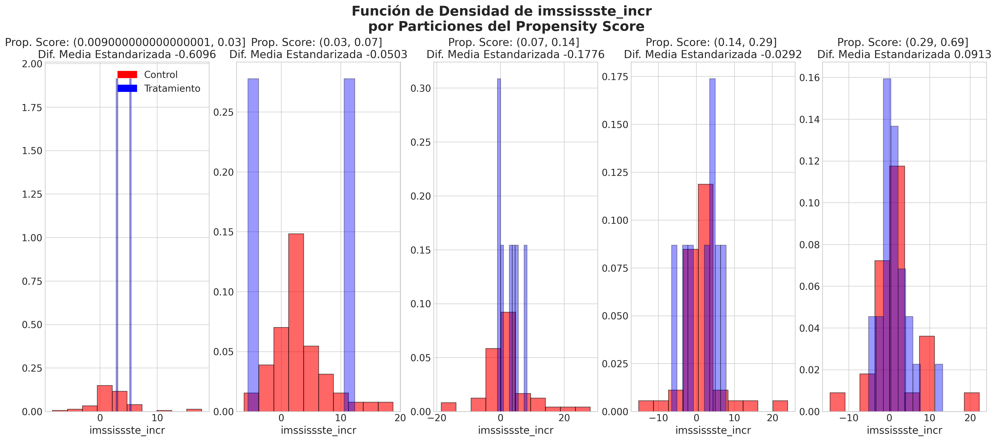

In [42]:
plot_balance(temp, "imssissste_incr", t)

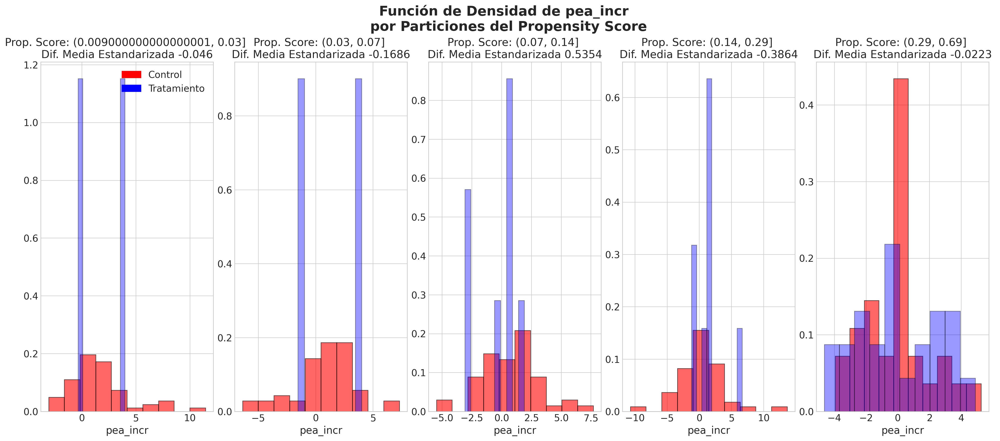

In [43]:
plot_balance(temp, "pea_incr", t)

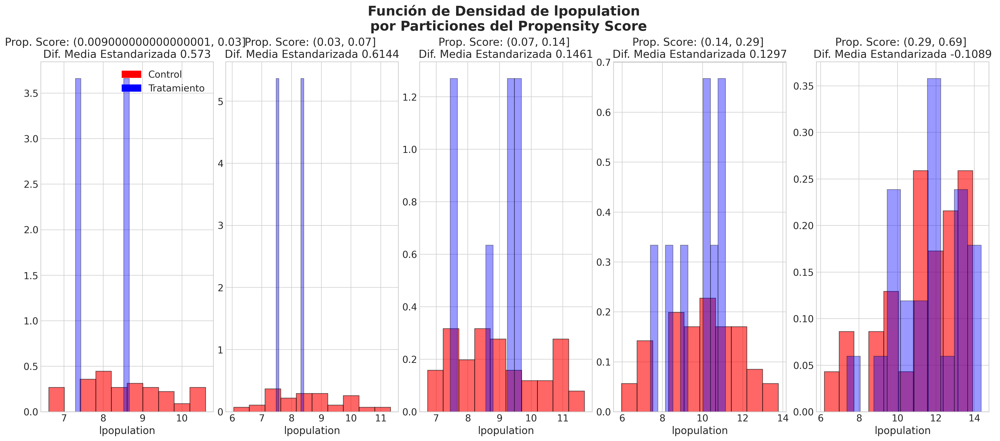

In [44]:
plot_balance(temp, "lpopulation", t)

## Esquemas de ponderación robustos y doble robustos

## Estimaciones de los efectos de tratamiento

In [45]:
def make_robust_adjustments(X, t):
    X["trt"] = t 
    p_of_t = X["trt"].mean()
    X["i_ps"] = np.where(t, (p_of_t / X["ps"]), (1 - p_of_t) / (1 - X["ps"]))
    n_ntrt = X[X["trt"] == 0].shape[0]
    n_trt = X[X["trt"] == 1].shape[0]
    outcome_trt = X[X["trt"] == 1]["outcome"]
    outcome_ntrt = X[X["trt"] == 0]["outcome"]
    i_propensity0 = X[X["trt"] == 0]["i_ps"]
    i_propensity1 = X[X["trt"] == 1]["i_ps"]
    weighted_outcome1 = outcome_trt * i_propensity1
    weighted_outcome0 = outcome_ntrt * i_propensity0
    return weighted_outcome0, weighted_outcome1, n_ntrt, n_trt

def make_raw_adjustments(X, t):
    X["trt"] = t  
    X["ps"] = np.where(X["trt"], X["ps"], 1 - X["ps"])
    X["i_ps"] = 1 / X["ps"]
    n_ntrt = n_trt = len(X)

    outcome_trt = X[X["trt"] == 1]["outcome"]
    outcome_ntrt = X[X["trt"] == 0]["outcome"]
    i_propensity0 = X[X["trt"] == 0]["i_ps"]
    i_propensity1 = X[X["trt"] == 1]["i_ps"]

    weighted_outcome1 = outcome_trt * i_propensity1
    weighted_outcome0 = outcome_ntrt * i_propensity0

    return weighted_outcome0, weighted_outcome1, n_ntrt, n_trt

def make_doubly_robust_adjustment(X, t, y):
    m0 = sm.OLS(y[t == 0], X[t == 0].astype(float)).fit()
    m1 = sm.OLS(y[t == 1], X[t == 1].astype(float)).fit()
    m0_pred = m0.predict(X)
    m1_pred = m1.predict(X)

    X["trt"] = t
    X["y"] = y

    weighted_outcome0 = (1 - X["trt"]) * (X["y"] - m0_pred) / (1 - X["ps"]) + m0_pred
    weighted_outcome1 = X["trt"] * (X["y"] - m1_pred) / X["ps"] + m1_pred

    return weighted_outcome0, weighted_outcome1, None, None

In [46]:
def plot_weights(bins, top0, top1, ylim, ax):
    ax.axhline(0, c="gray", linewidth=1)
    ax.set_ylim(ylim)

    bars0 = ax.bar(bins[:-1] + 0.025, top0, width=0.04, facecolor="red", alpha=0.6)
    bars1 = ax.bar(bins[:-1] + 0.025, -top1, width=0.04, facecolor="blue", alpha=0.6)

    for bars in (bars0, bars1):
        for bar in bars:
            bar.set_edgecolor("black")

    for x, y in zip(bins, top0):
        ax.text(x + 0.025, y + 1, str(y), ha="center", va="bottom")

    for x, y in zip(bins, top1):
        ax.text(x + 0.025, -y - 1, str(y), ha="center", va="top")

def make_plot(
    X,
    idata,
    lower_bins=[np.arange(1, 30, 1), np.arange(1, 30, 1)],
    ylims=[(-10, 100), (-5, 15), (-5, 12)],
    text_pos=(10, 40),
    ps=None,
    method="robust", 
):
    X = X.copy()

    if ps is None:
        n_list = list(range(1000))
        choice = np.random.choice(n_list, 1)[0]
        X["ps"] = idata["posterior"]["p"].stack(z=("chain", "draw"))[:, choice].values
    else:
        X["ps"] = ps  

    X["trt"] = t

    propensity0 = X[X["trt"] == 0]["ps"]
    propensity1 = X[X["trt"] == 1]["ps"]

    if method == "robust":
        X["outcome"] = y
        weighted_outcome0, weighted_outcome1, n_ntrt, n_trt = make_robust_adjustments(X, t)
    elif method == "raw":
        X["outcome"] = y
        weighted_outcome0, weighted_outcome1, n_ntrt, n_trt = make_raw_adjustments(X, t)
    else:
        weighted_outcome0, weighted_outcome1, _, _ = make_doubly_robust_adjustment(X, t, y)

    bins = np.arange(0.025, 0.85, 0.05)
    top0, _ = np.histogram(propensity0, bins=bins)
    top1, _ = np.histogram(propensity1, bins=bins)

    fig, axs = plt.subplots(3, 1, figsize=(20, 20))
    axs = axs.flatten()

    plot_weights(bins, top0, top1, ylims[0], axs[0])
    axs[0].text(0.05, 90, "Control = 0")
    axs[0].text(0.05, 86, "Tratamiento = 1")
    axs[0].set_ylabel("No. Municipios", fontsize=14)
    axs[0].set_xlabel("Propensity Score Estimado", fontsize=14)
    axs[0].set_title(
        "Propensity Scores Inferidos y Resultado Ponderado por IP \n por Grupo de Tratamiento y Control",
        fontsize=20,
    )

    outcome_trt = y[t == 1]
    outcome_ntrt = y[t == 0]
    top0, _ = np.histogram(outcome_ntrt, bins=lower_bins[0])
    top1, _ = np.histogram(outcome_trt, bins=lower_bins[0])
    plot_weights(lower_bins[0], top0, top1, ylims[2], axs[1])
    axs[1].set_ylabel("No. Municipios", fontsize=14)
    axs[1].set_xlabel("Medida Bruta del Efecto", fontsize=14)
    axs[1].text(text_pos[0], text_pos[1] - 32, f"Control: E(Y) = {outcome_ntrt.mean():.2f}")
    axs[1].text(text_pos[0], text_pos[1] - 33, f"Tratamiento: E(Y) = {outcome_trt.mean():.2f}")
    axs[1].text(
        text_pos[0],
        text_pos[1] - 34,
        f"tau: E(Y(1) - Y(0)) = {(outcome_trt.mean()- outcome_ntrt.mean()):.2f}",
        fontweight="bold",
    )

    axs[2].set_ylabel("No. Municipios", fontsize=14)

    if method in ["raw", "robust"]:
        top0, _ = np.histogram(weighted_outcome0, bins=lower_bins[1])
        top1, _ = np.histogram(weighted_outcome1, bins=lower_bins[1])
        plot_weights(lower_bins[1], top0, top1, ylims[1], axs[2])
        axs[2].set_xlabel("Resultado Estimado Ponderado por IP \n Ajustado", fontsize=14)

        E0 = weighted_outcome0.sum() / n_ntrt
        E1 = weighted_outcome1.sum() / n_trt
        axs[2].text(text_pos[0], text_pos[1] - 30, f"Control: E(Y) = {E0:.2f}")
        axs[2].text(text_pos[0], text_pos[1] - 31, f"Tratamiento: E(Y) = {E1:.2f}")
        axs[2].text(
            text_pos[0],
            text_pos[1] - 32,
            f"tau: E(Y(1) - Y(0)) = {(E1 - E0):.2f}",
            fontweight="bold",
        )

    else:
        top0, _ = np.histogram(weighted_outcome0, bins=lower_bins[1])
        top1, _ = np.histogram(weighted_outcome1, bins=lower_bins[1])
        plot_weights(lower_bins[1], top0, top1, ylims[1], axs[2])
        E0 = np.round(np.mean(weighted_outcome0), 5)
        E1 = np.round(np.mean(weighted_outcome1), 5)
        axs[2].set_xlabel("Resultado Estimado Ponderado por IP \n Desplazado", fontsize=14)
        axs[2].text(text_pos[0], text_pos[1] -14, f"Control: E(Y) = {E0}")
        axs[2].text(text_pos[0], text_pos[1] - 15, f"Tratamiento: E(Y) = {E1}")
        axs[2].text(
            text_pos[0],
            text_pos[1] - 16,
            f"tau: E(Y(1) - Y(0)) = {E1 - E0}",
            fontweight="bold",
        )

### El modelo de Propensity Logit

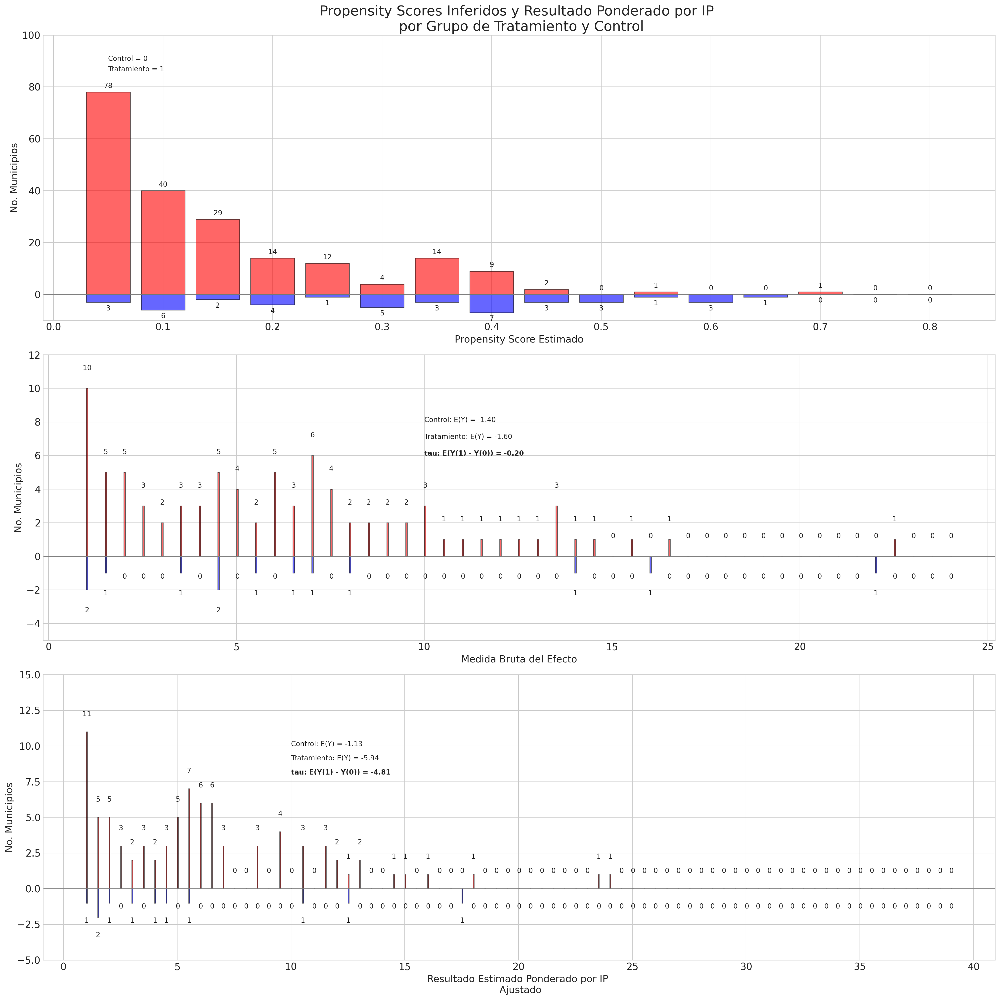

In [47]:
make_plot(
    X,                 
    idata_logit,     
    method="robust",   
    ps=ps_logit,       
    lower_bins=[     
        np.arange(1, 25, 0.5),   
        np.arange(1, 40, 0.5),  
    ]
)

### Estimación de la Distribución Posterior del ATE para el modelo de Propensity Logit


In [48]:
def get_ate(X, t, y, i, idata, method="doubly_robust"):
    X = X.copy()

    X["outcome"] = y
    X["ps"] = idata["posterior"]["p"].stack(z=("chain", "draw"))[:, i].values

    if method == "robust":
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_robust_adjustments(X, t)
        ntrt = weighted_outcome_ntrt.sum() / n_ntrt
        trt = weighted_outcome_trt.sum() / n_trt

    elif method == "raw":
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_raw_adjustments(X, t)
        ntrt = weighted_outcome_ntrt.sum() / n_ntrt
        trt = weighted_outcome_trt.sum() / n_trt

    else:
        X.drop("outcome", axis=1, inplace=True)  
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_doubly_robust_adjustment(
            X, t, y
        )
        trt = np.mean(weighted_outcome_trt)
        ntrt = np.mean(weighted_outcome_ntrt)

    ate = trt - ntrt

    return [ate, trt, ntrt]

In [49]:
def plot_ate(ate_dist_df, xy=(4.0, 250)):
    fig, axs = plt.subplots(1, 2, figsize=(20, 7))

    axs[0].hist(
        ate_dist_df["E(Y(1))"],          
        bins=30,
        ec="black",                
        color="blue",                  
        label="E(Y(1))",                
        alpha=0.5                        
    )

    axs[0].hist(
        ate_dist_df["E(Y(0))"],         
        bins=30,
        ec="black",
        color="red",
        label="E(Y(0))",
        alpha=0.7
    )

    axs[1].hist(
        ate_dist_df["ATE"],            
        bins=30,
        ec="black",
        color="slateblue",
        label="ATE",
        alpha=0.6
    )

    ate = np.round(ate_dist_df["ATE"].mean(), 2)
    axs[1].axvline(ate, linestyle="--", color="black", label="E(ATE)")

    axs[1].annotate(f"E(ATE): {ate}", xy, fontsize=20, fontweight="bold")

    axs[0].set_title("E(Y) Distribuciones para Tratamiento y Control", fontsize=20)
    axs[0].set_xlabel("Efectos Potenciales Estimados")
    axs[0].legend()

    axs[1].set_title(f"Average Treatment Effect \n E(ATE): {ate}", fontsize=20)
    axs[1].set_xlabel("Efecto de Tratamiento Promedio")
    axs[1].legend()

In [50]:
qs = range(4000)

ate_dist = [get_ate(X, t, y, q, idata_logit, method="robust") for q in qs]
ate_dist_df_logit_r = pd.DataFrame(ate_dist, columns=["ATE", "E(Y(1))", "E(Y(0))"])
ate_dist_df_logit_r.head()

,ATE,E(Y(1)),E(Y(0))
0,-2.009773,-3.193666,-1.183893
1,-9.408434,-10.245483,-0.837049
2,-5.287095,-6.410302,-1.123207
3,-1.913185,-3.162012,-1.248827
4,-1.561860,-2.809439,-1.247579


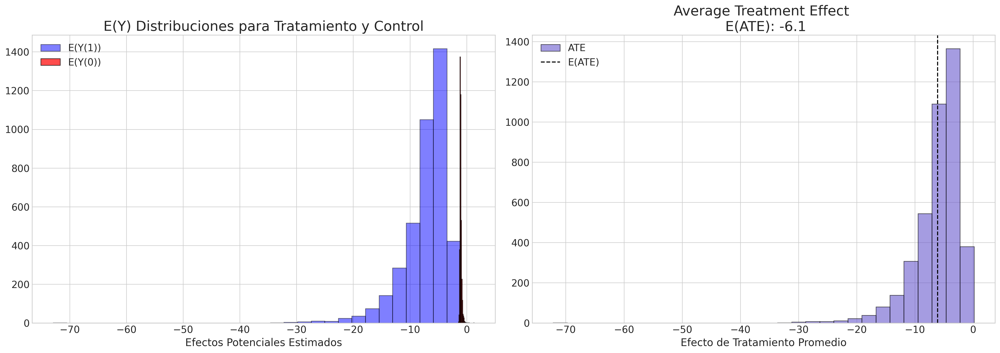

In [51]:
plot_ate(ate_dist_df_logit_r)

In [52]:
ate_dist = [get_ate(X, t, y, q, idata_logit, method="doubly_robust") for q in qs]
ate_dist_df_logit_dr = pd.DataFrame(ate_dist, columns=["ATE", "E(Y(1))", "E(Y(0))"])
ate_dist_df_logit_dr.head()

,ATE,E(Y(1)),E(Y(0))
0,-2.209869,-3.353121,-1.143251
1,-5.942509,-7.097203,-1.154693
2,-4.373360,-5.557614,-1.184254
3,-1.636585,-2.708921,-1.072337
4,-1.496350,-2.623111,-1.126761


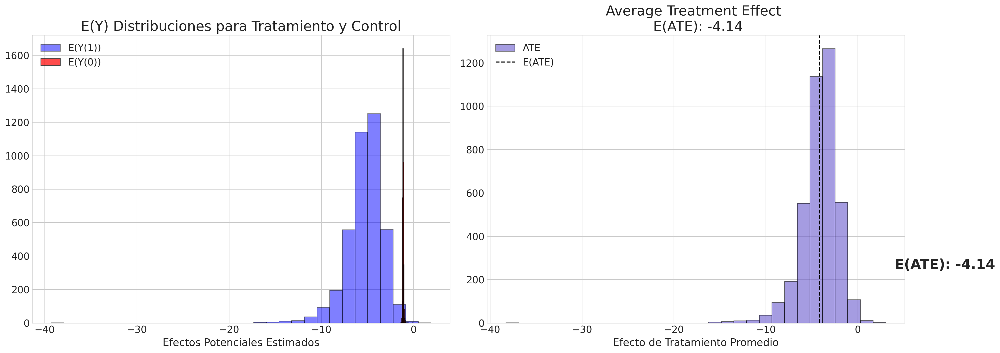

In [53]:
plot_ate(ate_dist_df_logit_dr)

### El modelo de Propensity BART


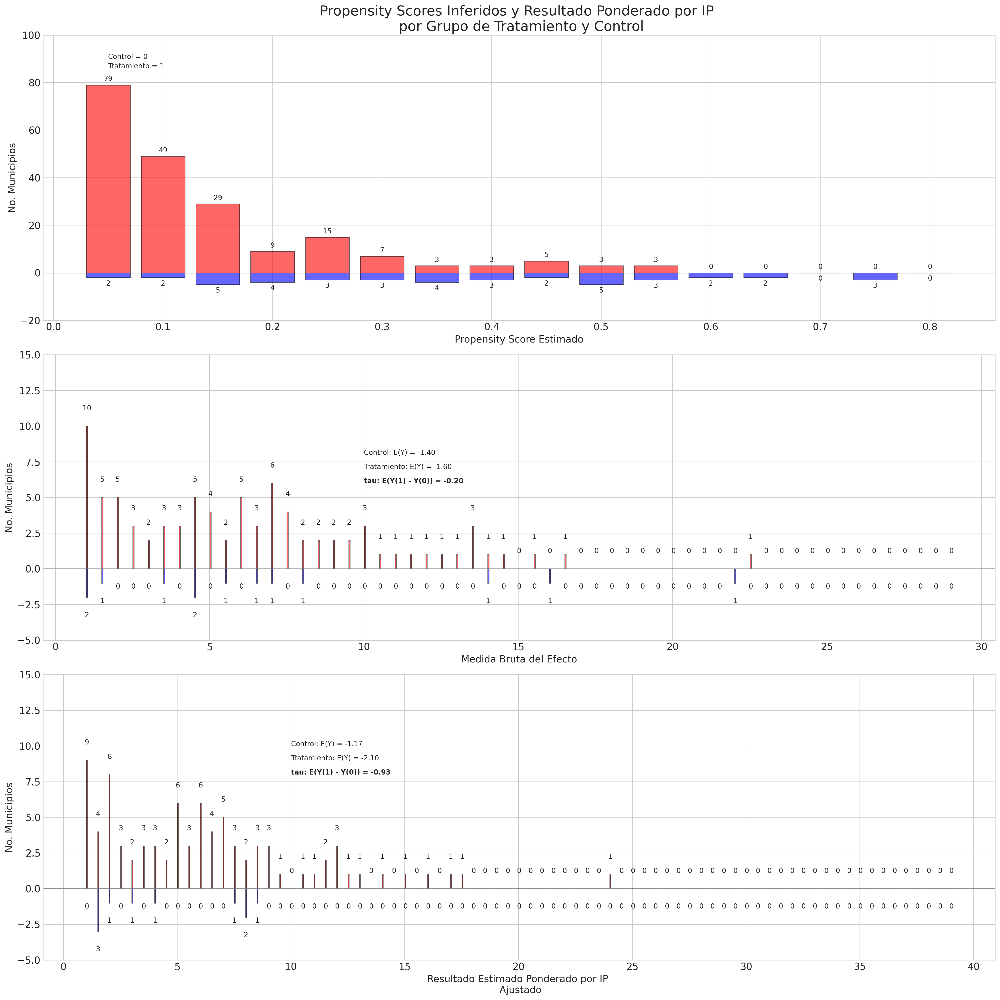

In [54]:
make_plot(
    X,                
    idata_probit,     
    method="robust",     
    ylims=[(-20, 100), (-5, 15), (-5, 15)],
    lower_bins=[
        np.arange(1, 30, 0.5),  
        np.arange(1, 40, 0.5),  
    ]
)

### Estimación de la distribución posterior de la ATE a partir de la reponderación con puntuaciones de propensión basadas en BART

In [55]:
ate_dist_probit_r = [
    get_ate(X, t, y, q, idata_probit, method="robust")  
    for q in qs  
]

ate_dist_df_probit_r = pd.DataFrame(
    ate_dist_probit_r, 
    columns=["ATE", "E(Y(1))", "E(Y(0))"]
)

ate_dist_df_probit_r.head()

,ATE,E(Y(1)),E(Y(0))
0,-1.199909,-2.326568,-1.126659
1,-0.344413,-1.538886,-1.194473
2,-0.030232,-1.282632,-1.252400
3,-1.771241,-2.939799,-1.168558
4,0.075161,-1.182991,-1.258152


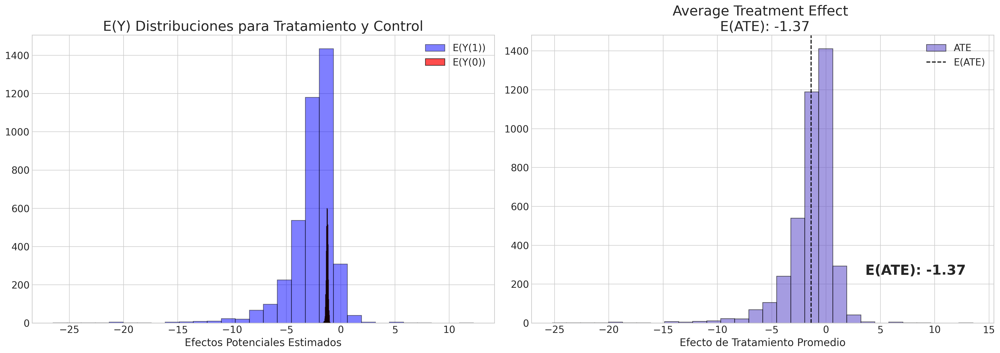

In [56]:
plot_ate(
    ate_dist_df_probit_r,  
    xy=(3.6, 250)         
)

In [57]:
ate_dist_probit_dr = [
    get_ate(X, t, y, q, idata_probit, method="doubly_robust")  
    for q in qs  
]

ate_dist_df_probit_dr = pd.DataFrame(
    ate_dist_probit_dr, 
    columns=["ATE", "E(Y(1))", "E(Y(0))"]
)

ate_dist_df_probit_dr.head()

,ATE,E(Y(1)),E(Y(0))
0,-2.504919,-3.443202,-0.938283
1,-1.640793,-2.838449,-1.197656
2,-1.194644,-2.466874,-1.272230
3,-2.343255,-3.632468,-1.289213
4,-1.133501,-2.469389,-1.335889


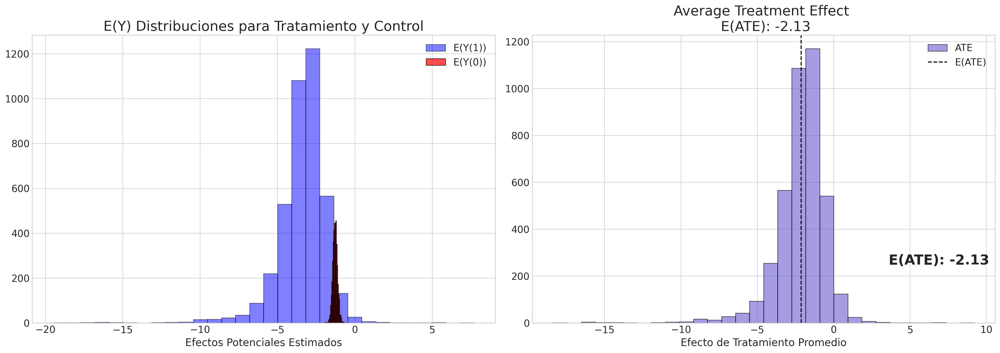

In [58]:
plot_ate(
    ate_dist_df_probit_dr,  
    xy=(3.6, 250)         
)

### Controles predictivos posteriores: efectos heterogéneos

Text(0.5, 0.98, 'Posterior Predictive Checks - Heterogeneous Effects')

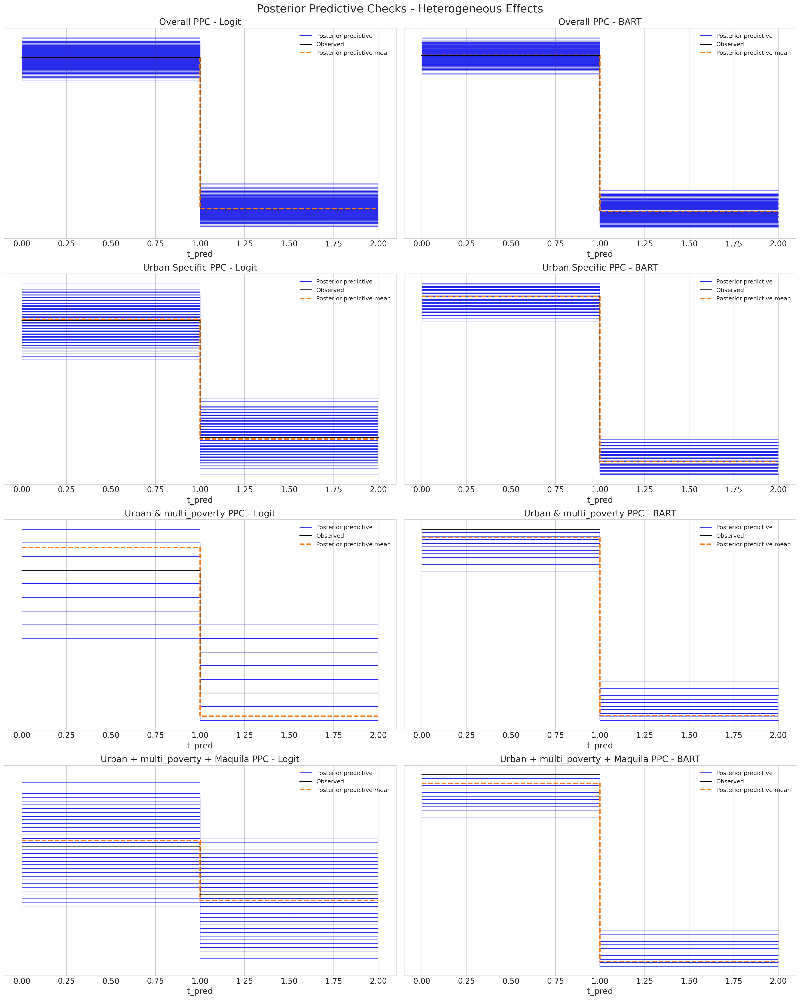

In [59]:
fig, axs = plt.subplots(4, 2, figsize=(20, 25))
axs = axs.flatten()

az.plot_ppc(idata_logit, ax=axs[0])
az.plot_ppc(idata_probit, ax=axs[1])

idx1 = list(X[X["urban"] == 1].index.values)  
idx0 = list(X[X["urban"] == 0].index.values)  

if idx1:
    az.plot_ppc(idata_logit, ax=axs[2], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[3], coords={"obs": idx0})

idx1 = list(X[(X["urban"] == 1) & (X["multi_poverty"] == 1)].index.values)
idx0 = list(X[(X["urban"] == 0) & (X["multi_poverty"] == 1)].index.values)

if idx1:
    az.plot_ppc(idata_logit, ax=axs[4], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[5], coords={"obs": idx0})

# PPC by urban & multi-dimensional poverty & maquila
idx1 = list(X[(X["urban"] == 1) & (X["multi_poverty"] == 0) & (X["maquila"] == 1)].index.values)
idx0 = list(X[(X["urban"] == 0) & (X["multi_poverty"] == 1) & (X["maquila"] == 0)].index.values)

if idx1:
    az.plot_ppc(idata_logit, ax=axs[6], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[7], coords={"obs": idx0})

# Set titles for each subplot
axs[0].set_title("Overall PPC - Logit")
axs[1].set_title("Overall PPC - BART")
axs[2].set_title("Urban Specific PPC - Logit")
axs[3].set_title("Urban Specific PPC - BART")
axs[4].set_title("Urban & multi_poverty PPC - Logit")
axs[5].set_title("Urban & multi_poverty PPC - BART")
axs[6].set_title("Urban + multi_poverty + Maquila PPC - Logit")
axs[7].set_title("Urban + multi_poverty + Maquila PPC - BART")

plt.suptitle("Posterior Predictive Checks - Heterogeneous Effects", fontsize=20)

## Otros modelos para inferencia causal de todos los municipios basado en Propensity Score mediante Logit y BART

### Regression

In [60]:
def make_prop_reg_model(X, t, y, idata_ps, covariates=None, samples=1000):
    ### Note the simplification for specifying the mean estimate in the regression
    ### rather than post-processing the whole posterior
    ps = idata_ps["posterior"]["p"].mean(dim=("chain", "draw")).values
    X_temp = pd.DataFrame({"ps": ps, "trt": t, "trt*ps": t * ps})
    if covariates is None:
        X = X_temp
    else:
        X = pd.concat([X_temp, X[covariates]], axis=1)
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model_ps_reg:
        sigma = pm.HalfNormal("sigma", 1)
        b = pm.Normal("b", mu=0, sigma=1, dims="coeffs")
        X = pm.MutableData("X", X)
        mu = pm.math.dot(X, b)
        y_pred = pm.Normal("pred", mu, sigma, observed=y, dims="obs")

        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(samples, idata_kwargs={"log_likelihood": True}))
        idata.extend(pm.sample_posterior_predictive(idata))
    return model_ps_reg, idata

### Propensity Score Logit

In [61]:
model_ps_reg_logit, idata_ps_reg_logit = make_prop_reg_model(X, t, y, idata_logit)

Sampling: [b, pred, sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sigma, b]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 14 seconds.
Sampling: [pred]


In [62]:
az.summary(idata_ps_reg_logit, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],0.043,0.916,-1.741,1.809,0.012,0.014,6009.0,3252.0,1.0
b[trt],-0.682,0.785,-2.233,0.824,0.010,0.009,6251.0,3112.0,1.0
b[trt*ps],0.005,0.975,-1.997,1.852,0.012,0.016,6324.0,3145.0,1.0


### Propensity Score BART

In [63]:
model_ps_reg_bart, idata_ps_reg_bart = make_prop_reg_model(X, t, y, idata_probit)

Sampling: [b, pred, sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sigma, b]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 14 seconds.
Sampling: [pred]


In [64]:
az.summary(idata_ps_reg_bart, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],-0.367,0.913,-2.262,1.322,0.012,0.012,6177.0,3296.0,1.0
b[trt],-0.587,0.772,-2.039,0.952,0.010,0.009,5777.0,3504.0,1.0
b[trt*ps],-0.162,0.966,-1.979,1.861,0.012,0.014,7030.0,3736.0,1.0


Este modelo es claramente demasiado simple. Solo recupera la estimación sesgada debido a la especificación incorrecta del modelo de propensión BART, pero ¿qué sucedería si simplemente usáramos la propensión como otra característica en nuestro perfil de covariables? Permitamos que añada precisión, pero ajustemos el modelo que creemos que refleja la historia causal.

Logit

In [65]:
model_ps_reg_h_logit, idata_ps_reg_h_logit = make_prop_reg_model(
    X,
    t,
    y,
    idata_logit,
    covariates=["informal","imssissste_incr","pea_incr"]
)

Sampling: [b, pred, sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sigma, b]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
Sampling: [pred]


In [66]:
az.summary(idata_ps_reg_h_logit, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],1.020,0.944,-0.812,2.890,0.014,0.011,4541.0,3076.0,1.0
b[trt],-0.174,0.753,-1.675,1.237,0.011,0.011,5046.0,3438.0,1.0
b[trt*ps],0.155,0.985,-1.858,1.992,0.014,0.015,4934.0,3141.0,1.0
b[informal],-0.017,0.008,-0.032,-0.001,0.000,0.000,3556.0,3331.0,1.0
b[imssissste_incr],-0.263,0.078,-0.412,-0.114,0.001,0.001,4416.0,3353.0,1.0
b[pea_incr],-0.685,0.155,-0.981,-0.384,0.002,0.002,4635.0,3134.0,1.0


BART

In [67]:
model_ps_reg_h_bart, idata_ps_reg_h_bart = make_prop_reg_model(
    X,
    t,
    y,
    idata_probit,
    covariates=["informal","imssissste_incr","pea_incr"]
)

Sampling: [b, pred, sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sigma, b]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
Sampling: [pred]


In [68]:
az.summary(idata_ps_reg_h_bart, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],0.484,0.939,-1.205,2.426,0.015,0.012,4193.0,3507.0,1.0
b[trt],-0.115,0.770,-1.681,1.334,0.011,0.011,4606.0,3473.0,1.0
b[trt*ps],-0.024,0.947,-1.857,1.824,0.014,0.013,4686.0,3057.0,1.0
b[informal],-0.016,0.008,-0.030,0.000,0.000,0.000,3654.0,3572.0,1.0
b[imssissste_incr],-0.262,0.080,-0.413,-0.100,0.001,0.001,4674.0,3324.0,1.0
b[pea_incr],-0.692,0.155,-0.990,-0.380,0.002,0.002,3918.0,2627.0,1.0


### Inferencia causal como regresión con imputación del efecto potencial

In [69]:
X_mod = X.copy()
X_mod["ps"] = ps = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 1
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_logit:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_trt = pm.sample_posterior_predictive(idata_ps_reg_logit)  

idata_trt

X_mod = X.copy()
X_mod["ps"] = ps = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 0
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_logit:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_ntrt = pm.sample_posterior_predictive(idata_ps_reg_logit) 

idata_ntrt

idata_trt["posterior_predictive"]["pred"].mean()
idata_ntrt["posterior_predictive"]["pred"].mean()
idata_trt["posterior_predictive"]["pred"].mean() - idata_ntrt["posterior_predictive"]["pred"].mean()

Sampling: [pred]


Sampling: [pred]


<xarray.DataArray 'pred' ()>
array(-0.68140326)

In [70]:
X_mod = X.copy()
X_mod["ps"] = ps = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 1
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_bart:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_trt = pm.sample_posterior_predictive(idata_ps_reg_bart)  

idata_trt

X_mod = X.copy()
X_mod["ps"] = ps = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 0
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_bart:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_ntrt = pm.sample_posterior_predictive(idata_ps_reg_bart) 

idata_ntrt

idata_trt["posterior_predictive"]["pred"].mean()
idata_ntrt["posterior_predictive"]["pred"].mean()
idata_trt["posterior_predictive"]["pred"].mean() - idata_ntrt["posterior_predictive"]["pred"].mean()

Sampling: [pred]


Sampling: [pred]


<xarray.DataArray 'pred' ()>
array(-0.60477157)

## Aplicando aprendizaje automático (Double/Debiased Machine Learning) y Frisch-Waugh-Lovell

### Evitando sobreajuste con K-fold Cross Validation

In [71]:
dummies = pd.concat(
    [
        pd.get_dummies(dat["state"], drop_first=True, prefix="state"),
    ],
    axis=1,
) 
train_dfs = []
temp = pd.concat([dat[["maquila","multi_poverty","urban","informal", "imssissste","health","lpopulation","imssissste_incr", "pea_incr"]], 
                  dummies["state_19"]], axis=1)

for i in range(4):
    idx = temp.sample(60, random_state=100).index
    X = temp.iloc[idx].copy()
    t = dat.iloc[idx]["trt"]
    y = dat.iloc[idx]["outcome"]
    train_dfs.append([X, t, y])
    remaining = [True if not i in idx else False for i in temp.index]
    temp = temp[remaining]
    temp.reset_index(inplace=True, drop=True)

### Aplicación del método sin sesgo


In [72]:
def train_outcome_model(X, y, m=50):
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model:
        X_data = pm.MutableData("X", X)
        y_data = pm.MutableData("y_data", y)
        mu = pmb.BART("mu", X_data, y, m=m)
        sigma = pm.HalfNormal("sigma", 1)
        obs = pm.Normal("obs", mu, sigma, observed=y_data)
        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(1000, progressbar=False))
    return model, idata


def train_propensity_model(X, t, m=50):
    coords = {"coeffs": list(X.columns), "obs_id": range(len(X))}
    with pm.Model(coords=coords) as model_ps:
        X_data = pm.MutableData("X", X)
        t_data = pm.MutableData("t_data", t)
        mu = pmb.BART("mu", X_data, t, m=m)
        p = pm.Deterministic("p", pm.math.invlogit(mu))
        t_pred = pm.Bernoulli("obs", p=p, observed=t_data)
        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(1000, progressbar=False))
    return model_ps, idata


def cross_validate(train_dfs, test_idx):
    test = train_dfs[test_idx]
    test_X = test[0]
    test_t = test[1]
    test_y = test[2]
    train_X = pd.concat([train_dfs[i][0] for i in range(4) if i != test_idx])
    train_t = pd.concat([train_dfs[i][1] for i in range(4) if i != test_idx])
    train_y = pd.concat([train_dfs[i][2] for i in range(4) if i != test_idx])

    model, idata = train_outcome_model(train_X, train_y)
    with model:
        pm.set_data({"X": test_X, "y_data": test_y})
        idata_pred = pm.sample_posterior_predictive(idata)
    y_resid = idata_pred["posterior_predictive"]["obs"].stack(z=("chain", "draw")).T - test_y.values

    model_t, idata_t = train_propensity_model(train_X, train_t)
    with model_t:
        pm.set_data({"X": test_X, "t_data": test_t})
        idata_pred_t = pm.sample_posterior_predictive(idata_t)
    t_resid = (
        idata_pred_t["posterior_predictive"]["obs"].stack(z=("chain", "draw")).T - test_t.values
    )

    return y_resid, t_resid, idata_pred, idata_pred_t


y_resids = []
t_resids = []
model_fits = {}
for i in range(4):
    y_resid, t_resid, idata_pred, idata_pred_t = cross_validate(train_dfs, i)
    y_resids.append(y_resid)
    t_resids.append(t_resid)
    t_effects = []
    for j in range(1000):
        intercept = np.ones_like(1000)
        covariates = pd.DataFrame({"intercept": intercept, "t_resid": t_resid[j, :].values})
        m0 = sm.OLS(y_resid[j, :].values, covariates).fit()
        t_effects.append(m0.params["t_resid"])
    model_fits[i] = [m0, t_effects]
    print(f"Estimated Treatment Effect in K-fold {i}: {np.mean(t_effects)}")

Sampling: [mu, obs, sigma]
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>PGBART: [mu]
>NUTS: [sigma]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 55 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs]
Multiprocess sampling (4 chains in 4 jobs)
PGBART: [mu]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 65 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs, sigma]


Estimated Treatment Effect in K-fold 0: -1.9893832052249922


Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>PGBART: [mu]
>NUTS: [sigma]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 56 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs]
Multiprocess sampling (4 chains in 4 jobs)
PGBART: [mu]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 61 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs, sigma]


Estimated Treatment Effect in K-fold 1: 0.22312450358479988


Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>PGBART: [mu]
>NUTS: [sigma]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 56 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs]
Multiprocess sampling (4 chains in 4 jobs)
PGBART: [mu]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 62 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs, sigma]


Estimated Treatment Effect in K-fold 2: 1.34381834223746


Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>PGBART: [mu]
>NUTS: [sigma]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 56 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Sampling: [mu, obs]
Multiprocess sampling (4 chains in 4 jobs)
PGBART: [mu]
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 63 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [mu, obs]


Estimated Treatment Effect in K-fold 3: -1.0615400229085923


In [73]:
y_resids_stacked = xr.concat(y_resids, dim=("obs_dim_2"))
t_resids_stacked = xr.concat(t_resids, dim=("obs_dim_2"))

y_resids_stacked

<xarray.DataArray 'obs' (z: 4000, obs_dim_2: 240)>
array([[  5.33819226,   1.20565025,  11.87759573, ...,   2.36473927,
          1.31503194,  13.04398648],
       [ -9.19062543, -14.46931493,  11.89500343, ...,   3.0843266 ,
        -11.42150367,  10.12567159],
       [ 15.28748775,  17.781776  ,  12.34729002, ...,  -1.96630275,
        -16.81673545,  11.20796845],
       ...,
       [  3.97242173,   3.65807153,   7.8447433 , ...,  -2.32714118,
         -2.7514011 ,   6.55114919],
       [  6.6224424 ,  -0.2281635 ,  13.71328266, ...,  -1.49974102,
          2.40461199,  12.25711197],
       [ -8.17810111,  -0.96587558,  -0.06621653, ...,  -5.67484372,
         -3.59779606,   0.47816984]])
Coordinates:
  * obs_dim_2  (obs_dim_2) int32 0 1 2 3 4 5 6 7 8 ... 52 53 54 55 56 57 58 59
  * z          (z) object MultiIndex
  * chain      (z) int64 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 3 3 3 3 3 3 3 3 3 3 3 3 3
  * draw       (z) int64 0 1 2 3 4 5 6 7 8 ... 992 993 994 995 996 997 998 999

In [74]:
t_effects = []
intercepts = []
for i in range(4000):
    intercept = np.ones_like(4000)
    covariates = pd.DataFrame({"intercept": intercept, "t_resid": t_resids_stacked[i, :].values})
    m0 = sm.OLS(y_resids_stacked[i, :].values, covariates).fit()
    t_effects.append(m0.params["t_resid"])
    intercepts.append(m0.params["intercept"])

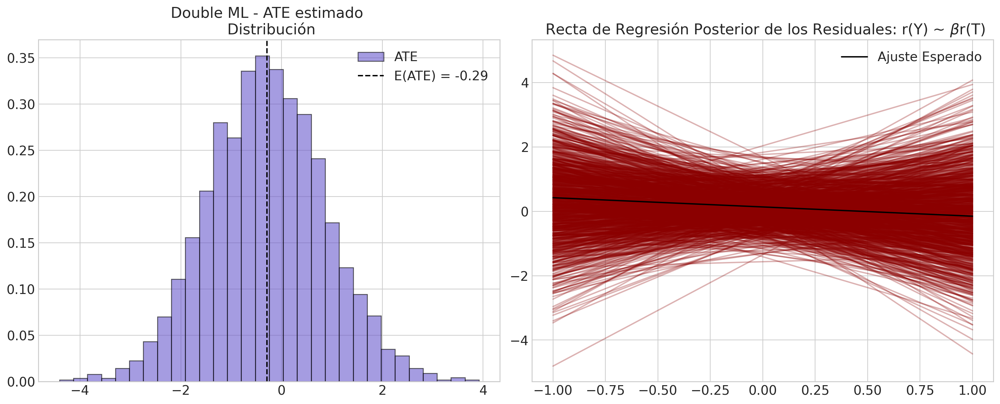

In [75]:
fig, axs = plt.subplots(1, 2, figsize=(15, 6))
axs = axs.flatten()
axs[0].hist(t_effects, bins=30, ec="black", color="slateblue", label="ATE", density=True, alpha=0.6)
x = np.linspace(-1, 1, 10)
for i in range(1000):
    axs[1].plot(x, intercepts[i] + t_effects[i] * x, color="darkred", alpha=0.3)

axs[0].set_title("Double ML - ATE estimado \n Distribución")
axs[1].set_title(r" Recta de Regresión Posterior de los Residuales: r(Y) ~ $\beta$r(T)")
ate = np.mean(t_effects)
axs[0].axvline(ate, color="black", linestyle="--", label=f"E(ATE) = {np.round(ate, 2)}")
axs[1].plot(x, np.mean(intercepts) + np.mean(t_effects) * x, color="black", label="Ajuste Esperado")
axs[1].legend()
axs[0].legend();

### Efecto de Tratamiento Condicional Promedio (CATE)

In [76]:
def make_cate(y_resids_stacked, t_resids_stacked, train_dfs, i, method="forest"):
    train_X = pd.concat([train_dfs[i][0] for i in range(4)])
    train_t = pd.concat([train_dfs[i][1] for i in range(4)])

    df_cate = pd.DataFrame(
        {"y_r": y_resids_stacked[i, :].values, "t_r": t_resids_stacked[i, :].values}
    )
    df_cate["target"] = df_cate["y_r"] / np.where(
        df_cate["t_r"] == 0, df_cate["t_r"] + 1e-25, df_cate["t_r"]
    )
    df_cate["weight"] = df_cate["t_r"] ** 2
    train_X.reset_index(drop=True, inplace=True)
    train_t.reset_index(drop=True, inplace=True)
    if method == "forest":
        CATE_model = RandomForestRegressor()
        CATE_model.fit(train_X, df_cate["target"], sample_weight=df_cate["weight"])
    elif method == "gradient":
        CATE_model = GradientBoostingRegressor()
        CATE_model.fit(train_X, df_cate["target"], sample_weight=df_cate["weight"])
    else:
        CATE_model = sm.WLS(df_cate["target"], train_X, weights=df_cate["weight"])
        CATE_model = CATE_model.fit()
    df_cate["CATE"] = CATE_model.predict(train_X)
    df_cate["t"] = train_t
    return df_cate

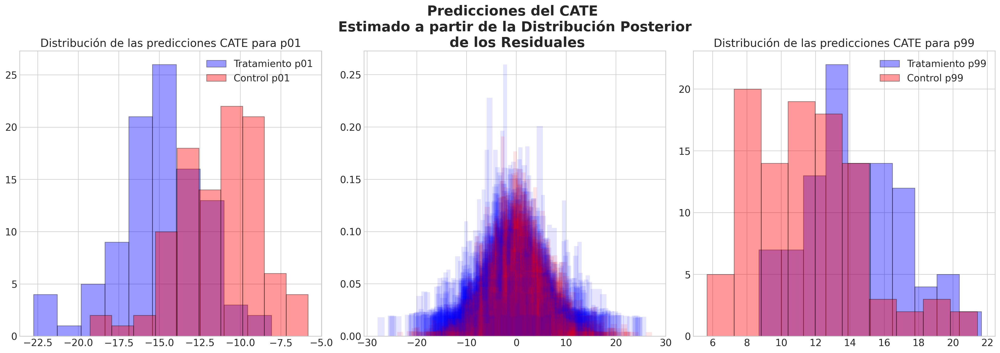

In [77]:
fig, axs = plt.subplots(1, 3, figsize=(20, 7))
axs = axs.flatten()

q_95 = []
for i in range(100):
    cate_df = make_cate(y_resids_stacked, t_resids_stacked, train_dfs, i)
    axs[1].hist(
        cate_df[cate_df["t"] == 0]["CATE"],
        bins=30,
        alpha=0.1,
        color="red",
        density=True,
    )
    q_95.append(
        [
            cate_df[cate_df["t"] == 0]["CATE"].quantile(0.99),
            cate_df[cate_df["t"] == 1]["CATE"].quantile(0.99),
            cate_df[cate_df["t"] == 0]["CATE"].quantile(0.01),
            cate_df[cate_df["t"] == 1]["CATE"].quantile(0.01),
        ]
    )
    axs[1].hist(cate_df[cate_df["t"] == 1]["CATE"], bins=30, alpha=0.1, color="blue", density=True)
axs[1].set_title(
    "Predicciones del CATE \n Estimado a partir de la Distribución Posterior \n de los Residuales", fontsize=20, fontweight="bold"
)

q_df = pd.DataFrame(q_95, columns=["Control_p99", "Treated_p99", "Control_p01", "Treated_p01"])
axs[2].hist(q_df["Treated_p99"], ec="black", color="blue", alpha=0.4, label="Tratamiento p99")
axs[2].hist(q_df["Control_p99"], ec="black", color="red", alpha=0.4, label="Control p99")
axs[2].legend()
axs[2].set_title("Distribución de las predicciones CATE para p99")
axs[0].hist(q_df["Treated_p01"], ec="black", color="blue", alpha=0.4, label="Tratamiento p01")
axs[0].hist(q_df["Control_p01"], ec="black", color="red", alpha=0.4, label="Control p01")
axs[0].legend()
axs[0].set_title("Distribución de las predicciones CATE para p01");

# Datos reducidos considerando municipios con Propensity Score entre 0.1 y 0.9

## Datos


In [90]:
dat = dat_trim.reset_index(drop=True)
dat.head()

,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome
0,2001,Baja California Ensenada,2,1,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021,increment moderate,decrement strong,1,-6.487502
1,2002,Baja California Mexicali,2,1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771,increment low,decrement low,1,-1.715072
2,2003,Baja California Tecate,2,1,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477,increment moderate,decrement moderate,1,-5.408627
3,2004,Baja California Tijuana,2,1,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466,increment low,decrement low,1,-0.402502
4,2005,Baja California Playas de Rosarito,2,1,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860,increment moderate,decrement moderate,1,-14.181250


In [91]:
dummies = pd.get_dummies(dat["state"], drop_first=False, prefix="state")
selected_columns = dat[[
    "LLAVE",
    "manufactur", 
    "maquila", 
    "multi_poverty", 
    "urban",
    "informal", 
    "imssissste", 
    "health", 
    "lpopulation", 
    "imssissste_incr",
    "pea_incr",
    "trt",
    "outcome"
]]
data = pd.concat([dummies, selected_columns], axis=1)
data.head()

,state_2,state_5,state_8,state_19,state_26,state_28,LLAVE,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,trt,outcome
0,1,0,0,0,0,0,2001,1,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021,1,-6.487502
1,1,0,0,0,0,0,2002,1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771,1,-1.715072
2,1,0,0,0,0,0,2003,1,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477,1,-5.408627
3,1,0,0,0,0,0,2004,1,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466,1,-0.402502
4,1,0,0,0,0,0,2005,1,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860,1,-14.181250


In [92]:
treatment = 'trt' 
outcome = 'outcome'
covariates = [
    'state_2','state_5','state_8','state_19',"state_26","state_28",# State dummies
    "manufactur", 
    "maquila", 
    "multi_poverty", 
    "urban",
    "informal", 
    "imssissste", 
    "health", 
    "lpopulation", 
    "imssissste_incr",
    "pea_incr",
    "trt",
    "outcome"
]
X = data[covariates]
T = data[treatment]
Y = data[outcome]

## Distribuciones y diferencias brutas (no ajustados) entre tratados y no tratados

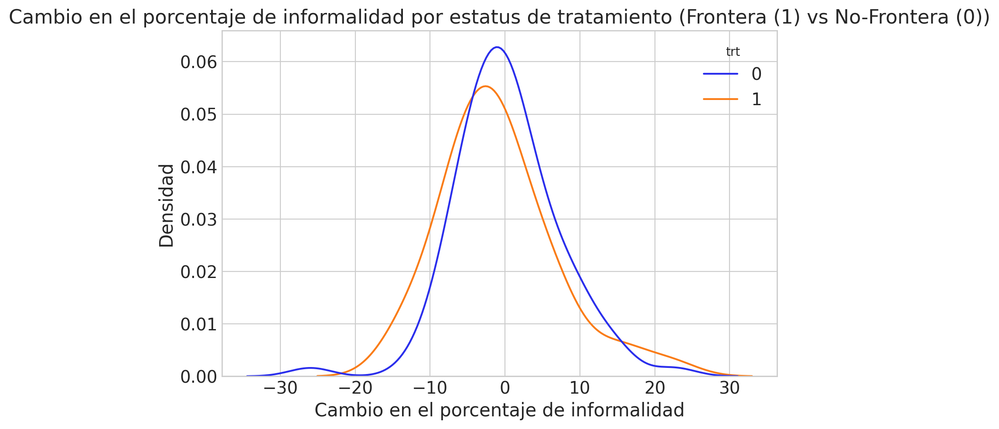

In [93]:
sns.kdeplot(data=data, x=outcome, hue=treatment, common_norm=False)
plt.title('Cambio en el porcentaje de informalidad por estatus de tratamiento (Frontera (1) vs No-Frontera (0))')
plt.xlabel('Cambio en el porcentaje de informalidad')
plt.ylabel('Densidad')
plt.show()

In [94]:
raw_diff = data.groupby("trt")[["outcome"]].mean()
print("Diferencia bruta en tratamiento:", raw_diff["outcome"].iloc[1] - raw_diff["outcome"].iloc[0])
raw_diff

Diferencia bruta en tratamiento: -1.2393508810650131


,outcome
trt,
0,0.261445
1,-0.977905


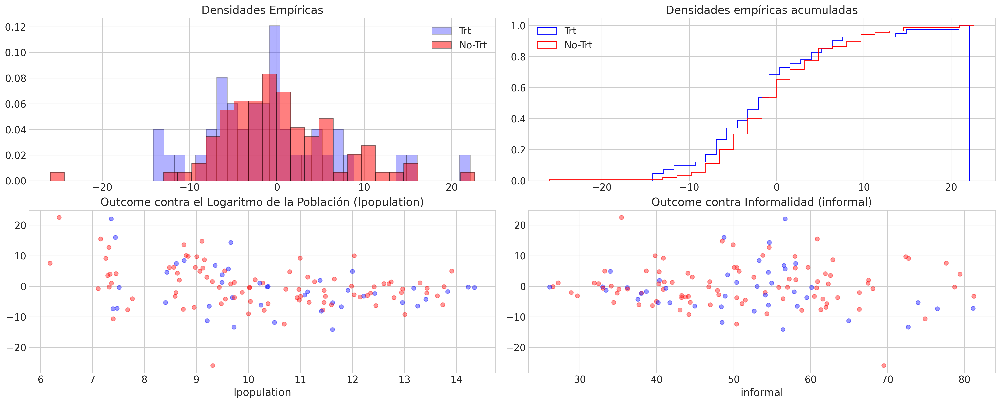

In [95]:
fig, axs = plt.subplots(2, 2, figsize=(20, 8))
axs = axs.flatten()
axs[0].hist(
    data[data["trt"] == 1]["outcome"],
    alpha=0.3,
    density=True,
    bins=30,
    label="Trt",
    ec="black",
    color="blue",
)
axs[0].hist(
    data[data["trt"] == 0]["outcome"],
    alpha=0.5,
    density=True,
    bins=30,
    label="No-Trt",
    ec="black",
    color="red",
)
axs[1].hist(
    data[data["trt"] == 1]["outcome"],
    density=True,
    bins=30,
    cumulative=True,
    histtype="step",
    label="Trt",
    color="blue",
)
axs[1].hist(
    data[data["trt"] == 0]["outcome"],
    density=True,
    bins=30,
    cumulative=True,
    histtype="step",
    label="No-Trt",
    color="red",
)
lkup = {1: "blue", 0: "red"}
axs[2].scatter(data["lpopulation"], data["outcome"], c=data["trt"].map(lkup), alpha=0.4)
axs[2].set_xlabel("lpopulation")
axs[3].scatter(data["informal"], data["outcome"], c=data["trt"].map(lkup), alpha=0.4)

axs[3].set_title("Outcome contra Informalidad (informal)")
axs[2].set_title("Outcome contra el Logaritmo de la Población (lpopulation)")
axs[3].set_xlabel("informal")
axs[0].set_title("Densidades Empíricas")
axs[0].legend()
axs[1].legend()
axs[1].set_title("Densidades empíricas acumuladas");

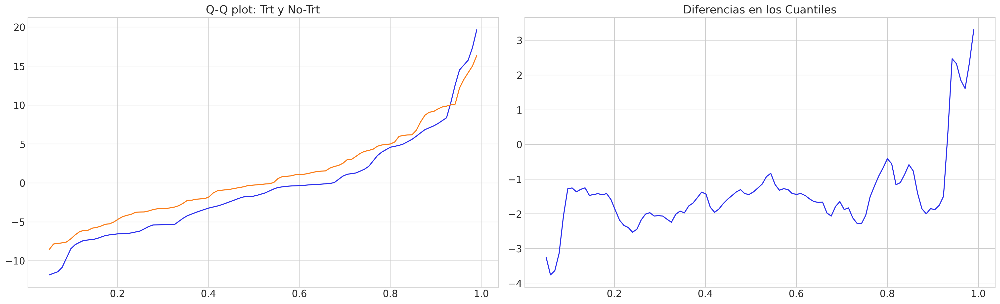

In [96]:
qs = np.linspace(0.05, 0.99, 100)
quantile_diff = (
    data.groupby("trt")[["outcome"]]
    .quantile(qs)
    .reset_index()
    .pivot(index="level_1", columns="trt", values="outcome")
    .rename({0: "Non-Trt", 1: "Trt"}, axis=1)
    .assign(diff=lambda x: x["Trt"] - x["Non-Trt"])
    .reset_index()
    .rename({"level_1": "quantile"}, axis=1)
)

fig, axs = plt.subplots(1, 2, figsize=(20, 6))
axs[0].plot(quantile_diff["quantile"], quantile_diff["Trt"])
axs[0].plot(quantile_diff["quantile"], quantile_diff["Non-Trt"])
axs[0].set_title("Q-Q plot: Trt y No-Trt")
axs[1].plot(quantile_diff["quantile"], quantile_diff["diff"])
axs[1].set_title("Diferencias en los Cuantiles");

## Diferencias en tratamiento ajustadas por caracteríticas y estatus de tratamiento (estratos)

### a) Primer criterio de estratos

In [97]:
strata_df = (
    data.groupby(
        [
            "trt",              # Tratamiento (0 = control, 1 = tratamiento)
            "urban",            # Urbano y rural (Urbano=1, rural=0)
            "maquila",          # Presencia importante de maquiladoras (si=1, no=0)
            "multi_poverty",   # Más del 50% de población en pobreza (si=1, no=0)
            "state_2",         # State: Baja California
            "state_5",         # State: Chihuahia
            "state_8",         # State: Coahuila
            "state_19",         # State: Nuevo Leon
            "state_26",         # State: Sonora
            "state_28",         # State: Tamaulipas
        ]
    )[["outcome"]]
    .agg(["count", "mean"])
)
global_avg = data["outcome"].mean()
strata_df["global_avg"] = global_avg
strata_df["diff"] = strata_df[("outcome", "mean")] - strata_df["global_avg"]
strata_df.reset_index(inplace=True)
strata_df.columns = [" ".join(col).strip() for col in strata_df.columns.values]
strata_df.style.background_gradient(axis=0)


,trt,urban,maquila,multi_poverty,state_2,state_5,state_8,state_19,state_26,state_28,outcome count,outcome mean,global_avg,diff
0,0,0,0,0,0,0,0,0,1,0,10,4.302265,-0.129427,4.431692
1,0,0,0,0,0,0,0,1,0,0,1,12.763229,-0.129427,12.892656
2,0,0,0,0,0,0,1,0,0,0,3,1.583198,-0.129427,1.712625
3,0,0,0,0,0,1,0,0,0,0,4,-6.228062,-0.129427,-6.098636
4,0,0,0,1,0,0,1,0,0,0,2,3.207372,-0.129427,3.336799
5,0,0,0,1,0,1,0,0,0,0,1,-2.001922,-0.129427,-1.872496
6,0,0,1,0,0,0,0,1,0,0,1,0.801005,-0.129427,0.930432
7,0,1,0,0,0,0,0,0,1,0,6,4.622373,-0.129427,4.751800
8,0,1,0,0,0,0,0,1,0,0,10,0.833666,-0.129427,0.963093
9,0,1,0,0,0,0,1,0,0,0,5,0.594749,-0.129427,0.724175


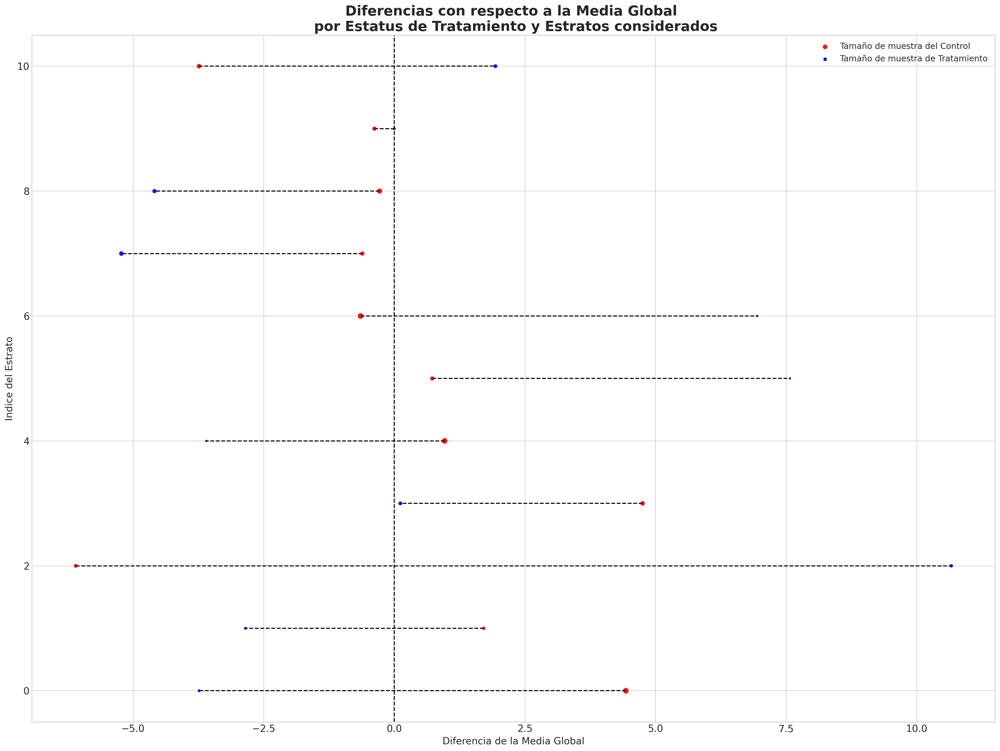

In [98]:
def make_strata_plot(strata_df):
    joined_df = strata_df[strata_df["trt"] == 0].merge(
        strata_df[strata_df["trt"] == 1],
        on=[
             "urban","maquila","multi_poverty",  "state_2",
            "state_5", "state_8",  "state_19", "state_26",  "state_28",
        ]
    )
    joined_df.sort_values("diff_y", inplace=True)

    def newline(p1, p2, color="black"):
        ax = plt.gca()
        line = mlines.Line2D([p1[0], p2[0]], [p1[1], p2[1]], color=color, linestyle="--")
        ax.add_line(line)
        return line

    fig, ax = plt.subplots(figsize=(20, 15))

    ax.scatter(
        joined_df["diff_x"],    
        joined_df.index,         
        color="red",
        alpha=0.9,
        label="Tamaño de muestra del Control",
        s=joined_df["outcome count_x"] * 5,
    )

    ax.scatter(
        joined_df["diff_y"],      
        joined_df.index,
        color="blue",
        alpha=0.9,
        label="Tamaño de muestra de Tratamiento",
        s=joined_df["outcome count_y"] * 5, 
    )

    for i, p1, p2 in zip(joined_df.index, joined_df["diff_x"], joined_df["diff_y"]):
        newline([p1, i], [p2, i])

    ax.set_xlabel("Diferencia de la Media Global", fontsize=14)
    ax.set_ylabel("Indice del Estrato", fontsize=14)
    ax.set_title(
        "Diferencias con respecto a la Media Global \n por Estatus de Tratamiento y Estratos considerados",
        fontsize=20,
        fontweight="bold",
    )

    ax.axvline(0, color="k", linestyle="--")
    ax.legend(fontsize=12)

make_strata_plot(strata_df)

In [99]:
strata_expected_df = strata_df.groupby("trt")[
    ["outcome count", "outcome mean", "diff"]
].agg({
    "outcome count": ["sum"],  
    "outcome mean": "mean",   
    "diff": "mean"   
})
print(
    "Diferencia de Tratamiento Ajustado 1:",
    strata_expected_df[("outcome mean", "mean")].iloc[1]  
    - strata_expected_df[("outcome mean", "mean")].iloc[0]  
)
strata_expected_df

Diferencia de Tratamiento Ajustado 1: -0.2401351280651401


,outcome count,outcome mean,diff
,sum,mean,mean
trt,,,
0,89,0.569723,0.699150
1,41,0.329588,0.459015


### a) Segundo criterio de estratos

Solamente cambiamos la variable "maquila" por "manufactur".

In [100]:
strata_df = (
    data.groupby(
        [
            "trt",             
            "urban",           
            "manufactur",         
            "multi_poverty",   
            "state_2",         
            "state_5",         
            "state_8",        
            "state_19",         
            "state_26",       
            "state_28",      
        ]
    )[["outcome"]]          
    .agg(["count", "mean"])   
)

global_avg = data["outcome"].mean()
strata_df["global_avg"] = global_avg
strata_df["diff"] = strata_df[("outcome", "mean")] - strata_df["global_avg"]
strata_df.reset_index(inplace=True)
strata_df.columns = [" ".join(col).strip() for col in strata_df.columns.values]
strata_df.style.background_gradient(axis=0)

,trt,urban,manufactur,multi_poverty,state_2,state_5,state_8,state_19,state_26,state_28,outcome count,outcome mean,global_avg,diff
0,0,0,0,0,0,0,0,0,1,0,10,4.302265,-0.129427,4.431692
1,0,0,0,0,0,0,0,1,0,0,2,6.782117,-0.129427,6.911544
2,0,0,0,0,0,0,1,0,0,0,2,6.148254,-0.129427,6.277681
3,0,0,0,0,0,1,0,0,0,0,2,-12.464612,-0.129427,-12.335185
4,0,0,0,1,0,0,1,0,0,0,2,3.207372,-0.129427,3.336799
5,0,0,0,1,0,1,0,0,0,0,1,-2.001922,-0.129427,-1.872496
6,0,0,1,0,0,0,1,0,0,0,1,-7.546915,-0.129427,-7.417488
7,0,0,1,0,0,1,0,0,0,0,2,0.008487,-0.129427,0.137914
8,0,1,0,0,0,0,0,0,1,0,6,3.715685,-0.129427,3.845112
9,0,1,0,0,0,0,0,1,0,0,6,1.645542,-0.129427,1.774969


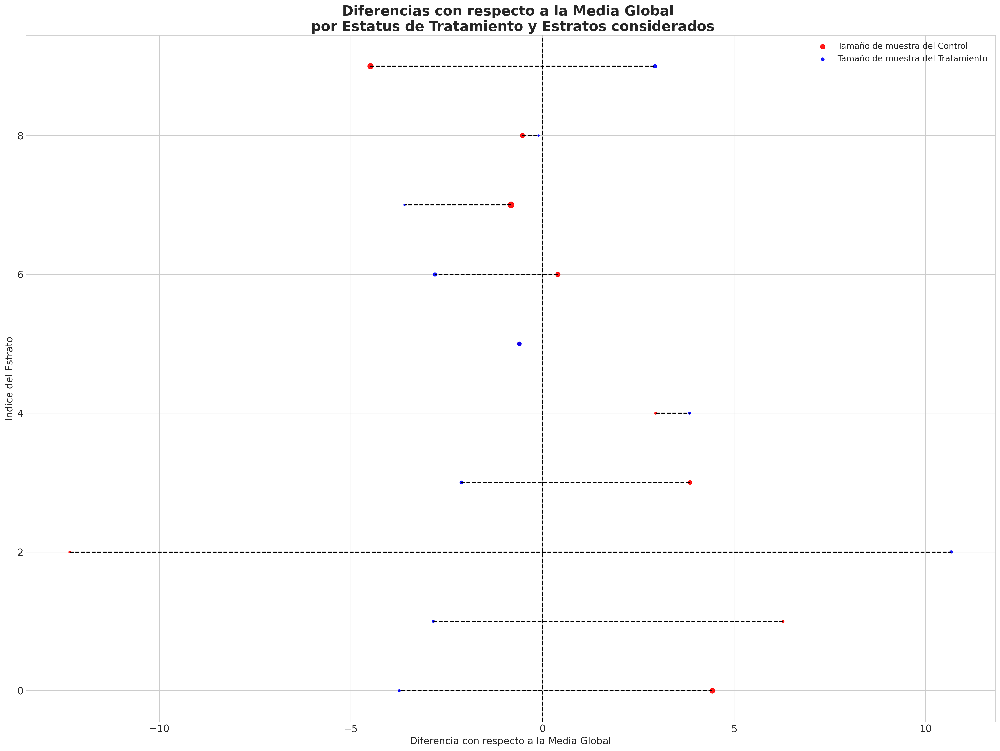

In [101]:
def make_strata_plot(strata_df):
    joined_df = strata_df[strata_df["trt"] == 0].merge(
        strata_df[strata_df["trt"] == 1],
        on=[
             "urban","manufactur","multi_poverty",  "state_2",
            "state_5", "state_8",  "state_19", "state_26",  "state_28",
        ]
    )
    joined_df.sort_values("diff_y", inplace=True)

    def newline(p1, p2, color="black"):
        ax = plt.gca()
        line = mlines.Line2D([p1[0], p2[0]], [p1[1], p2[1]], color=color, linestyle="--")
        ax.add_line(line)
        return line

    fig, ax = plt.subplots(figsize=(20, 15))

    ax.scatter(
        joined_df["diff_x"],       
        joined_df.index,           
        color="red",
        alpha=0.9,
        label="Tamaño de muestra del Control",
        s=joined_df["outcome count_x"] * 5,  
    )

    ax.scatter(
        joined_df["diff_y"],       
        joined_df.index,
        color="blue",
        alpha=0.9,
        label="Tamaño de muestra del Tratamiento",
        s=joined_df["outcome count_y"] * 5,  
    )

    for i, p1, p2 in zip(joined_df.index, joined_df["diff_x"], joined_df["diff_y"]):
        newline([p1, i], [p2, i])

    ax.set_xlabel("Diferencia con respecto a la Media Global", fontsize=14)
    ax.set_ylabel("Indice del Estrato", fontsize=14)
    ax.set_title(
        "Diferencias con respecto a la Media Global \n por Estatus de Tratamiento y Estratos considerados",
        fontsize=20,
        fontweight="bold",
    )
    ax.axvline(0, color="k", linestyle="--")
    ax.legend(fontsize=12)
make_strata_plot(strata_df)

In [102]:
strata_expected_df = strata_df.groupby("trt")[
    ["outcome count", "outcome mean", "diff"]
].agg({
    "outcome count": ["sum"],      
    "outcome mean": "mean",        
    "diff": "mean"                 
})

print(
    "Diferencia de Tratamiento Ajustado 2:",
    strata_expected_df[("outcome mean", "mean")].iloc[1]  
    - strata_expected_df[("outcome mean", "mean")].iloc[0] 
)

strata_expected_df

Diferencia de Tratamiento Ajustado 2: -1.1787666297597434


,outcome count,outcome mean,diff
,sum,mean,mean
trt,,,
0,89,0.150869,0.280296
1,41,-1.027897,-0.898471


### Preparando los datos para la modelación

In [103]:
X = data.copy()
y = data["outcome"]
t = data["trt"]
X = X.drop(["LLAVE","trt", "outcome","manufactur", "state_2", "state_5", "state_8","state_19", "state_26", "state_28"], axis=1)
X.head()

,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr
0,1,0,1,44.941117,80.477908,16.968802,13.252382,5.342235,-4.645021
1,1,0,1,38.635661,83.170333,17.021504,13.830386,1.166463,-0.482771
2,1,0,1,41.702882,82.648756,16.632699,11.616114,3.426807,-2.898477
3,1,0,1,36.177469,85.861896,24.205830,14.342304,0.635718,-1.030466
4,1,0,1,56.410941,75.087620,24.186013,11.614561,3.550476,-2.758860


### Modelación del Propensity Score

In [104]:
def make_propensity_model(X, t, bart=True, probit=True, samples=1000, m=50, random_seed=rng):
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model_ps:
        X_data = pm.MutableData("X", X)
        t_data = pm.MutableData("t", t)

        if bart:
            mu = pmb.BART("mu", X, t, m=m)
            if probit:
                p = pm.Deterministic("p", pm.math.invprobit(mu))
            else:
                p = pm.Deterministic("p", pm.math.invlogit(mu))
        else:
            b = pm.Normal("b", mu=0, sigma=1, dims="coeffs") 
            mu = pm.math.dot(X_data, b) 
            p = pm.Deterministic("p", pm.math.invlogit(mu))  
            
        t_pred = pm.Bernoulli("t_pred", p=p, observed=t_data, dims="obs")
        idata = pm.sample_prior_predictive(random_seed=rng)
        idata.extend(
            pm.sample(
                draws=samples, 
                init="adapt_diag", 
                random_seed=rng, 
                idata_kwargs={"log_likelihood": True}
            )
        )
        idata.extend(pm.sample_posterior_predictive(idata, random_seed=rng))
    return model_ps, idata

### Propensity Score Logit

In [105]:
m_ps_logit, idata_logit = make_propensity_model(X, t, bart=False, samples=4000, random_seed=rng)

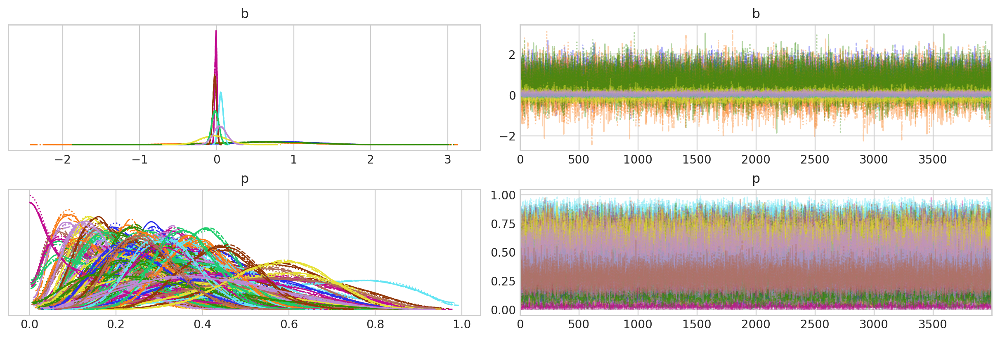

In [106]:
az.plot_trace(idata_logit, var_names=["b", "p"]);

### Propensity Score BART

In [107]:
m_ps_probit, idata_probit = make_propensity_model(X, t, bart=True, probit=True, samples=4000, random_seed=rng)

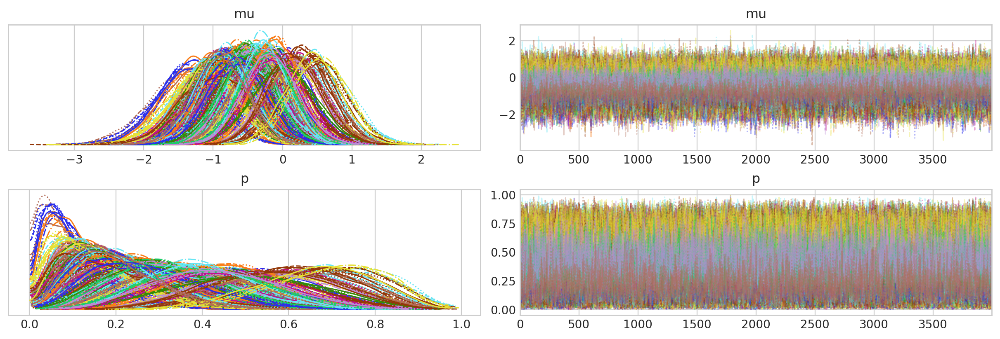

In [108]:
az.plot_trace(idata_probit, var_names=["mu", "p"]);

## Visualizaciones de las probabilidades de tratamiento a los municipios.

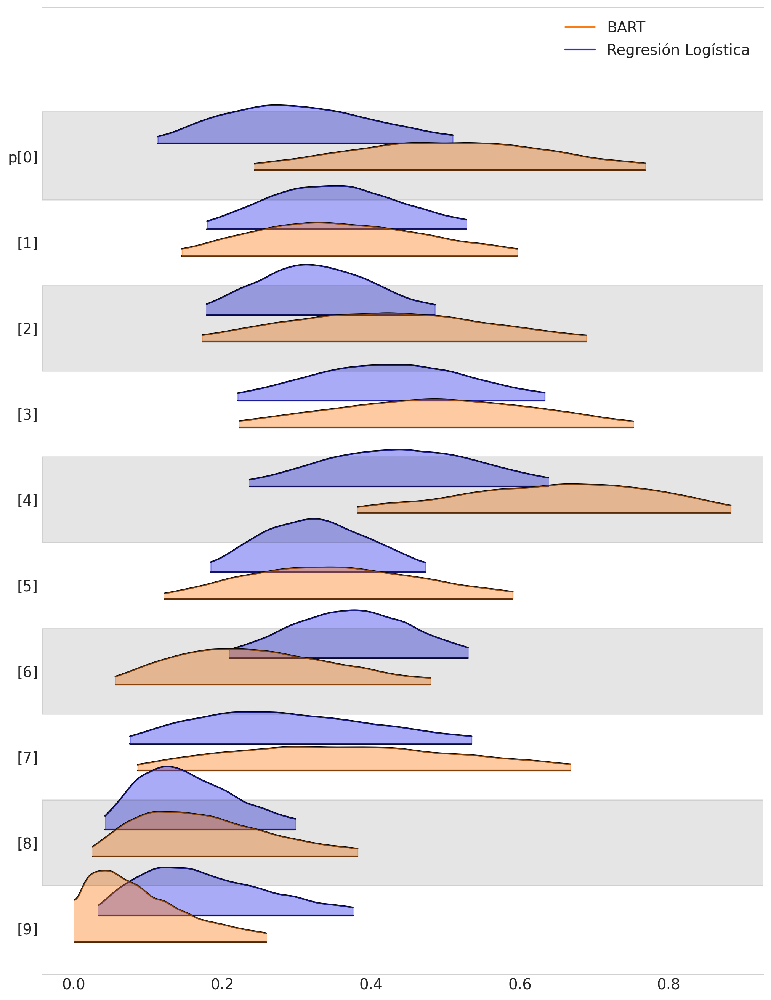

In [109]:
import arviz as az
import warnings
import os
warnings.filterwarnings("ignore")   

os.environ["NUMBA_DISABLE_JIT"] = "1"
az.rcParams["data.load"] = "eager" 
az.plot_forest(
    [idata_logit, idata_probit], 
    var_names=["p"],                     
    coords={"p_dim_0": range(10)},       
    figsize=(10, 13),                    
    combined=True,                   
    kind="ridgeplot",                     
    model_names=["Regresión Logística", "BART"],  
    r_hat=False,     
    ridgeplot_alpha=0.4,               
);

In [110]:
ps_logit = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).round(2)
ps_logit

<xarray.DataArray 'p' (p_dim_0: 130)>
array([0.31, 0.36, 0.33, 0.43, 0.44, 0.33, 0.38, 0.3 , 0.16, 0.19, 0.22,
       0.24, 0.17, 0.2 , 0.57, 0.2 , 0.22, 0.33, 0.34, 0.2 , 0.33, 0.25,
       0.29, 0.22, 0.26, 0.36, 0.32, 0.16, 0.35, 0.27, 0.42, 0.32, 0.32,
       0.42, 0.27, 0.48, 0.31, 0.32, 0.28, 0.14, 0.3 , 0.13, 0.29, 0.33,
       0.28, 0.21, 0.19, 0.39, 0.14, 0.37, 0.39, 0.38, 0.23, 0.15, 0.42,
       0.18, 0.35, 0.41, 0.16, 0.18, 0.33, 0.38, 0.29, 0.39, 0.26, 0.4 ,
       0.17, 0.2 , 0.35, 0.19, 0.31, 0.17, 0.35, 0.37, 0.18, 0.37, 0.32,
       0.2 , 0.23, 0.52, 0.3 , 0.25, 0.25, 0.52, 0.44, 0.3 , 0.25, 0.2 ,
       0.39, 0.29, 0.29, 0.38, 0.33, 0.53, 0.4 , 0.44, 0.24, 0.28, 0.31,
       0.4 , 0.25, 0.27, 0.31, 0.16, 0.56, 0.65, 0.35, 0.34, 0.16, 0.37,
       0.48, 0.26, 0.27, 0.45, 0.27, 0.39, 0.56, 0.37, 0.39, 0.54, 0.26,
       0.39, 0.3 , 0.33, 0.44, 0.32, 0.58, 0.36, 0.41, 0.27])
Coordinates:
  * p_dim_0  (p_dim_0) int32 0 1 2 3 4 5 6 7 ... 122 123 124 125 126 127 128 129

In [111]:
ps_probit = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).round(2)
ps_probit

<xarray.DataArray 'p' (p_dim_0: 130)>
array([0.51, 0.37, 0.43, 0.49, 0.64, 0.36, 0.26, 0.38, 0.19, 0.11, 0.22,
       0.26, 0.19, 0.34, 0.47, 0.37, 0.2 , 0.34, 0.28, 0.25, 0.11, 0.29,
       0.41, 0.4 , 0.2 , 0.44, 0.15, 0.21, 0.29, 0.22, 0.43, 0.37, 0.29,
       0.38, 0.17, 0.61, 0.42, 0.2 , 0.4 , 0.3 , 0.21, 0.22, 0.21, 0.19,
       0.24, 0.28, 0.45, 0.37, 0.17, 0.21, 0.29, 0.27, 0.2 , 0.18, 0.47,
       0.29, 0.27, 0.33, 0.17, 0.2 , 0.22, 0.12, 0.33, 0.24, 0.27, 0.35,
       0.21, 0.18, 0.18, 0.19, 0.1 , 0.19, 0.44, 0.35, 0.24, 0.18, 0.31,
       0.26, 0.27, 0.62, 0.4 , 0.16, 0.28, 0.25, 0.62, 0.15, 0.39, 0.22,
       0.22, 0.27, 0.22, 0.28, 0.3 , 0.3 , 0.31, 0.68, 0.15, 0.22, 0.33,
       0.17, 0.2 , 0.42, 0.18, 0.22, 0.67, 0.33, 0.16, 0.23, 0.32, 0.38,
       0.22, 0.23, 0.31, 0.57, 0.19, 0.21, 0.55, 0.32, 0.55, 0.58, 0.28,
       0.46, 0.51, 0.46, 0.56, 0.4 , 0.68, 0.41, 0.44, 0.2 ])
Coordinates:
  * p_dim_0  (p_dim_0) int32 0 1 2 3 4 5 6 7 ... 122 123 124 125 126 127 128 129

### Municipios con Propensity Score extremos

In [112]:
ps_logit_series = pd.Series(ps_logit.values, index=dat.index)
ps_probit_series = pd.Series(ps_probit.values, index=dat.index)

extremely_low_logit = dat.loc[ps_logit_series < 0.1]
extremely_high_logit = dat.loc[ps_logit_series > 0.9]

extremely_low_bart = dat.loc[ps_probit_series < 0.1]
extremely_high_bart = dat.loc[ps_probit_series > 0.9]
dat_trim = dat.loc[(ps_probit_series > 0.1) & (ps_probit_series < 0.9)]

print("Logistic Model:")
print(f"p < 0.1: {len(extremely_low_logit)} municipalities")
print(f"p > 0.9: {len(extremely_high_logit)} municipalities\n")

print("BART Model:")
print(f"p < 0.1: {len(extremely_low_bart)} municipalities")
print(f"p > 0.9: {len(extremely_high_bart)} municipalities")

Logistic Model:
p < 0.1: 0 municipalities
p > 0.9: 0 municipalities

BART Model:
p < 0.1: 0 municipalities
p > 0.9: 0 municipalities


In [113]:
print("Municipalities with p < 0.1 (Logit):")
display(extremely_low_logit)

print("\nMunicipalities with p > 0.9 (Logit):")
display(extremely_high_logit)

print("\nMunicipalities with p < 0.1 (BART):")
display(extremely_low_bart)

print("\nMunicipalities with p > 0.9 (BART):")
display(extremely_high_bart)

Municipalities with p < 0.1 (Logit):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome



Municipalities with p > 0.9 (Logit):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome



Municipalities with p < 0.1 (BART):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome



Municipalities with p > 0.9 (BART):


,LLAVE,municipality_name,state,manufactur,maquila,multi_poverty,urban,informal,imssissste,health,lpopulation,imssissste_incr,pea_incr,imssissste_incr_clasif,pea_incr_clasif,trt,outcome


###  Mapas

In [114]:
geo = pd.read_excel("georef-mexico-municipality-millesime@public.xlsx")
print(geo.columns)

Index(['Geo Point', 'Geo Shape', 'Year', 'State code', 'State name',
       'Municipality code', 'Municipality name', 'ISO 3166-3 Area code',
       'Type'],
      dtype='object')


In [115]:
print(geo["Municipality code"].head())

0    7016
1    7036
2    7050
3    7067
4    7114
Name: Municipality code, dtype: int64


In [116]:
geo["LLAVE"] = geo["Municipality code"].astype(str).str.zfill(5)

In [117]:
geo[['lat', 'lon']] = geo["Geo Point"].str.extract(r"\(?\s*([-\d.]+),\s*([-\d.]+)\s*\)?").astype(float)

In [118]:
geo["geometry"] = geo.apply(lambda row: Point(row["lon"], row["lat"]), axis=1)

In [119]:
gdf = gpd.GeoDataFrame(geo, geometry="geometry", crs="EPSG:4326")

In [120]:
data["LLAVE"] = data["LLAVE"].astype(str).str.zfill(5)
data["ps_logit"] = ps_logit_series

In [121]:
gdf = gdf.merge(data[["LLAVE", "ps_logit"]], on="LLAVE", how="left")

In [122]:
def classify_propensity(p):
    if pd.isnull(p):
        return "No data"
    elif p < 0.1:
        return "Low (<0.1)"
    elif p > 0.9:
        return "High (>0.9)"
    else:
        return "Mid (0.1–0.9)"
gdf["ps_group"] = gdf["ps_logit"].apply(classify_propensity)

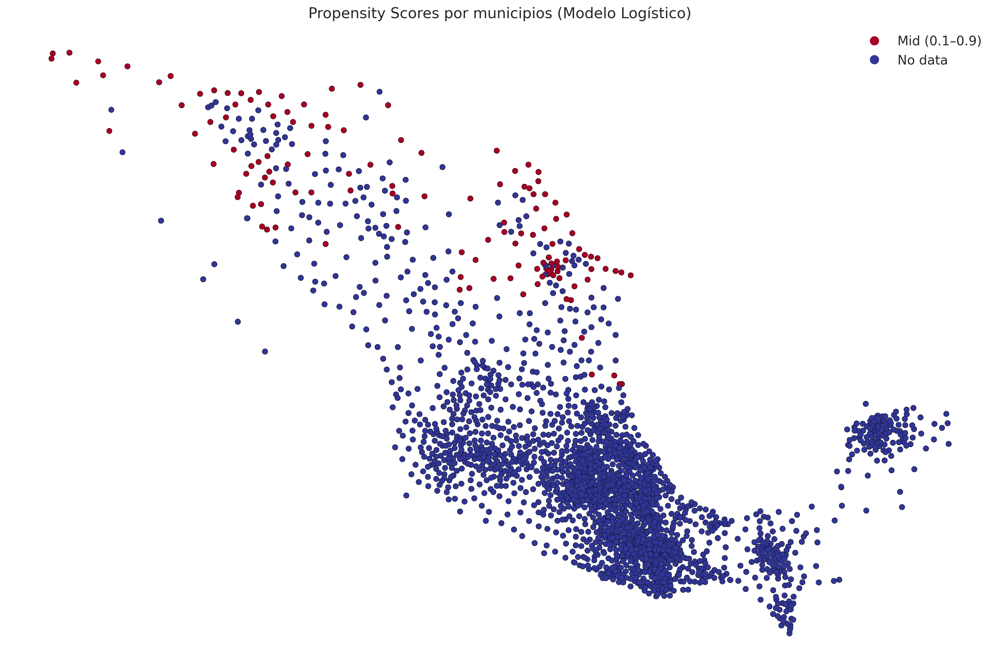

In [123]:
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf.plot(column="ps_group", cmap="RdYlBu", linewidth=0.2, edgecolor="black", legend=True, ax=ax)
ax.set_title("Propensity Scores por municipios (Modelo Logístico)", fontsize=16)
ax.axis("off")
plt.show()

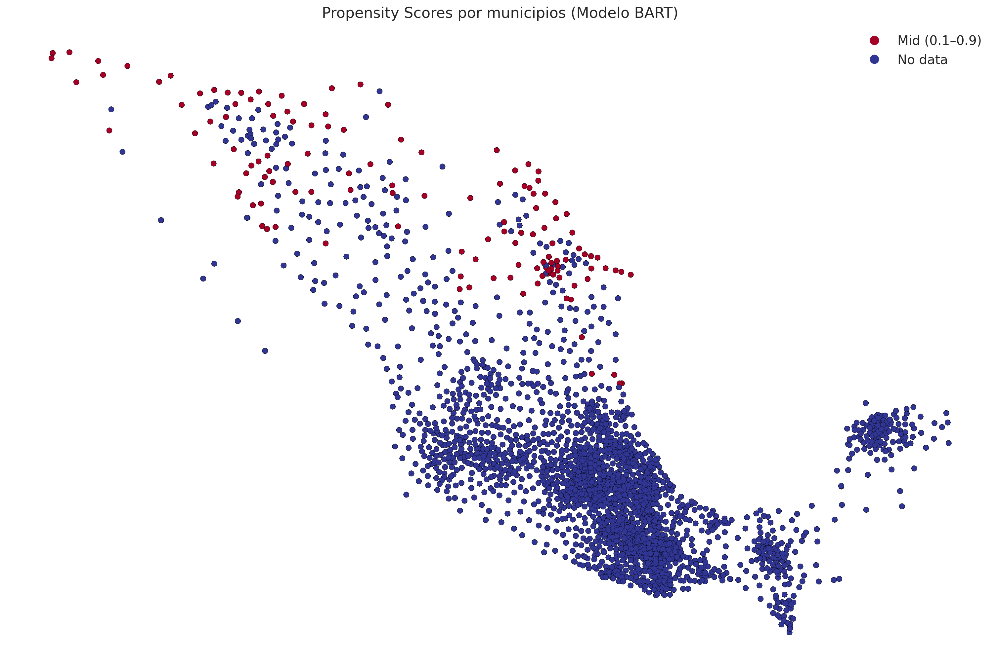

In [124]:
data["LLAVE"] = data["LLAVE"].astype(str).str.zfill(5)
data["ps_bart"] = ps_probit_series
gdf_bart = gdf.merge(data[["LLAVE", "ps_bart"]], on="LLAVE", how="left")

def classify_propensity_bart(p):
    if pd.isnull(p):
        return "No data"
    elif p < 0.1:
        return "Low (<0.1)"
    elif p > 0.9:
        return "High (>0.9)"
    else:
        return "Mid (0.1–0.9)"

gdf_bart["ps_group_bart"] = gdf_bart["ps_bart"].apply(classify_propensity_bart)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_bart.plot(column="ps_group_bart", cmap="RdYlBu", linewidth=0.2, edgecolor="black", legend=True, ax=ax)
ax.set_title("Propensity Scores por municipios (Modelo BART)", fontsize=16)
ax.axis("off")
plt.show()

### Distribución de propensity scores bajo cada modelo

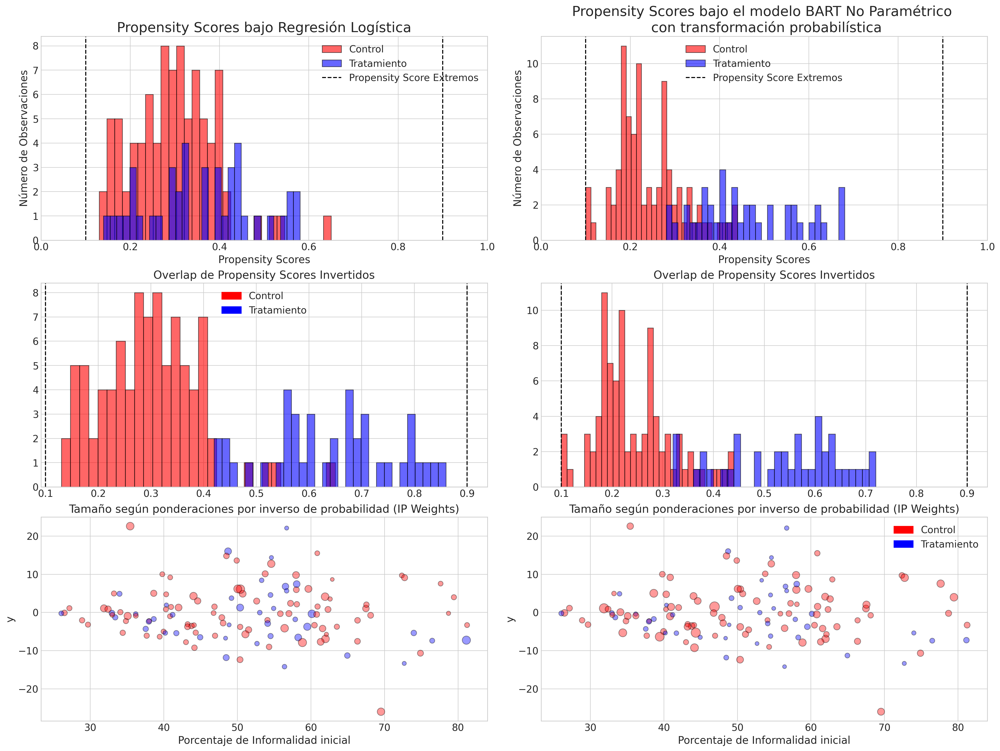

In [125]:
fig, axs = plt.subplots(3, 2, figsize=(20, 15))
axs = axs.flatten()

colors = {1: "blue", 0: "red"}

axs[0].hist(ps_logit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)

axs[0].hist(ps_logit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)

axs[0].set_xlabel("Propensity Scores")
axs[0].set_ylabel("Número de Observaciones")
axs[0].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[0].axvline(0.1, color="black", linestyle="--")
axs[0].set_xlim(0, 1)
axs[0].set_title("Propensity Scores bajo Regresión Logística", fontsize=20)

axs[1].hist(ps_probit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[1].hist(ps_probit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[1].set_xlabel("Propensity Scores")
axs[1].set_ylabel("Número de Observaciones")
axs[1].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[1].axvline(0.1, color="black", linestyle="--")
axs[1].set_xlim(0, 1)
axs[1].set_title("Propensity Scores bajo el modelo BART No Paramétrico \n con transformación probabilística", fontsize=20)

axs[2].hist(ps_logit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[2].hist(1 - ps_logit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[2].set_title("Overlap de Propensity Scores Invertidos")
axs[2].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[2].axvline(0.1, color="black", linestyle="--")

axs[3].hist(ps_probit.values[t == 0], ec="black", color="red", bins=30, label="Control", alpha=0.6)
axs[3].hist(1 - ps_probit.values[t == 1], ec="black", color="blue", bins=30, label="Tratamiento", alpha=0.6)
axs[3].set_title("Overlap de Propensity Scores Invertidos")
axs[3].axvline(0.9, color="black", linestyle="--", label="Propensity Score Extremos")
axs[3].axvline(0.1, color="black", linestyle="--")

axs[4].scatter(
    X["informal"], y,
    color=t.map(colors),
    s=(1 / ps_logit.values) * 20,
    ec="black",
    alpha=0.4
)
axs[4].set_xlabel("Porcentaje de Informalidad inicial")
axs[4].set_ylabel("y")
axs[4].set_title("Tamaño según ponderaciones por inverso de probabilidad (IP Weights)")

# Scatter plot: Same as above but using BART-based propensity scores
axs[5].scatter(
    X["informal"], y,
    color=t.map(colors),
    s=(1 / ps_probit.values) * 20,
    ec="black",
    alpha=0.4
)
axs[5].set_xlabel("Porcentaje de Informalidad inicial")
axs[5].set_ylabel("y")
axs[5].set_title("Tamaño según ponderaciones por inverso de probabilidad (IP Weights)")

red_patch = mpatches.Patch(color="red", label="Control")
blue_patch = mpatches.Patch(color="blue", label="Tratamiento")
axs[0].legend()
axs[1].legend()
axs[2].legend(handles=[red_patch, blue_patch])
axs[5].legend(handles=[red_patch, blue_patch])

### Balance de las covariables a través de las particiones del Propensity Score.

In [126]:
temp = X.copy()  
temp["ps"] = ps_logit.values 
temp["ps_cut"] = pd.qcut(temp["ps"], 5)  

def plot_balance(temp, col, t):
    fig, axs = plt.subplots(1, 5, figsize=(20, 9))
    axs = axs.flatten() 

    for c, ax in zip(np.sort(temp["ps_cut"].unique()), axs):
        std0 = temp[(t == 0) & (temp["ps_cut"] == c)][col].std()
        std1 = temp[(t == 1) & (temp["ps_cut"] == c)][col].std()

        pooled_std = (std0 + std1) / 2

        mean_diff = (
            temp[(t == 0) & (temp["ps_cut"] == c)][col].mean()
            - temp[(t == 1) & (temp["ps_cut"] == c)][col].mean()
        ) / pooled_std

        ax.hist(
            temp[(t == 0) & (temp["ps_cut"] == c)][col],
            alpha=0.6,
            color="red",
            density=True,
            ec="black",
            bins=10,
            cumulative=False,
        )

        ax.hist(
            temp[(t == 1) & (temp["ps_cut"] == c)][col],
            alpha=0.4,
            color="blue",
            density=True,
            ec="black",
            bins=10,
            cumulative=False,
        )

        ax.set_title(f"Prop. Score: {c} \n Dif. Media Estandarizada {np.round(mean_diff, 4)} ")

        ax.set_xlabel(col)

        red_patch = mpatches.Patch(color="red", label="Control")
        blue_patch = mpatches.Patch(color="blue", label="Tratamiento")
        axs[0].legend(handles=[red_patch, blue_patch])

    plt.suptitle(
        f"Función de Densidad de {col} \n por Particiones del Propensity Score",
        fontsize=20,
        fontweight="bold",
    )

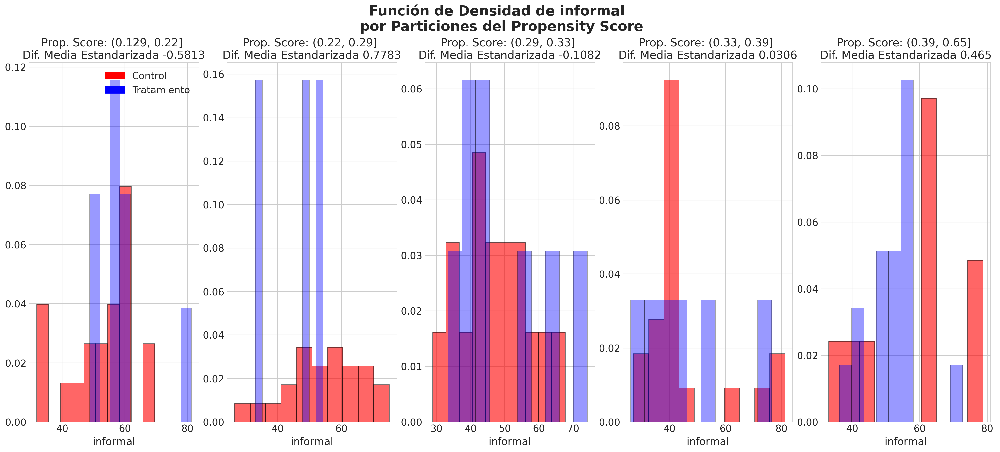

In [127]:
plot_balance(temp, "informal", t)

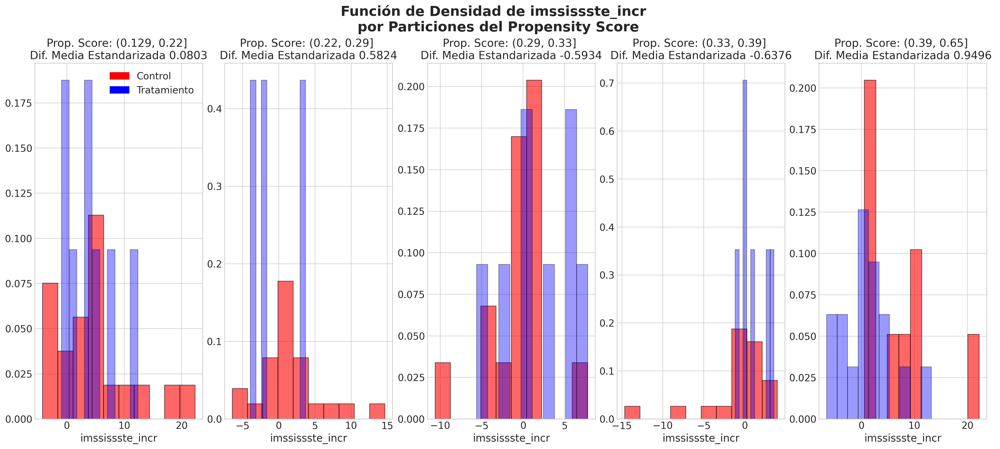

In [128]:
plot_balance(temp, "imssissste_incr", t)

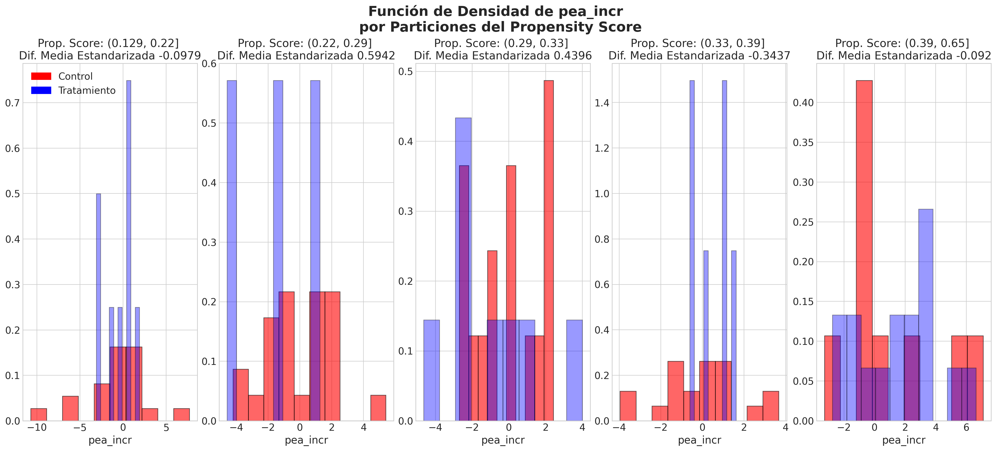

In [129]:
plot_balance(temp, "pea_incr", t)

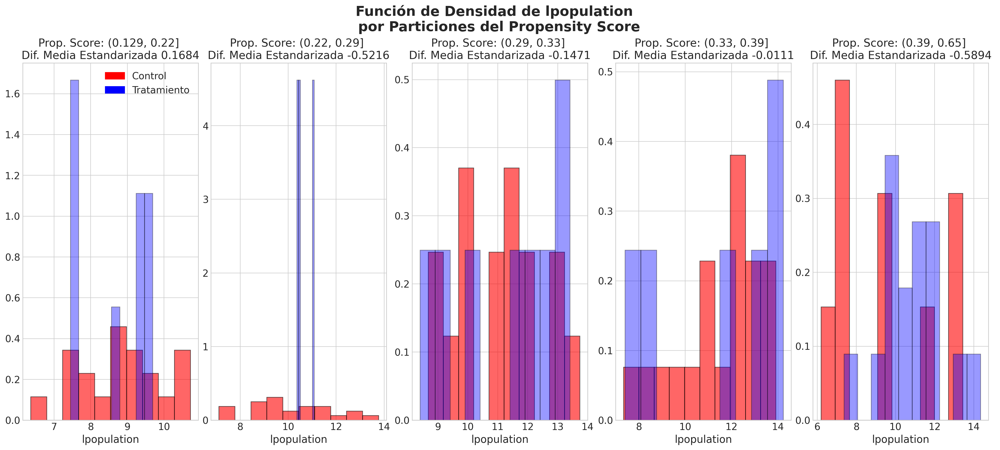

In [130]:
plot_balance(temp, "lpopulation", t)

## Esquemas de ponderación robustos y doble robustos

## Estimaciones de los efectos de tratamiento

In [131]:
def make_robust_adjustments(X, t):
    X["trt"] = t 
    p_of_t = X["trt"].mean()
    X["i_ps"] = np.where(t, (p_of_t / X["ps"]), (1 - p_of_t) / (1 - X["ps"]))
    n_ntrt = X[X["trt"] == 0].shape[0]
    n_trt = X[X["trt"] == 1].shape[0]
    outcome_trt = X[X["trt"] == 1]["outcome"]
    outcome_ntrt = X[X["trt"] == 0]["outcome"]
    i_propensity0 = X[X["trt"] == 0]["i_ps"]
    i_propensity1 = X[X["trt"] == 1]["i_ps"]
    weighted_outcome1 = outcome_trt * i_propensity1
    weighted_outcome0 = outcome_ntrt * i_propensity0
    return weighted_outcome0, weighted_outcome1, n_ntrt, n_trt

def make_raw_adjustments(X, t):
    X["trt"] = t  
    X["ps"] = np.where(X["trt"], X["ps"], 1 - X["ps"])
    X["i_ps"] = 1 / X["ps"]
    n_ntrt = n_trt = len(X)

    outcome_trt = X[X["trt"] == 1]["outcome"]
    outcome_ntrt = X[X["trt"] == 0]["outcome"]
    i_propensity0 = X[X["trt"] == 0]["i_ps"]
    i_propensity1 = X[X["trt"] == 1]["i_ps"]

    weighted_outcome1 = outcome_trt * i_propensity1
    weighted_outcome0 = outcome_ntrt * i_propensity0

    return weighted_outcome0, weighted_outcome1, n_ntrt, n_trt

def make_doubly_robust_adjustment(X, t, y):
    m0 = sm.OLS(y[t == 0], X[t == 0].astype(float)).fit()
    m1 = sm.OLS(y[t == 1], X[t == 1].astype(float)).fit()
    m0_pred = m0.predict(X)
    m1_pred = m1.predict(X)

    X["trt"] = t
    X["y"] = y

    weighted_outcome0 = (1 - X["trt"]) * (X["y"] - m0_pred) / (1 - X["ps"]) + m0_pred
    weighted_outcome1 = X["trt"] * (X["y"] - m1_pred) / X["ps"] + m1_pred

    return weighted_outcome0, weighted_outcome1, None, None

In [132]:
def plot_weights(bins, top0, top1, ylim, ax):
    ax.axhline(0, c="gray", linewidth=1)
    ax.set_ylim(ylim)

    bars0 = ax.bar(bins[:-1] + 0.025, top0, width=0.04, facecolor="red", alpha=0.6)
    bars1 = ax.bar(bins[:-1] + 0.025, -top1, width=0.04, facecolor="blue", alpha=0.6)

    for bars in (bars0, bars1):
        for bar in bars:
            bar.set_edgecolor("black")

    for x, y in zip(bins, top0):
        ax.text(x + 0.025, y + 1, str(y), ha="center", va="bottom")

    for x, y in zip(bins, top1):
        ax.text(x + 0.025, -y - 1, str(y), ha="center", va="top")

def make_plot(
    X,
    idata,
    lower_bins=[np.arange(1, 30, 1), np.arange(1, 30, 1)],
    ylims=[(-10, 35), (-5, 15), (-5, 12)],
    text_pos=(10, 40),
    ps=None,
    method="robust", 
):
    X = X.copy()

    if ps is None:
        n_list = list(range(1000))
        choice = np.random.choice(n_list, 1)[0]
        X["ps"] = idata["posterior"]["p"].stack(z=("chain", "draw"))[:, choice].values
    else:
        X["ps"] = ps  

    X["trt"] = t

    propensity0 = X[X["trt"] == 0]["ps"]
    propensity1 = X[X["trt"] == 1]["ps"]

    if method == "robust":
        X["outcome"] = y
        weighted_outcome0, weighted_outcome1, n_ntrt, n_trt = make_robust_adjustments(X, t)
    elif method == "raw":
        X["outcome"] = y
        weighted_outcome0, weighted_outcome1, n_ntrt, n_trt = make_raw_adjustments(X, t)
    else:
        weighted_outcome0, weighted_outcome1, _, _ = make_doubly_robust_adjustment(X, t, y)

    bins = np.arange(0.025, 0.85, 0.05)
    top0, _ = np.histogram(propensity0, bins=bins)
    top1, _ = np.histogram(propensity1, bins=bins)

    fig, axs = plt.subplots(3, 1, figsize=(20, 20))
    axs = axs.flatten()

    plot_weights(bins, top0, top1, ylims[0], axs[0])
    axs[0].text(0.05, 30, "Control = 0")
    axs[0].text(0.05, 27, "Tratamiento = 1")
    axs[0].set_ylabel("No. Municipios", fontsize=14)
    axs[0].set_xlabel("Propensity Score Estimado", fontsize=14)
    axs[0].set_title(
        "Propensity Scores Inferidos y Resultado Ponderado por IP \n por Grupo de Tratamiento y Control",
        fontsize=20,
    )

    outcome_trt = y[t == 1]
    outcome_ntrt = y[t == 0]
    top0, _ = np.histogram(outcome_ntrt, bins=lower_bins[0])
    top1, _ = np.histogram(outcome_trt, bins=lower_bins[0])
    plot_weights(lower_bins[0], top0, top1, ylims[2], axs[1])
    axs[1].set_ylabel("No. Municipios", fontsize=14)
    axs[1].set_xlabel("Medida Bruta del Efecto", fontsize=14)
    axs[1].text(text_pos[0], text_pos[1] - 32, f"Control: E(Y) = {outcome_ntrt.mean():.2f}")
    axs[1].text(text_pos[0], text_pos[1] - 33, f"Tratamiento: E(Y) = {outcome_trt.mean():.2f}")
    axs[1].text(
        text_pos[0],
        text_pos[1] - 34,
        f"tau: E(Y(1) - Y(0)) = {(outcome_trt.mean()- outcome_ntrt.mean()):.2f}",
        fontweight="bold",
    )

    axs[2].set_ylabel("No. Municipios", fontsize=14)

    if method in ["raw", "robust"]:
        top0, _ = np.histogram(weighted_outcome0, bins=lower_bins[1])
        top1, _ = np.histogram(weighted_outcome1, bins=lower_bins[1])
        plot_weights(lower_bins[1], top0, top1, ylims[1], axs[2])
        axs[2].set_xlabel("Resultado Estimado Ponderado por IP \n Ajustado", fontsize=14)

        E0 = weighted_outcome0.sum() / n_ntrt
        E1 = weighted_outcome1.sum() / n_trt
        axs[2].text(text_pos[0], text_pos[1] - 30, f"Control: E(Y) = {E0:.2f}")
        axs[2].text(text_pos[0], text_pos[1] - 31, f"Tratamiento: E(Y) = {E1:.2f}")
        axs[2].text(
            text_pos[0],
            text_pos[1] - 32,
            f"tau: E(Y(1) - Y(0)) = {(E1 - E0):.2f}",
            fontweight="bold",
        )

    else:
        top0, _ = np.histogram(weighted_outcome0, bins=lower_bins[1])
        top1, _ = np.histogram(weighted_outcome1, bins=lower_bins[1])
        plot_weights(lower_bins[1], top0, top1, ylims[1], axs[2])
        E0 = np.round(np.mean(weighted_outcome0), 5)
        E1 = np.round(np.mean(weighted_outcome1), 5)
        axs[2].set_xlabel("Resultado Estimado Ponderado por IP \n Desplazado", fontsize=14)
        axs[2].text(text_pos[0], text_pos[1] -14, f"Control: E(Y) = {E0}")
        axs[2].text(text_pos[0], text_pos[1] - 15, f"Tratamiento: E(Y) = {E1}")
        axs[2].text(
            text_pos[0],
            text_pos[1] - 16,
            f"tau: E(Y(1) - Y(0)) = {E1 - E0}",
            fontweight="bold",
        )

### El modelo de Propensity Logit

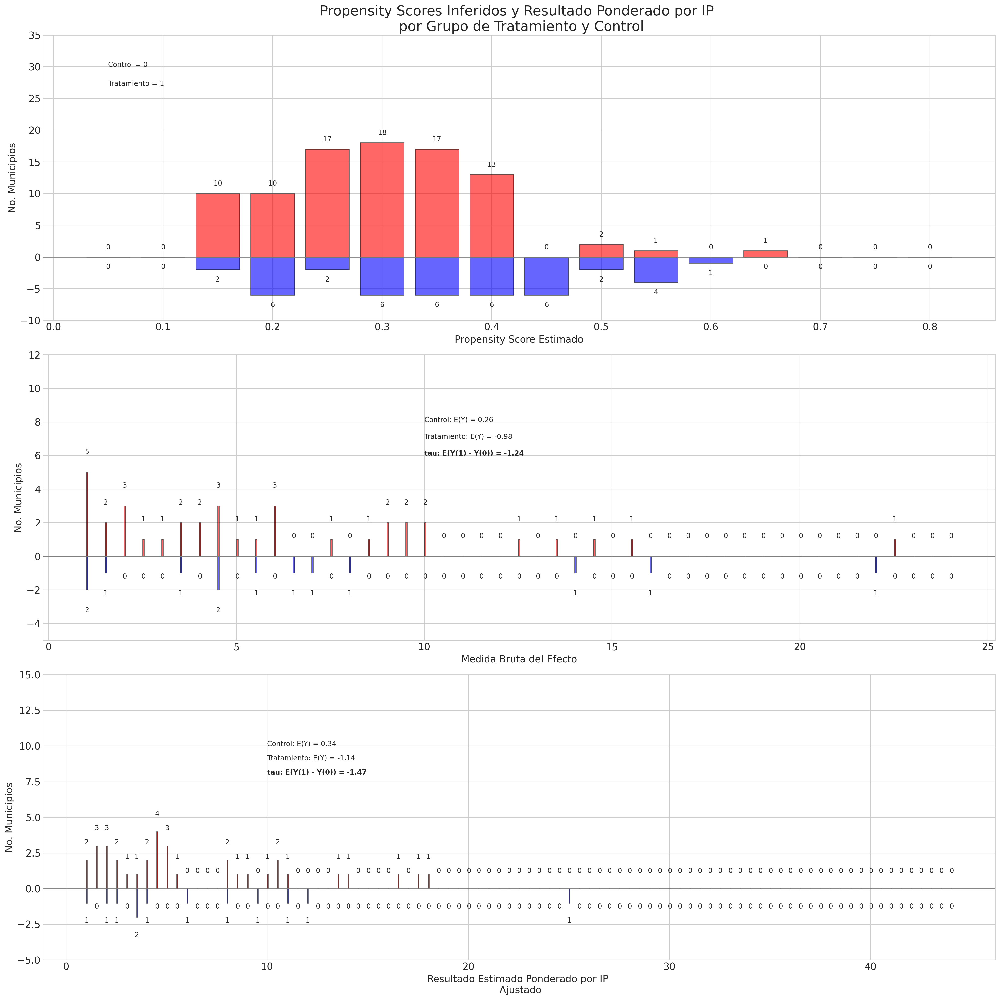

In [133]:
make_plot(
    X,                 
    idata_logit,     
    method="robust",   
    ps=ps_logit,       
    lower_bins=[     
        np.arange(1, 25, 0.5),   
        np.arange(1, 45, 0.5),  
    ]
)

### Estimación de la Distribución Posterior del ATE para el modelo de Propensity Logit


In [134]:
def get_ate(X, t, y, i, idata, method="doubly_robust"):
    X = X.copy()

    X["outcome"] = y
    X["ps"] = idata["posterior"]["p"].stack(z=("chain", "draw"))[:, i].values

    if method == "robust":
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_robust_adjustments(X, t)
        ntrt = weighted_outcome_ntrt.sum() / n_ntrt
        trt = weighted_outcome_trt.sum() / n_trt

    elif method == "raw":
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_raw_adjustments(X, t)
        ntrt = weighted_outcome_ntrt.sum() / n_ntrt
        trt = weighted_outcome_trt.sum() / n_trt

    else:
        X.drop("outcome", axis=1, inplace=True)  
        weighted_outcome_ntrt, weighted_outcome_trt, n_ntrt, n_trt = make_doubly_robust_adjustment(
            X, t, y
        )
        trt = np.mean(weighted_outcome_trt)
        ntrt = np.mean(weighted_outcome_ntrt)

    ate = trt - ntrt

    return [ate, trt, ntrt]

In [135]:
def plot_ate(ate_dist_df, xy=(4.0, 250)):
    fig, axs = plt.subplots(1, 2, figsize=(20, 7))

    axs[0].hist(
        ate_dist_df["E(Y(1))"],          
        bins=30,
        ec="black",                
        color="blue",                  
        label="E(Y(1))",                
        alpha=0.5                        
    )

    axs[0].hist(
        ate_dist_df["E(Y(0))"],         
        bins=30,
        ec="black",
        color="red",
        label="E(Y(0))",
        alpha=0.7
    )

    axs[1].hist(
        ate_dist_df["ATE"],            
        bins=30,
        ec="black",
        color="slateblue",
        label="ATE",
        alpha=0.6
    )

    ate = np.round(ate_dist_df["ATE"].mean(), 2)
    axs[1].axvline(ate, linestyle="--", color="black", label="E(ATE)")

    axs[1].annotate(f"E(ATE): {ate}", xy, fontsize=20, fontweight="bold")

    axs[0].set_title("E(Y) Distribuciones para Tratamiento y Control", fontsize=20)
    axs[0].set_xlabel("Efectos Potenciales Estimados")
    axs[0].legend()

    axs[1].set_title(f"Average Treatment Effect \n E(ATE): {ate}", fontsize=20)
    axs[1].set_xlabel("Efecto de Tratamiento Promedio")
    axs[1].legend()

In [136]:
qs = range(4000)

ate_dist = [get_ate(X, t, y, q, idata_logit, method="robust") for q in qs]
ate_dist_df_logit_r = pd.DataFrame(ate_dist, columns=["ATE", "E(Y(1))", "E(Y(0))"])
ate_dist_df_logit_r.head()

,ATE,E(Y(1)),E(Y(0))
0,1.175722,1.518338,0.342616
1,-2.993237,-1.948996,1.044241
2,0.146986,0.427919,0.280932
3,-6.265203,-5.712422,0.552781
4,-3.543932,-2.717090,0.826842


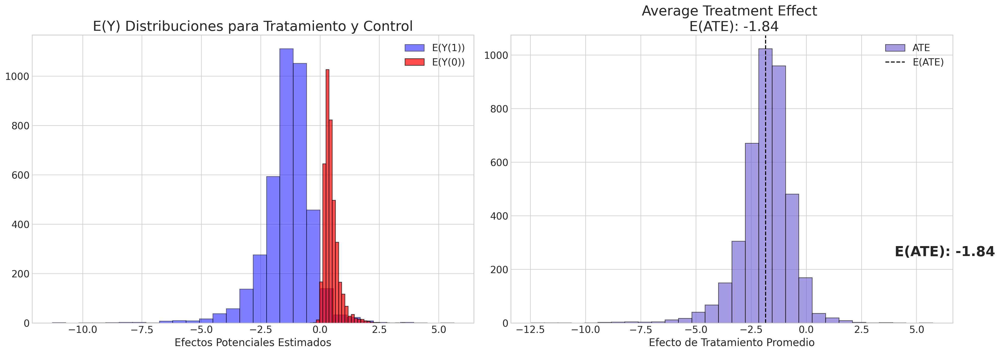

In [137]:
plot_ate(ate_dist_df_logit_r)

In [138]:
ate_dist = [get_ate(X, t, y, q, idata_logit, method="doubly_robust") for q in qs]
ate_dist_df_logit_dr = pd.DataFrame(ate_dist, columns=["ATE", "E(Y(1))", "E(Y(0))"])
ate_dist_df_logit_dr.head()

,ATE,E(Y(1)),E(Y(0))
0,-1.480837,-1.285409,0.195428
1,-2.294319,-1.557307,0.737013
2,-0.389267,-0.331201,0.058066
3,-4.181608,-3.916053,0.265555
4,-2.851373,-2.463139,0.388234


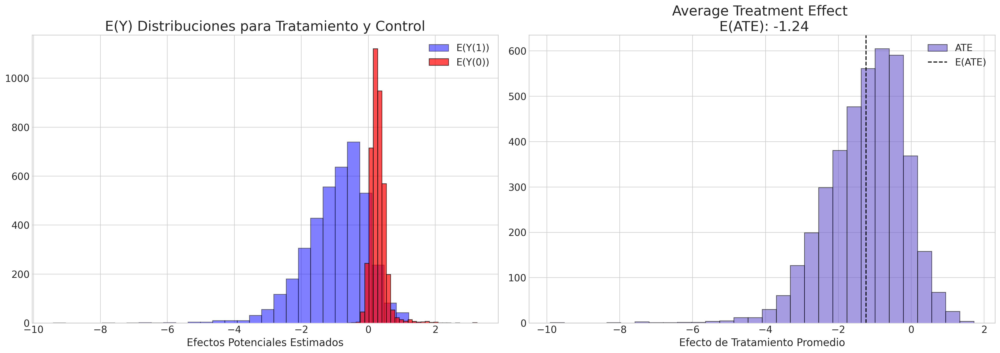

In [139]:
plot_ate(ate_dist_df_logit_dr)

### El modelo de Propensity BART


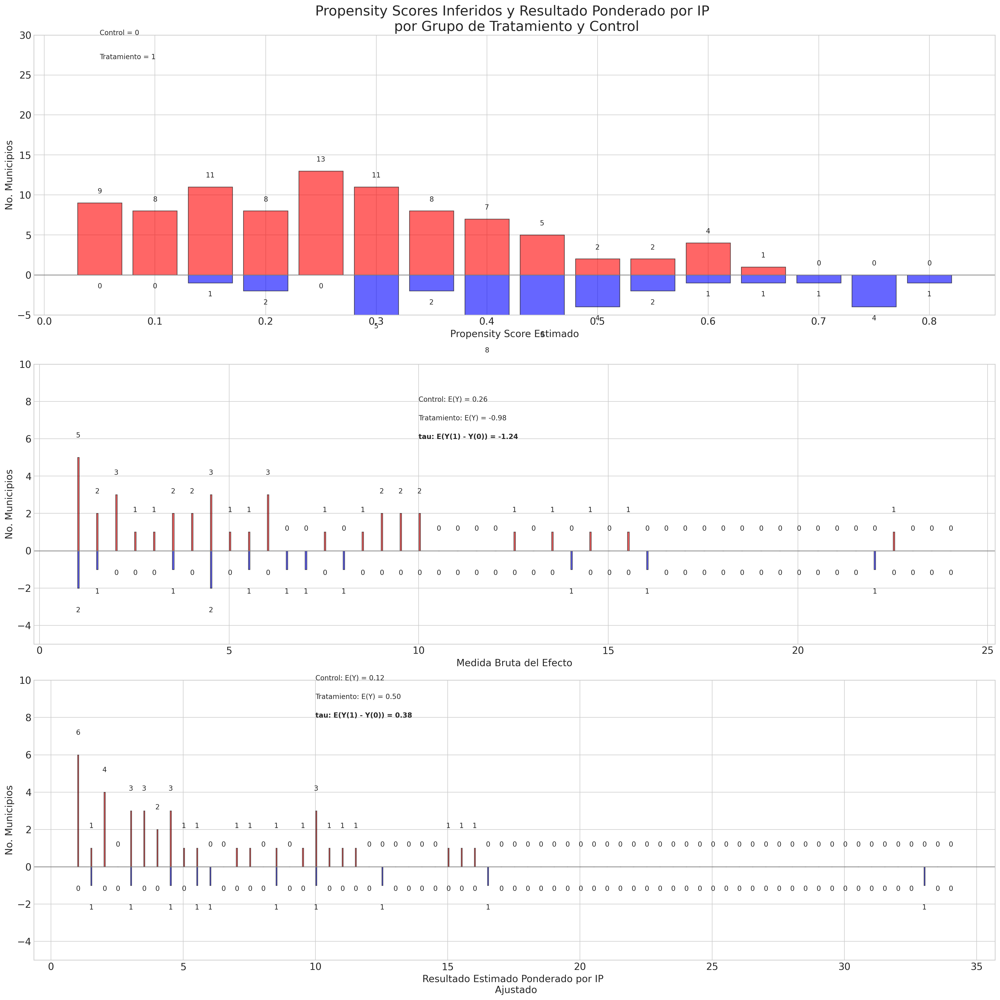

In [140]:
make_plot(
    X,                
    idata_probit,     
    method="robust",     
    ylims=[(-5, 30), (-5, 10), (-5, 10)],
    lower_bins=[
        np.arange(1, 25, 0.5),  
        np.arange(1, 35, 0.5),  
    ]
)

### Estimación de la distribución posterior de la ATE a partir de la reponderación con puntuaciones de propensión basadas en BART

In [141]:
ate_dist_probit_r = [
    get_ate(X, t, y, q, idata_probit, method="robust")  
    for q in qs  
]

ate_dist_df_probit_r = pd.DataFrame(
    ate_dist_probit_r, 
    columns=["ATE", "E(Y(1))", "E(Y(0))"]
)

ate_dist_df_probit_r.head()

,ATE,E(Y(1)),E(Y(0))
0,-0.960279,-0.551539,0.408740
1,-0.860145,-0.387388,0.472757
2,0.300886,0.604412,0.303527
3,-0.918184,-0.469856,0.448328
4,-0.764199,-0.378488,0.385710


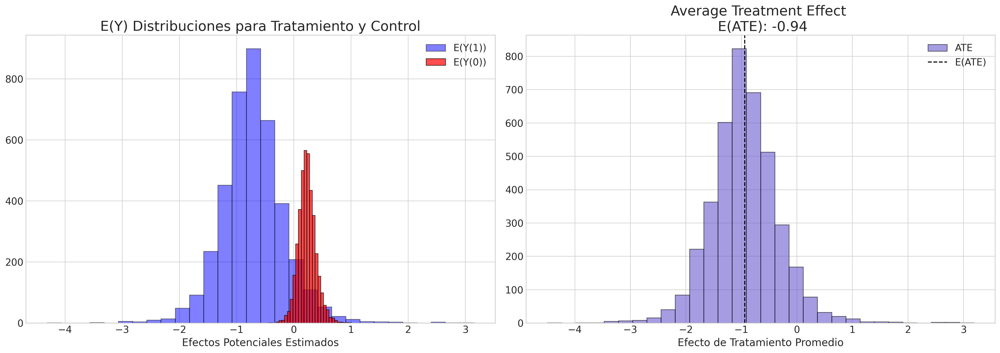

In [142]:
plot_ate(
    ate_dist_df_probit_r,  
    xy=(3.6, 250)         
)

In [143]:
ate_dist_probit_dr = [
    get_ate(X, t, y, q, idata_probit, method="doubly_robust")  
    for q in qs  
]

ate_dist_df_probit_dr = pd.DataFrame(
    ate_dist_probit_dr, 
    columns=["ATE", "E(Y(1))", "E(Y(0))"]
)

ate_dist_df_probit_dr.head()

,ATE,E(Y(1)),E(Y(0))
0,-1.241273,-0.718339,0.522934
1,0.421808,0.876522,0.454714
2,1.171990,1.375946,0.203956
3,1.760010,1.906370,0.146361
4,1.470805,1.502289,0.031484


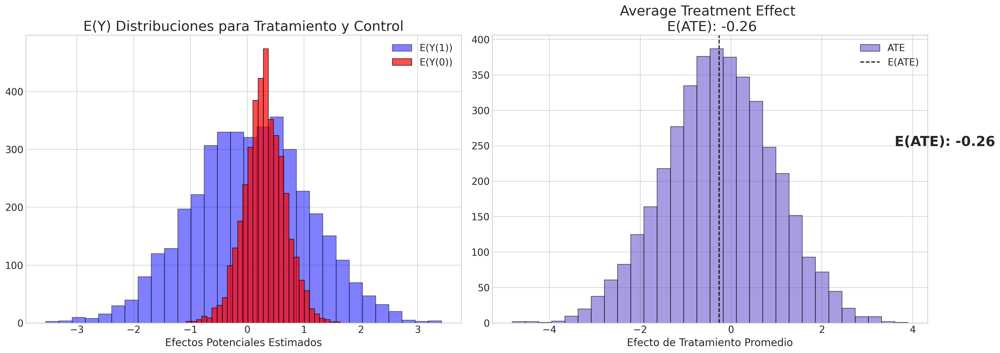

In [144]:
plot_ate(
    ate_dist_df_probit_dr,  
    xy=(3.6, 250)         
)

### Controles predictivos posteriores: efectos heterogéneos

Text(0.5, 0.98, 'Posterior Predictive Checks - Heterogeneous Effects')

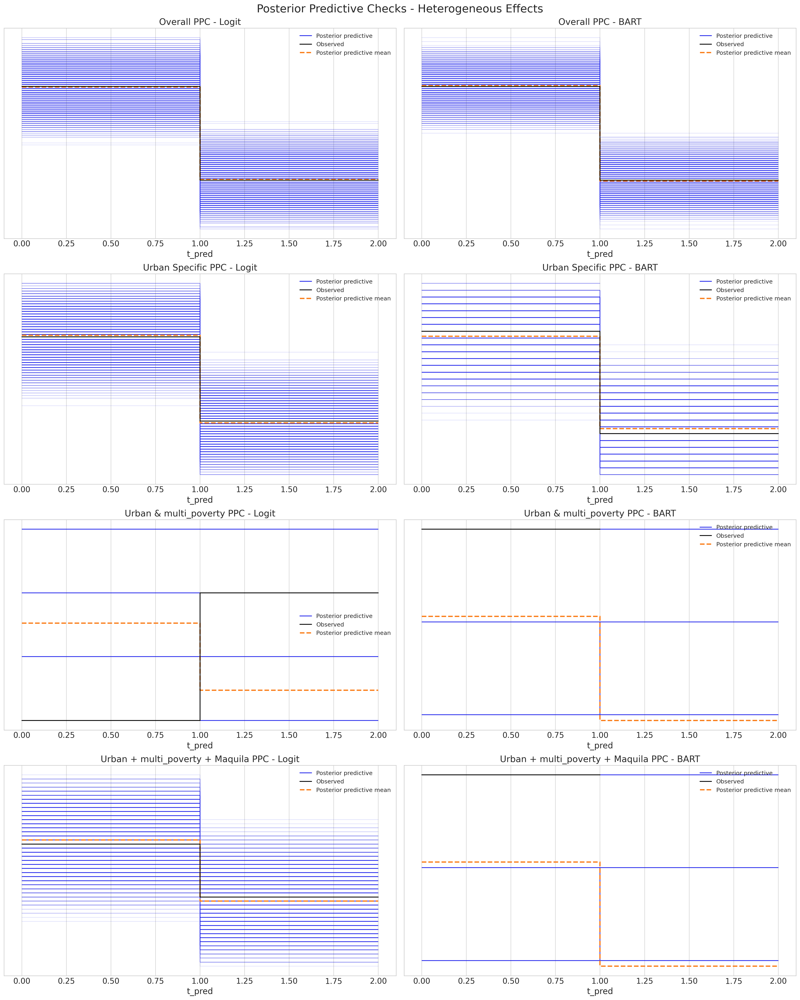

In [145]:
fig, axs = plt.subplots(4, 2, figsize=(20, 25))
axs = axs.flatten()

az.plot_ppc(idata_logit, ax=axs[0])
az.plot_ppc(idata_probit, ax=axs[1])

idx1 = list(X[X["urban"] == 1].index.values)  
idx0 = list(X[X["urban"] == 0].index.values)  

if idx1:
    az.plot_ppc(idata_logit, ax=axs[2], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[3], coords={"obs": idx0})

idx1 = list(X[(X["urban"] == 1) & (X["multi_poverty"] == 1)].index.values)
idx0 = list(X[(X["urban"] == 0) & (X["multi_poverty"] == 1)].index.values)

if idx1:
    az.plot_ppc(idata_logit, ax=axs[4], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[5], coords={"obs": idx0})

# PPC by urban & multi-dimensional poverty & maquila
idx1 = list(X[(X["urban"] == 1) & (X["multi_poverty"] == 0) & (X["maquila"] == 1)].index.values)
idx0 = list(X[(X["urban"] == 0) & (X["multi_poverty"] == 1) & (X["maquila"] == 0)].index.values)

if idx1:
    az.plot_ppc(idata_logit, ax=axs[6], coords={"obs": idx1})
if idx0:
    az.plot_ppc(idata_probit, ax=axs[7], coords={"obs": idx0})

# Set titles for each subplot
axs[0].set_title("Overall PPC - Logit")
axs[1].set_title("Overall PPC - BART")
axs[2].set_title("Urban Specific PPC - Logit")
axs[3].set_title("Urban Specific PPC - BART")
axs[4].set_title("Urban & multi_poverty PPC - Logit")
axs[5].set_title("Urban & multi_poverty PPC - BART")
axs[6].set_title("Urban + multi_poverty + Maquila PPC - Logit")
axs[7].set_title("Urban + multi_poverty + Maquila PPC - BART")

plt.suptitle("Posterior Predictive Checks - Heterogeneous Effects", fontsize=20)

## Otros modelos para inferencia causal de todos los municipios basado en Propensity Score mediante Logit y BART

### Regression

In [146]:
def make_prop_reg_model(X, t, y, idata_ps, covariates=None, samples=1000):
    ### Note the simplification for specifying the mean estimate in the regression
    ### rather than post-processing the whole posterior
    ps = idata_ps["posterior"]["p"].mean(dim=("chain", "draw")).values
    X_temp = pd.DataFrame({"ps": ps, "trt": t, "trt*ps": t * ps})
    if covariates is None:
        X = X_temp
    else:
        X = pd.concat([X_temp, X[covariates]], axis=1)
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model_ps_reg:
        sigma = pm.HalfNormal("sigma", 1)
        b = pm.Normal("b", mu=0, sigma=1, dims="coeffs")
        X = pm.MutableData("X", X)
        mu = pm.math.dot(X, b)
        y_pred = pm.Normal("pred", mu, sigma, observed=y, dims="obs")

        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(samples, idata_kwargs={"log_likelihood": True}))
        idata.extend(pm.sample_posterior_predictive(idata))
    return model_ps_reg, idata

### Propensity Score Logit

In [147]:
model_ps_reg_logit, idata_ps_reg_logit = make_prop_reg_model(X, t, y, idata_logit)

In [148]:
az.summary(idata_ps_reg_logit, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],0.111,0.870,-1.564,1.824,0.011,0.012,5904.0,3534.0,1.0
b[trt],-0.496,0.737,-1.881,0.965,0.010,0.010,5021.0,2998.0,1.0
b[trt*ps],-0.101,0.935,-1.963,1.660,0.013,0.013,5242.0,3605.0,1.0


### Propensity Score BART

In [149]:
model_ps_reg_bart, idata_ps_reg_bart = make_prop_reg_model(X, t, y, idata_probit)

In [150]:
az.summary(idata_ps_reg_bart, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],-0.093,0.890,-1.749,1.740,0.012,0.013,5187.0,3462.0,1.0
b[trt],-0.423,0.761,-1.936,0.995,0.012,0.009,3777.0,2874.0,1.0
b[trt*ps],-0.250,0.954,-2.042,1.628,0.013,0.012,5275.0,3480.0,1.0


Este modelo es claramente demasiado simple. Solo recupera la estimación sesgada debido a la especificación incorrecta del modelo de propensión BART, pero ¿qué sucedería si simplemente usáramos la propensión como otra característica en nuestro perfil de covariables? Permitamos que añada precisión, pero ajustemos el modelo que creemos que refleja la historia causal.

Logit

In [151]:
model_ps_reg_h_logit, idata_ps_reg_h_logit = make_prop_reg_model(
    X,
    t,
    y,
    idata_logit,
    covariates=["informal","imssissste_incr","pea_incr"]
)

In [152]:
az.summary(idata_ps_reg_h_logit, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],0.175,0.974,-1.716,2.036,0.014,0.015,5029.0,3103.0,1.0
b[trt],-0.493,0.776,-2.012,0.980,0.011,0.010,5133.0,3328.0,1.0
b[trt*ps],-0.059,0.940,-1.898,1.706,0.013,0.014,5255.0,3331.0,1.0
b[informal],0.004,0.013,-0.022,0.029,0.000,0.000,4444.0,2826.0,1.0
b[imssissste_incr],-0.152,0.108,-0.348,0.073,0.002,0.001,4891.0,2970.0,1.0
b[pea_incr],-0.084,0.207,-0.489,0.305,0.003,0.003,5568.0,3233.0,1.0


BART

In [153]:
model_ps_reg_h_bart, idata_ps_reg_h_bart = make_prop_reg_model(
    X,
    t,
    y,
    idata_probit,
    covariates=["informal","imssissste_incr","pea_incr"]
)

In [154]:
az.summary(idata_ps_reg_h_bart, var_names=["b"], hdi_prob=0.95)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
b[ps],-0.088,0.981,-2.065,1.770,0.014,0.014,4728.0,3667.0,1.0
b[trt],-0.417,0.783,-1.932,1.139,0.011,0.010,5178.0,3364.0,1.0
b[trt*ps],-0.235,0.949,-2.126,1.607,0.014,0.014,4531.0,2985.0,1.0
b[informal],0.005,0.013,-0.020,0.032,0.000,0.000,4273.0,3243.0,1.0
b[imssissste_incr],-0.153,0.108,-0.364,0.058,0.002,0.001,4854.0,3151.0,1.0
b[pea_incr],-0.087,0.206,-0.497,0.324,0.003,0.003,5489.0,3159.0,1.0


### Inferencia causal como regresión con imputación del efecto potencial

In [155]:
X_mod = X.copy()
X_mod["ps"] = ps = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 1
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_logit:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_trt = pm.sample_posterior_predictive(idata_ps_reg_logit)  

idata_trt

X_mod = X.copy()
X_mod["ps"] = ps = idata_logit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 0
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_logit:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_ntrt = pm.sample_posterior_predictive(idata_ps_reg_logit) 

idata_ntrt

idata_trt["posterior_predictive"]["pred"].mean()
idata_ntrt["posterior_predictive"]["pred"].mean()
idata_trt["posterior_predictive"]["pred"].mean() - idata_ntrt["posterior_predictive"]["pred"].mean()

<xarray.DataArray 'pred' ()>
array(-0.50209852)

In [156]:
X_mod = X.copy()
X_mod["ps"] = ps = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 1
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_bart:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_trt = pm.sample_posterior_predictive(idata_ps_reg_bart)  

idata_trt

X_mod = X.copy()
X_mod["ps"] = ps = idata_probit["posterior"]["p"].mean(dim=("chain", "draw")).values
X_mod["trt"] = 0
X_mod["trt*ps"] = X_mod["ps"] * X_mod["trt"]

with model_ps_reg_bart:
    pm.set_data({"X": X_mod[["ps", "trt", "trt*ps"]]})  
    idata_ntrt = pm.sample_posterior_predictive(idata_ps_reg_bart) 

idata_ntrt

idata_trt["posterior_predictive"]["pred"].mean()
idata_ntrt["posterior_predictive"]["pred"].mean()
idata_trt["posterior_predictive"]["pred"].mean() - idata_ntrt["posterior_predictive"]["pred"].mean()

<xarray.DataArray 'pred' ()>
array(-0.48628907)

## Aplicando aprendizaje automático (Double/Debiased Machine Learning) y Frisch-Waugh-Lovell

### Evitando sobreajuste con K-fold Cross Validation

In [157]:
dummies = pd.concat(
    [
        pd.get_dummies(dat["state"], drop_first=True, prefix="state"),
    ],
    axis=1,
) 
train_dfs = []
temp = pd.concat([dat[["maquila","multi_poverty","urban","informal", "imssissste","health","lpopulation","imssissste_incr", "pea_incr"]], 
                  dummies["state_19"]], axis=1)

for i in range(4):
    idx = temp.sample(30, random_state=10).index
    X = temp.iloc[idx].copy()
    t = dat.iloc[idx]["trt"]
    y = dat.iloc[idx]["outcome"]
    train_dfs.append([X, t, y])
    remaining = [True if not i in idx else False for i in temp.index]
    temp = temp[remaining]
    temp.reset_index(inplace=True, drop=True)

### Aplicación del método sin sesgo


In [158]:
def train_outcome_model(X, y, m=50):
    coords = {"coeffs": list(X.columns), "obs": range(len(X))}
    with pm.Model(coords=coords) as model:
        X_data = pm.MutableData("X", X)
        y_data = pm.MutableData("y_data", y)
        mu = pmb.BART("mu", X_data, y, m=m)
        sigma = pm.HalfNormal("sigma", 1)
        obs = pm.Normal("obs", mu, sigma, observed=y_data)
        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(1000, progressbar=False))
    return model, idata


def train_propensity_model(X, t, m=50):
    coords = {"coeffs": list(X.columns), "obs_id": range(len(X))}
    with pm.Model(coords=coords) as model_ps:
        X_data = pm.MutableData("X", X)
        t_data = pm.MutableData("t_data", t)
        mu = pmb.BART("mu", X_data, t, m=m)
        p = pm.Deterministic("p", pm.math.invlogit(mu))
        t_pred = pm.Bernoulli("obs", p=p, observed=t_data)
        idata = pm.sample_prior_predictive()
        idata.extend(pm.sample(1000, progressbar=False))
    return model_ps, idata


def cross_validate(train_dfs, test_idx):
    test = train_dfs[test_idx]
    test_X = test[0]
    test_t = test[1]
    test_y = test[2]
    train_X = pd.concat([train_dfs[i][0] for i in range(4) if i != test_idx])
    train_t = pd.concat([train_dfs[i][1] for i in range(4) if i != test_idx])
    train_y = pd.concat([train_dfs[i][2] for i in range(4) if i != test_idx])

    model, idata = train_outcome_model(train_X, train_y)
    with model:
        pm.set_data({"X": test_X, "y_data": test_y})
        idata_pred = pm.sample_posterior_predictive(idata)
    y_resid = idata_pred["posterior_predictive"]["obs"].stack(z=("chain", "draw")).T - test_y.values

    model_t, idata_t = train_propensity_model(train_X, train_t)
    with model_t:
        pm.set_data({"X": test_X, "t_data": test_t})
        idata_pred_t = pm.sample_posterior_predictive(idata_t)
    t_resid = (
        idata_pred_t["posterior_predictive"]["obs"].stack(z=("chain", "draw")).T - test_t.values
    )

    return y_resid, t_resid, idata_pred, idata_pred_t


y_resids = []
t_resids = []
model_fits = {}
for i in range(4):
    y_resid, t_resid, idata_pred, idata_pred_t = cross_validate(train_dfs, i)
    y_resids.append(y_resid)
    t_resids.append(t_resid)
    t_effects = []
    for j in range(1000):
        intercept = np.ones_like(1000)
        covariates = pd.DataFrame({"intercept": intercept, "t_resid": t_resid[j, :].values})
        m0 = sm.OLS(y_resid[j, :].values, covariates).fit()
        t_effects.append(m0.params["t_resid"])
    model_fits[i] = [m0, t_effects]
    print(f"Estimated Treatment Effect in K-fold {i}: {np.mean(t_effects)}")

The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Estimated Treatment Effect in K-fold 0: -0.9516761198761605


The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Estimated Treatment Effect in K-fold 1: 0.15543047885940123


Estimated Treatment Effect in K-fold 2: -1.20238083873032


The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Estimated Treatment Effect in K-fold 3: 1.3357282963031223


In [159]:
y_resids_stacked = xr.concat(y_resids, dim=("obs_dim_2"))
t_resids_stacked = xr.concat(t_resids, dim=("obs_dim_2"))

y_resids_stacked

<xarray.DataArray 'obs' (z: 4000, obs_dim_2: 120)>
array([[-13.08224498,  -0.14856611,  -7.67003809, ...,   4.19444534,
         19.16781425,  -4.22844209],
       [ -3.99589369,   2.06642839,  -2.90464807, ...,  -2.22840577,
          5.17901657,  -5.38529995],
       [ -8.69325276,  -3.33779762,  -2.8533113 , ...,   5.24245355,
         14.75393944,  -9.69559089],
       ...,
       [  3.66188793, -12.68148525,   2.52084765, ...,   4.45306794,
         10.88683139,  -2.21117253],
       [-11.57080887,   0.85236757,  -7.10575004, ...,   8.16504264,
          6.37510208, -11.99931871],
       [ -7.40992758,   7.93470128, -14.20350558, ..., -10.2405014 ,
          7.59854992,  -2.95411609]])
Coordinates:
  * obs_dim_2  (obs_dim_2) int32 0 1 2 3 4 5 6 7 8 ... 22 23 24 25 26 27 28 29
  * z          (z) object MultiIndex
  * chain      (z) int64 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 3 3 3 3 3 3 3 3 3 3 3 3 3
  * draw       (z) int64 0 1 2 3 4 5 6 7 8 ... 992 993 994 995 996 997 998 999

In [160]:
t_effects = []
intercepts = []
for i in range(4000):
    intercept = np.ones_like(4000)
    covariates = pd.DataFrame({"intercept": intercept, "t_resid": t_resids_stacked[i, :].values})
    m0 = sm.OLS(y_resids_stacked[i, :].values, covariates).fit()
    t_effects.append(m0.params["t_resid"])
    intercepts.append(m0.params["intercept"])

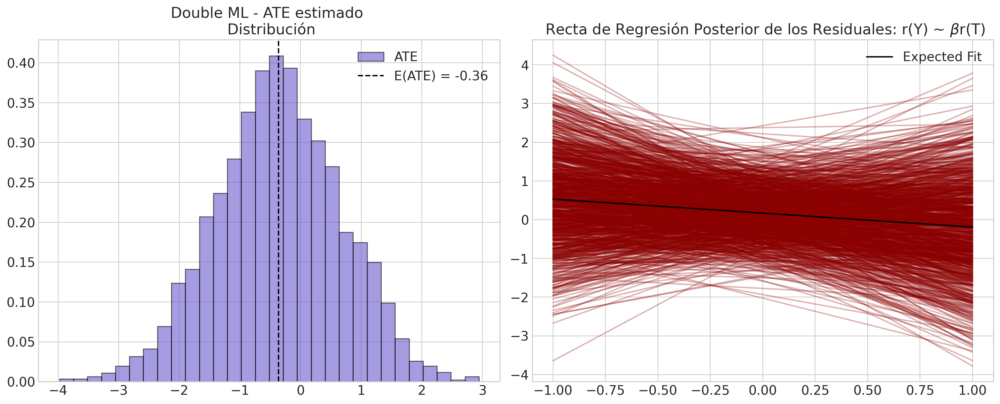

In [161]:
fig, axs = plt.subplots(1, 2, figsize=(15, 6))
axs = axs.flatten()
axs[0].hist(t_effects, bins=30, ec="black", color="slateblue", label="ATE", density=True, alpha=0.6)
x = np.linspace(-1, 1, 10)
for i in range(1000):
    axs[1].plot(x, intercepts[i] + t_effects[i] * x, color="darkred", alpha=0.3)

axs[0].set_title("Double ML - ATE estimado \n Distribución")
axs[1].set_title(r" Recta de Regresión Posterior de los Residuales: r(Y) ~ $\beta$r(T)")
ate = np.mean(t_effects)
axs[0].axvline(ate, color="black", linestyle="--", label=f"E(ATE) = {np.round(ate, 2)}")
axs[1].plot(x, np.mean(intercepts) + np.mean(t_effects) * x, color="black", label="Expected Fit")
axs[1].legend()
axs[0].legend();

### Efecto de Tratamiento Condicional Promedio (CATE)

In [162]:
def make_cate(y_resids_stacked, t_resids_stacked, train_dfs, i, method="forest"):
    train_X = pd.concat([train_dfs[i][0] for i in range(4)])
    train_t = pd.concat([train_dfs[i][1] for i in range(4)])

    df_cate = pd.DataFrame(
        {"y_r": y_resids_stacked[i, :].values, "t_r": t_resids_stacked[i, :].values}
    )
    df_cate["target"] = df_cate["y_r"] / np.where(
        df_cate["t_r"] == 0, df_cate["t_r"] + 1e-25, df_cate["t_r"]
    )
    df_cate["weight"] = df_cate["t_r"] ** 2
    train_X.reset_index(drop=True, inplace=True)
    train_t.reset_index(drop=True, inplace=True)
    if method == "forest":
        CATE_model = RandomForestRegressor()
        CATE_model.fit(train_X, df_cate["target"], sample_weight=df_cate["weight"])
    elif method == "gradient":
        CATE_model = GradientBoostingRegressor()
        CATE_model.fit(train_X, df_cate["target"], sample_weight=df_cate["weight"])
    else:
        CATE_model = sm.WLS(df_cate["target"], train_X, weights=df_cate["weight"])
        CATE_model = CATE_model.fit()
    df_cate["CATE"] = CATE_model.predict(train_X)
    df_cate["t"] = train_t
    return df_cate

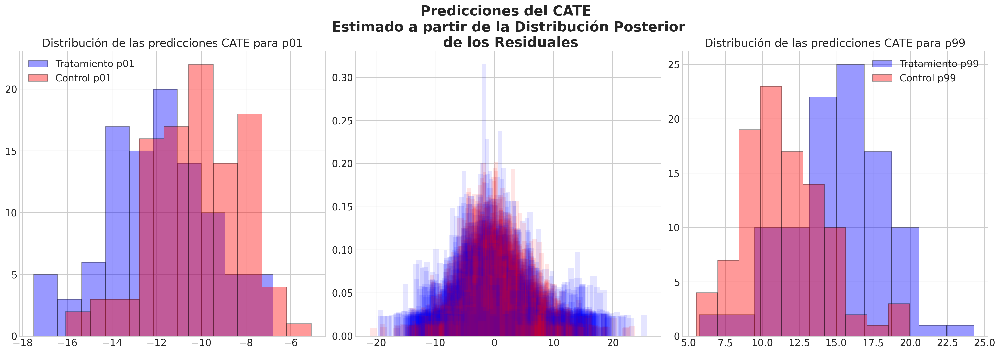

In [163]:
fig, axs = plt.subplots(1, 3, figsize=(20, 7))
axs = axs.flatten()

q_95 = []
for i in range(100):
    cate_df = make_cate(y_resids_stacked, t_resids_stacked, train_dfs, i)
    axs[1].hist(
        cate_df[cate_df["t"] == 0]["CATE"],
        bins=30,
        alpha=0.1,
        color="red",
        density=True,
    )
    q_95.append(
        [
            cate_df[cate_df["t"] == 0]["CATE"].quantile(0.99),
            cate_df[cate_df["t"] == 1]["CATE"].quantile(0.99),
            cate_df[cate_df["t"] == 0]["CATE"].quantile(0.01),
            cate_df[cate_df["t"] == 1]["CATE"].quantile(0.01),
        ]
    )
    axs[1].hist(cate_df[cate_df["t"] == 1]["CATE"], bins=30, alpha=0.1, color="blue", density=True)
axs[1].set_title(
    "Predicciones del CATE \n Estimado a partir de la Distribución Posterior \n de los Residuales", fontsize=20, fontweight="bold"
)

q_df = pd.DataFrame(q_95, columns=["Control_p99", "Treated_p99", "Control_p01", "Treated_p01"])
axs[2].hist(q_df["Treated_p99"], ec="black", color="blue", alpha=0.4, label="Tratamiento p99")
axs[2].hist(q_df["Control_p99"], ec="black", color="red", alpha=0.4, label="Control p99")
axs[2].legend()
axs[2].set_title("Distribución de las predicciones CATE para p99")
axs[0].hist(q_df["Treated_p01"], ec="black", color="blue", alpha=0.4, label="Tratamiento p01")
axs[0].hist(q_df["Control_p01"], ec="black", color="red", alpha=0.4, label="Control p01")
axs[0].legend()
axs[0].set_title("Distribución de las predicciones CATE para p01");

## Referencias

Nathaniel Forde . "Bayesian Non-parametric Causal Inference". In: PyMC Examples. Ed. by PyMC Team. DOI: 10.5281/zenodo.5654871

Peter Aronow and Benjamin Miller. Foundations of Agnostic Statistics. Cambridge University Press, 2019.

MA Hernán and JM Robins. Causal Inference: What If. Chapman & Hall/CRC, 2020.

Michael Daniels, Antonio Linero, and Roy Jason. Bayesian Nonparametrics for Causal Inference and Missing Data. CRC Press, 2024.

Joshua Angrist and Jörn-Steffen Pischke. Mostly Harmless Econometrics. Princeton University Press, 2008.

Matheus Facure. Causal Inference in Python. O'Reilly, 2023.

Chernozhukov Victor, Chetverikov Denis, Demirer Mert, Duflo Esther, Hansen Christian, Newey Whitney, and Robins James. Double/debiased machine learning for treatment and structural parameters. The Econometrics Journal, 21(1):1 – 68, 2018. doi:https://doi.org/10.1111/ectj.12097.

## Especificaciones

Última actualización: Agosto de 2025

Python implementation: CPython

Python version       : 3.9.16

IPython version      : 8.12.0

pytensor: 2.11.1

networkx   : 3.2.1

matplotlib : 3.9.2

statsmodels: 0.13.5

pymc       : 5.3.0

pytensor   : 2.11.1

arviz      : 0.17.0

pandas     : 1.5.3

pymc_bart  : 0.5.7

xarray     : 2024.1.1

numpy      : 1.24.4